# Flux Calculation

In [1]:
# FUNDMENTAL SETTING
# INTERNAL MODULES
from time import time
import multiprocessing as mp
from multiprocessing import Pool, Process, Queue, Manager

# NUMPY, MATPLOTLIB, SCIPY MODULES
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
from matplotlib import colors
import scipy.special as special
from scipy.special import expn
from scipy.special import wofz
from scipy import integrate, interpolate

# ADDINTIONAL MODULES
import corner
from fisspy.read import FISS

# LOCAL MODULES
#import sub4
#from sub4 import fissDB

# CONFIGURATION
%config InlineBackend.figure_format='retina'
#%matplotlib inline

plt.rcParams['font.size'] = 15
plt.rc('legend', fontsize=12)
plt.rcParams['font.family'] = 'sans'
plt.rcParams['mathtext.fontset'] = 'dejavuserif'
#plt.rcParams['text.usetex'] = True

plt.rcParams['axes.linewidth']=2
plt.rcParams['xtick.direction'] = 'in'
plt.rcParams['ytick.direction'] = 'in'
plt.rcParams['xtick.minor.visible']=True
plt.rcParams['ytick.minor.visible']=True
plt.rcParams['xtick.major.size'] = 7
plt.rcParams['ytick.major.size'] = 7
plt.rcParams['xtick.minor.size'] = 3.5
plt.rcParams['ytick.minor.size'] = 3.5
plt.rcParams['xtick.major.width'] = 1.5
plt.rcParams['ytick.major.width'] = 1.5
plt.rcParams['xtick.minor.width'] = 1
plt.rcParams['ytick.minor.width'] = 1
plt.rcParams['ytick.right'] = True
plt.rcParams['xtick.top'] = True

In [12]:
# only for jupyter notebook
from IPython.core.display import display, HTML
display(HTML("<style>.container {width:95% !important;}</style>"))

In [2]:
from bokeh.plotting import figure, show

# prepare some data
x = [1, 2, 3, 4, 5]
y = [6, 7, 2, 4, 5]

# create a new plot with a title and axis labels
p = figure(title="Simple line example", x_axis_label="x", y_axis_label="y")

# add a line renderer with legend and line thickness
p.line(x, y, legend_label="Temp.", line_width=2)

# show the results
show(p)

# Basic Formulae (based on Chae et al. 2021 in prep.)
---
According to the radiative transfer equation, the radiative flux near the solar chromospheric line (eg. Ha, Ca II 8542) is wirtten as an integration of source function,
$$
F_R(t_0) = \int F_\lambda(\tau_\lambda(t_0))d\lambda = 2\pi\int_{\lambda_0-\Delta\lambda/2}^{\lambda_0+\Delta\lambda/2} d\lambda \int_0^\infty S(t_\lambda)E_2(|t_\lambda-\tau_\lambda|)sgn(t_\lambda-\tau_\lambda)dt_\lambda.
$$

## Source function, Doppler velocity, and Doppler width
$$
\begin{align}
\text{upper chromsphere:}\quad S(x;1) &= S_0 + \frac{-S_2+4S_1-3S_0}{2}x + \frac{S_2-2S_1+S_0}{2}x^2, x\in[0,1]\\
\text{lower chromsphere:}\quad S(x;2) &= S_1 + \frac{S_2-S_0}{2}x + \frac{S_2-2S_1+S_0}{2}x^2, x\in[0,1] \\
\text{photosphere:}\quad S(x;3) &= S_2 + (S_p-S_2)x, x\in[0,\infty), \\
\\
v(x;1) &= v_0 + (v_1-v_0)x, \\
v(x;2) &= v_1 + (v_2-v_1)x, \\
v(x;3) &= v_p = v_2 \\
\\
w(x;1) &= w_0 + (w_1-w_0)x, \\
w(x;2) &= w_1 + (w_2-w_1)x, \\
w(x;3) &= w_p = w_2
\end{align}
$$

## Line profiles
$$\begin{align}
\text{upper chromsphere:}\quad r_{\lambda,1} &= H\bigg(u_{\lambda,1}=\frac{\lambda-(1+v(x;1)/c)\lambda_0}{w(x;1)},a_1=0\bigg)\bigg/H\bigg(u_{\lambda,1}=0,a_1=0\bigg) \\
\text{lower chromsphere:}\quad r_{\lambda,2} &= H\bigg(u_{\lambda,2}=\frac{\lambda-(1+v(x;2)/c)\lambda_0}{w(x;2)},a_2=\frac{\gamma x}{w(x;2)}\bigg)\bigg/H\bigg(u_{\lambda,2}=0,a_2=\frac{\gamma x}{w(x;2)}\bigg) \\
\text{photosphere:}\quad r_{\lambda,p} &= 1 + \eta H\bigg(u_{\lambda,p}=\frac{\lambda-(1+v(x;3)/c)\lambda_0}{w(x;3)},a_p\bigg)\bigg/H\bigg(u_{\lambda,p}=0,a_p\bigg) \equiv \tau_{\lambda,p}
\end{align}
$$
where the Voigt profile $H$ is defined by the real part of Faddeeva function $w(z)$,
$$
H(u,a) = H(\frac{x}{\sqrt{2}\sigma},\frac{\gamma}{\sqrt{2}\sigma}) = \sqrt{2\pi}\sigma V(x;\sigma,\gamma) = \mathfrak{R}[w(z)] = \mathfrak{R}[w(u+ia)]
$$

## Optical depth
$$\begin{align}
\text{upper chromsphere:}\quad \tau_{\lambda,1}(x) &= \int_0^x \tau_1 r_{\lambda,1}dx' \\
&\simeq \frac{\tau_1x}{2}\bigg[\frac{5}{9}r_{\lambda,1}\bigg(\frac{x'}{x}=\frac{1-\sqrt{3/5}}{2}\bigg) + \frac{8}{9}r_{\lambda,1}\bigg(\frac{x'}{x}=\frac{1}{2}\bigg) + \frac{5}{9}r_{\lambda,1}\bigg(\frac{x'}{x}=\frac{1+\sqrt{3/5}}{2}\bigg) \bigg] \\
\text{lower chromsphere:}\quad \tau_{\lambda,2}(x) &= \int_0^x \tau_2 r_{\lambda,2}dx' \\
&\simeq \frac{\tau_2x}{2}\bigg[\frac{5}{9}r_{\lambda,2}\bigg(\frac{x'}{x}=\frac{1-\sqrt{3/5}}{2}\bigg) + \frac{8}{9}r_{\lambda,1}\bigg(\frac{x'}{x}=\frac{1}{2}\bigg) + \frac{5}{9}r_{\lambda,1}\bigg(\frac{x'}{x}=\frac{1+\sqrt{3/5}}{2}\bigg) \bigg] \\
\text{photosphere:}\quad \tau_{\lambda,p}(x) &= \int_0^{x} r_{\lambda, p}dx' = \tau_{\lambda,p}x
\end{align}
$$

## Radiative Flux
Then radiative energy flux can be calculated. (+sign means upward energy flux)
$$
F_{R,i} = \sum_j F_{R,i,j} \quad\text{for}\;  i = 0,1,2
$$
where
$$\begin{align}
F_{R,0,0} &= 2\pi\int d\lambda \int_0^1 S(x;1)E_2[\tau_{\lambda,1}(x)] \tau_1r_{\lambda,1}(x)dx, &F_{R,0,0} &= 2\pi\int d\lambda \int_0^1 S(x;1)E_2[\tau_{\lambda,1}(x)] \tau_1r_{\lambda,1}(x)dx,\\
F_{R,0,1} &= 2\pi\int d\lambda \int_0^1 S(x;2)E_2[\tau_{\lambda,1}+\tau_{\lambda,2}(x)] \tau_2r_{\lambda,2}(x)dx, &F_{R,1,0} &= -2\pi\int d\lambda \int_0^1 S(x;1)E_2[\tau_{\lambda,1}-\tau_{\lambda,1}(x)] \tau_1r_{\lambda,1}(x)dx,\\
F_{R,0,2} &= 2\pi\int d\lambda \int_0^\infty S(x;3)E_2[\tau_{\lambda,1}+\tau_{\lambda,2}+\tau_{\lambda,p}x] r_{\lambda,p}dx, &F_{R,2,0} &= -2\pi\int d\lambda \int_0^1 S(x;1)E_2[\tau_{\lambda,1}-\tau_{\lambda,1}(x) + \tau_{\lambda,2}] \tau_1r_{\lambda,1}(x)dx,\\ 
\\
F_{R,1,0} &= -2\pi\int d\lambda \int_0^1 S(x;1)E_2[\tau_{\lambda,1}-\tau_{\lambda,1}(x)] \tau_1r_{\lambda,1}(x)dx, &F_{R,0,1} &= 2\pi\int d\lambda \int_0^1 S(x;2)E_2[\tau_{\lambda,1}+\tau_{\lambda,2}(x)] \tau_2r_{\lambda,2}(x)dx,\\
F_{R,1,1} &= 2\pi\int d\lambda \int_0^1 S(x;2)E_2[\tau_{\lambda,2}(x)] \tau_2r_{\lambda,2}(x)dx, &F_{R,1,1} &= 2\pi\int d\lambda \int_0^1 S(x;2)E_2[\tau_{\lambda,2}(x)] \tau_2r_{\lambda,2}(x)dx,\\
F_{R,1,2} &= 2\pi\int d\lambda \int_0^\infty S(x;3)E_2[\tau_{\lambda,2}+\tau_{\lambda,p}x] r_{\lambda,p}dx, &F_{R,2,1} &= -2\pi\int d\lambda \int_0^1 S(x;2)E_2[\tau_{\lambda,2}-\tau_{\lambda,2}(x)] \tau_2r_{\lambda,2}(x)dx,\\ 
\\
F_{R,2,0} &= -2\pi\int d\lambda \int_0^1 S(x;1)E_2[\tau_{\lambda,1}-\tau_{\lambda,1}(x) + \tau_{\lambda,2}] \tau_1r_{\lambda,1}(x)dx, &F_{R,0,2} &= 2\pi\int d\lambda \int_0^\infty S(x;3)E_2[\tau_{\lambda,1}+\tau_{\lambda,2}+\tau_{\lambda,p}x] r_{\lambda,p}dx,\\
F_{R,2,1} &= -2\pi\int d\lambda \int_0^1 S(x;2)E_2[\tau_{\lambda,2}-\tau_{\lambda,2}(x)] \tau_2r_{\lambda,2}(x)dx, &F_{R,1,2} &= 2\pi\int d\lambda \int_0^\infty S(x;3)E_2[\tau_{\lambda,2}+\tau_{\lambda,p}x] r_{\lambda,p}dx,\\
F_{R,2,2} &= 2\pi\int d\lambda \int_0^\infty S(x;3)E_2[\tau_{\lambda,p}x] r_{\lambda,p}dx. &F_{R,2,2} &= 2\pi\int d\lambda \int_0^\infty S(x;3)E_2[\tau_{\lambda,p}x] r_{\lambda,p}dx.
\end{align}
$$

## Radiative Loss

Radiative loss at the upper chromosphere:
$$\begin{align}
\Delta F_{R,uc} &= 2\pi\int d\lambda \int_0^1 S(x;1)\bigg(E_2[\tau_{\lambda,1}(x)] + E_2[\tau_{\lambda,1}-\tau_{\lambda,1}(x)]\bigg) \tau_1r_{\lambda,1}(x)dx \\
&+ 2\pi\int d\lambda \int_0^1 S(x;2)\bigg(E_2[\tau_{\lambda,1}+\tau_{\lambda,2}(x)] - E_2[\tau_{\lambda,2}(x)]\bigg) \tau_2r_{\lambda,2}(x)dx \\
&+ 2\pi\int d\lambda \int_0^\infty S(x;3)\bigg(E_2[\tau_{\lambda,1}+\tau_{\lambda,2}+\tau_{\lambda,p}x] - E_2[\tau_{\lambda,2}+\tau_{\lambda,p}x]\bigg) r_{\lambda,p}dx
\end{align}
$$
Radiative loss at the lower chromosphere:
$$\begin{align}
\Delta F_{R,lc} &= 2\pi\int d\lambda \int_0^1 S(x;1)\bigg(E_2[\tau_{\lambda,1}-\tau_{\lambda,1}(x)+\tau_{\lambda,2}] - E_2[\tau_{\lambda,1}-\tau_{\lambda,1}(x)]\bigg) \tau_1r_{\lambda,1}(x)dx \\
&+ 2\pi\int d\lambda \int_0^1 S(x;2)\bigg(E_2[\tau_{\lambda,2}(x)] + E_2[\tau_{\lambda,2}-\tau_{\lambda,2}(x)]\bigg) \tau_2r_{\lambda,2}(x)dx \\
&+ 2\pi\int d\lambda \int_0^\infty S(x;3)\bigg(E_2[\tau_{\lambda,2}+\tau_{\lambda,p}x] - E_2[\tau_{\lambda,p}x]\bigg) r_{\lambda,p}dx
\end{align}
$$

# Appendix
---
## 1. Exponential Integrals

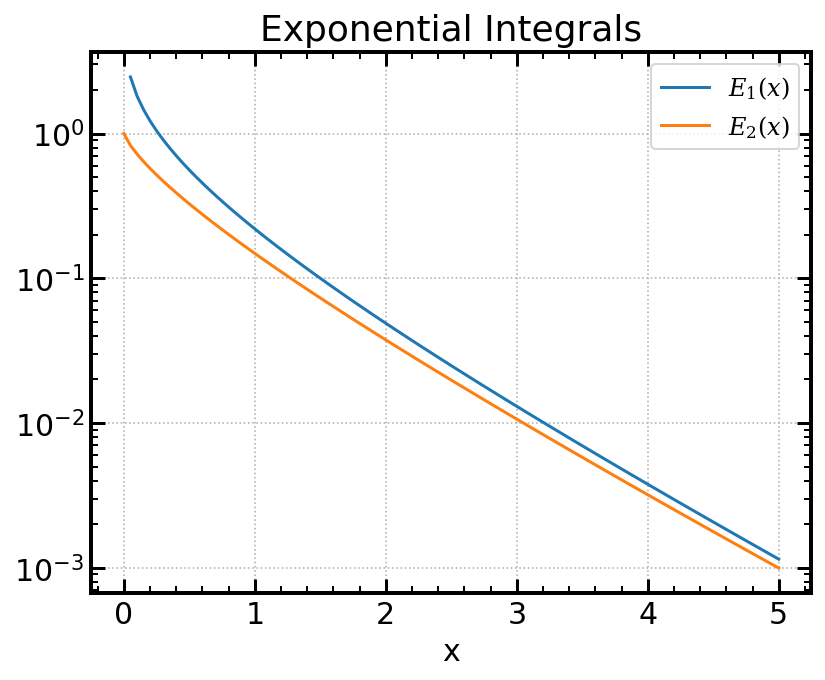

In [2]:
# Exponetial Integrals
e1 = lambda x: special.exp1(x)
e2 = lambda x: special.expn(2,x)

fig = plt.figure(figsize=(6,5))

x = np.linspace(0,5,100)

plt.plot(x,e1(x), label=r'$E_1(x)$')
plt.plot(x,e2(x), label=r'$E_2(x)$')

plt.title('Exponential Integrals')
plt.xlabel(r'x')
plt.yscale('log')
plt.grid(ls=':')
plt.legend()

fig.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=300)
plt.show()

## 2. Shape of Source function

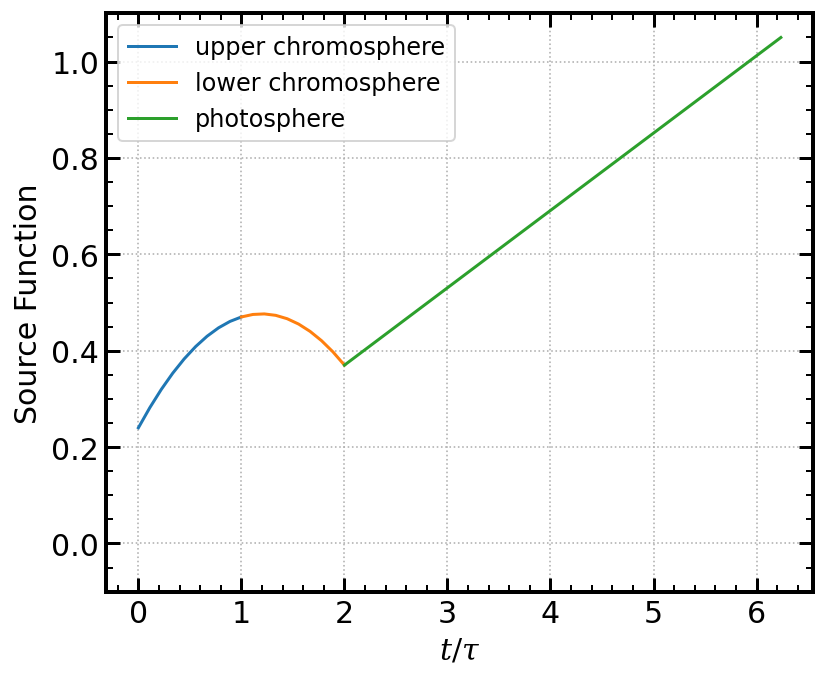

In [3]:
# Source Functions
S0 = 0.24
S1 = 0.47
S2 = 0.37
Sp = 1.05
eta = 10**0.51

s1 = lambda x: S0 + (-3*S0+4*S1-S2)/2 * x + (S0-2*S1+S2)/2 * x**2
s2 = lambda x: S1 + (-S0+S2)/2 * x + (S0-2*S1+S2)/2 * x**2
s3 = lambda x: S2 + (Sp-S2) * x

fig = plt.figure(figsize=(6,5))

x = np.linspace(0,1,10)

plt.plot(x,s1(x), label='upper chromosphere')
plt.plot(1+x,s2(x), label='lower chromosphere')
plt.plot(2+(1+eta)*x,s3(x), label='photosphere')

plt.ylim(-0.1,1.1)
plt.xlabel(r'$t/\tau$')
plt.ylabel(r'Source Function')
plt.grid(ls=':')
plt.legend()

fig.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=300)
plt.show()

## 3. Gaussian Quadrature
$$
\begin{equation}
    \int_{-1}^1 f(x) dx \sim \sum_{i=1}^n w_i f(x_i)
\end{equation}
$$
where for the Gauss-Legendre quadrature, 
- $x_i$: i-th root of $P_n$ (Legendre polynomial)
- $w_i = \frac{2}{(1-x_i^2)(P'_n(x_i))^2}$
If the interval is changed,
$$
\begin{equation}
    \int_{a}^b f(\xi) d\xi \sim \sum_{i=1}^n w_i f\bigg(\frac{b-a}{2}x_i+\frac{b+a}{2}\bigg)
\end{equation}
$$

In [24]:
def tau_quad(optical_depth, wavelength, num=3):
    if num==3:
        points = [(1-np.sqrt(3/5))/2, 1/2, (1+np.sqrt(3/5))/2]
        weights = [5/9, 8/9, 5/9]
    elif num==5:
        points = [(1-0.90618)/2, (1-0.53847)/2, 1/2, (1+0.53847)/2, (1+0.90618)/2]
        weights = [0.236927, 0.478629, 0.568889, 0.478629, 0.236927]
    else:
        raise NameError('Wrong num inputted!')
    
    v0, v1 = 20, -4 # in km/s
    w0, w1 = 0.02, 0.025 # in nm
    
    vx = lambda x: v0 + (v1-v0)*x
    wx = lambda x: w0 + (w1-w0)*x
    
    def u(wv, v, w):
        wv0 = 656.3 # Ha, in nm
        c = 3e5 # in km/s
        return (wv - (1+v/c)*wv0)/w
    
    # lower chromosphere
    r = lambda x, y: wofz(u(y,vx(x),wx(x))).real / wofz(0).real
    
    output = 0
    for point, weight in zip(points, weights):
        output += weight * r(point*optical_depth, wavelength)
    output = optical_depth/2 * output
    
    return output

In [63]:
def tau_intg(optical_depth, wavelength):
    v0, v1 = 20, -4 # in km/s
    w0, w1 = 0.02, 0.025 # in nm
    
    vx = lambda x: v0 + (v1-v0)*x
    wx = lambda x: w0 + (w1-w0)*x
    
    def u(wv, v, w):
        wv0 = 656.3 # Ha, in nm
        c = 3e5 # in km/s
        return (wv - (1+v/c)*wv0)/w
    
    # lower chromosphere
    r = lambda x, y: wofz(u(y,vx(x),wx(x))).real / wofz(0).real
    
    output1, output2 = integrate.quad(r, 0, optical_depth, args=(wavelength,))
    
    return output1

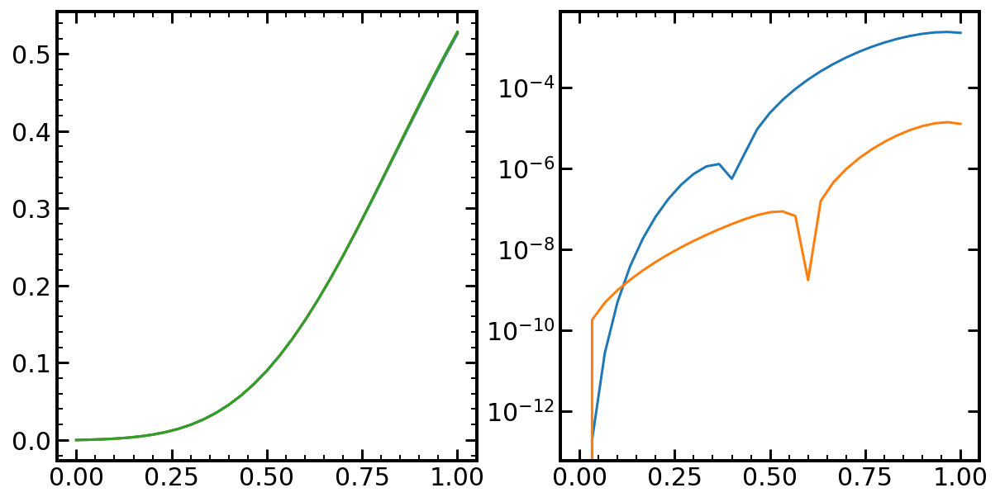

In [74]:
x = np.linspace(0,1, 31)
wavelength = 656.3 # in nm

result3 = []
result5 = []
resulti = []
for xx in x:
    result3.append(tau_quad(xx, wavelength, num=3))
    result5.append(tau_quad(xx, wavelength, num=5))
    resulti.append(tau_intg(xx, wavelength))

result3 = np.array(result3)
result5 = np.array(result5)
resulti = np.array(resulti)
    
fig, ax = plt.subplots(1,2, figsize=(10,5))
    
ax[0].plot(x, result3)
ax[0].plot(x, result5)
ax[0].plot(x, resulti)
    
ax[1].semilogy(x, abs(result3-resulti))
ax[1].semilogy(x, abs(result5-resulti))

plt.show()

# Introduction of FISS inversion parameters
---
## input
an array containing 17 parameters.
- parameter[0] : vp [km/s]
- parameter[1] : log eta [ ]
- parameter[2] : log wp [$\mathring A$]  
- parameter[3] : log a [ ]  
- parameter[4] : log Sp [?]  
- parameter[5] : log S2 [?]  
- parameter[6] : log tau2 [ ]  
- parameter[7] : log tau1 [ ]  
- parameter[8] : v2 [km/s]  
- parameter[9] : v1 [km/s]  
- parameter[10] : log w2 [$\mathring A$]  
- parameter[11] : log w1 [$\mathring A$]  
- parameter[12] : log S1 [?]  
- parameter[13] : log S0 [?]  
- parameter[14] : epsD [ ]  
- parameter[15] : epsC [ ]  
- parameter[16] : log Icenter [?]

## Sample Parameters

In [3]:
parHa = np.array([-0.395 ,  0.4923, -0.644 ,  0.4858, -0.004 ,
                  -0.1789,  0.699 ,  0.699 , -0.5748, -0.404 , 
                  -0.3948,  0.3964, -0.3125, -0.5347,  0.144 ])
parCa = np.array([-0.75  ,  0.3741, -1.268 ,  1.295 , -0.0092,
                  -0.3656,  0.699 ,  0.699 ,  0.8927, -3.5456, 
                  -0.6919, -0.6911, -0.1665, -0.3544,  0.271 ])

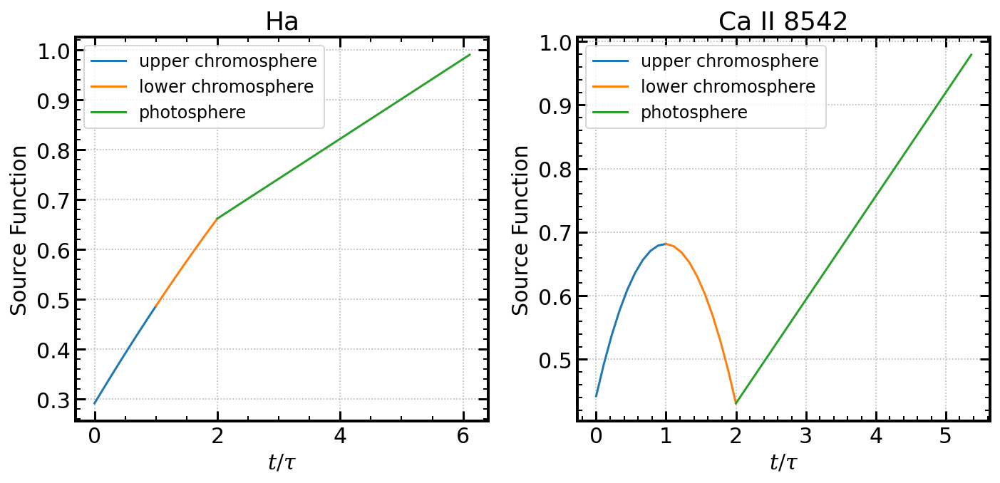

In [3]:
# Source Functions
pars = parHa

S0 = 10**pars[13]
S1 = 10**pars[12]
S2 = 10**pars[5]
Sp = 10**pars[4]
eta = 10**pars[1]

s1 = lambda x: S0 + (-3*S0+4*S1-S2)/2 * x + (S0-2*S1+S2)/2 * x**2
s2 = lambda x: S1 + (-S0+S2)/2 * x + (S0-2*S1+S2)/2 * x**2
s3 = lambda x: S2 + (Sp-S2) * x

fig, ax = plt.subplots(1,2, figsize=(10,5))

x = np.linspace(0,1,10)

ax[0].plot(x,s1(x), label='upper chromosphere')
ax[0].plot(1+x,s2(x), label='lower chromosphere')
ax[0].plot(2+(1+eta)*x,s3(x), label='photosphere')
ax[0].set(xlabel=r'$t/\tau$', ylabel='Source Function', title='Ha')
ax[0].grid(ls=':')
ax[0].legend()

pars = parCa

S0 = 10**pars[13]
S1 = 10**pars[12]
S2 = 10**pars[5]
Sp = 10**pars[4]
eta = 10**pars[1]

s1 = lambda x: S0 + (-3*S0+4*S1-S2)/2 * x + (S0-2*S1+S2)/2 * x**2
s2 = lambda x: S1 + (-S0+S2)/2 * x + (S0-2*S1+S2)/2 * x**2
s3 = lambda x: S2 + (Sp-S2) * x

ax[1].plot(x,s1(x), label='upper chromosphere')
ax[1].plot(1+x,s2(x), label='lower chromosphere')
ax[1].plot(2+(1+eta)*x,s3(x), label='photosphere')
ax[1].set(xlabel=r'$t/\tau$', ylabel='Source Function', title='Ca II 8542')
ax[1].grid(ls=':')
ax[1].legend()

fig.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=300)
plt.show()

# Prof. Chae's Rad. Loss calculation Code

In [3]:
def ThreeLayerRadLoss(p, line='Ha'):
    """
    To calculate the radiative losses of the upper chromosphere and
    the lower chromosphere, respectively, from the three-layer model parameters

    Parameters
    ----------
    p : array_like
        parameters of three layer models.
    line : str, optional
        line designation. The default is 'Ha'.

    Returns
    -------
    Radloss01 : float
        radiative loss from the upper chromosphere in unit of kW/m^2
        
    Radloss12 : float
        rdaitive loss from the lower chromosphere in unit of kW/m^2   

    """    
    xvalues5p = np.array([-0.9062, -0.5385,   0.,     0.5385, 0.9062])
    weights5p = np.array([ 0.2369,  0.4786,   0.5689 ,0.4786, 0.2369])    
    xvalues3p = np.array([-0.774597,0, 0.774597])
    weights3p = np.array([0.55556, 0.888889, 0.555556])
    xvalues2p = np.array([-0.57735,0.57735])
    weights2p = np.array([1., 1.])

    def fwvline(line):
        if line == 'Ha': 
            wvline = 6562.817
        elif line == 'Ca': 
            wvline = 8542.091

        return wvline

    wvline = fwvline(line)
    lambdaMax = 10.
    tauM = 100.
 
    wvline = fwvline(line)
    wvp = p[0]/3e5 * wvline
    eta, wp, ap, Sp, S2 = 10.**p[1:6]
    
    tau2, tau1 = 10**p[6:8]
    wv01, wv00 = p[8:10]/3.e5*wvline
    w1, w0 = 10**p[10:12]
    S1, S0 = 10**p[12:14]
    wg = p[14]
    wv02 = wvp
    w2 = wp

    a0 = S0
    a1 = (-1.5*S0+2*S1-0.5*S2)
    a2 = (0.5*S0-S1+0.5*S2)

    def Sf(x, level):
        if level == 1:
            value = a0 + a1*(x) + a2*(x)**2
        elif level == 2:
            value = a0 + a1*(x+1) + a2*(x+1)**2
        elif level == 3:
            value = S2 + (Sp-S2)*(tauM*x)

        return value
    
    def gf(wv1, x, level):
        if level == 1:
            #ulamb = (wv1-(wv00+(wv01-wv00)*x))/(w0 + (w1-w0)*x)
            wvcenter = wv00+(wv01-wv00)*x
            width = w0 + (w1-w0)*x
            u = (wv1-wvcenter)/width
            value = np.exp(-u**2)/np.pi**0.5/width
        elif level == 2:
            wvcenter= wv01+(wv02-wv01)*x
            width = w1 + (w2-w1)*x
            a = (wg*x)/width
            z = (wv1-wvcenter)/width + 1j*a
            z0 = 1j*a
            value = wofz(z).real/wofz(z0).real
        elif level == 3:
            z = (wv1-wvp)/wp + 1j*ap
            z0 = 1j*ap
            value = 1 + eta * wofz(z).real/wofz(z0).real

        return value
    
    def dff(wv1, x1, x2, level):
        if level == 3:
            value = (x2-x1)*gf(wv1, x1, level)
        else:    
            xx = xvalues3p * (x2-x1)/2 + (x2+x1)/2
            wdx = weights3p * (x2-x1)/2
            value = 0
            for i in range(len(xx)):
                value += gf(wv1, xx[i], level) * wdx[i]

        return value

    xs = xvalues5p * (1-0)/2 + (1+0)/2
    weightdx = weights5p * (1-0)/2
    Nx = len(xs)
    
    Nlambda = int(2*lambdaMax/0.2)
    Nlambda += 3 - (Nlambda-1)%3
    index = np.arange(Nlambda)
    
    # wrong formula detected!!!
    w = 3 * np.ones(Nlambda, float)
    s = (index%3 == 0)
    w[s] = 2
    w[0] = 1
    w[-1] = 1
    lambdas = (index/(Nlambda-1)-0.5)*lambdaMax
    weightdlambda = (3/8)*(lambdas[-1]-lambdas[0])/(Nlambda-1) * w
    
    Nl = 3
    levels = np.array([1,2,3])
    gs = np.zeros((Nlambda, Nx, Nl))
    fs = np.zeros((Nlambda, Nx, Nl))
    
    for l in range(Nl):
        for j in range(Nx):
            gs[:,j,l] = gf(lambdas, xs[j], levels[l])

            if j == 0:
                fs[:,j,l] = dff(lambdas, 0., xs[j], levels[l])
            else:
                fs[:,j,l] = fs[:, j-1,l] + dff(lambdas, xs[j-1], xs[j], levels[l])
    
    taulambda1 = tau1 * ( fs[:, -1, 0]+dff(lambdas, xs[-1], 1., 1))
    taulambda2 = tau2 * ( fs[:, -1, 1]+dff(lambdas, xs[-1], 1., 2))
    
    K12 = np.zeros((Nx, Nl))
    K01 = np.zeros((Nx, Nl))
    S = np.zeros((Nx, Nl))
    
    for j in range(Nx):            
            tmp = -expn(2, taulambda1-tau1*fs[:,j,0]) + expn(2, taulambda1+taulambda2-tau1*fs[:,j,0])
            tmp = tau1 * tmp * gs[:,j,0]
            K12[j,0] = (weightdlambda*tmp).sum()
            
            tmp = expn(2,tau1*fs[:,j,1])+ expn(2, taulambda2-tau2*fs[:,j,1])
            tmp = tau2 * tmp * gs[:,j,1]
            K12[j,1] = (weightdlambda*tmp).sum()
            
            tmp = expn(2, tau1*fs[:,j,0])+ expn(2, taulambda1-tau1*fs[:,j,0])
            tmp = tau1 * tmp * gs[:,j,0]
            K01[j,0] = (weightdlambda*tmp).sum()
            
            tmp = expn(2,taulambda1+ tau2*fs[:,j,1])- expn(2, tau2*fs[:,j,1])
            tmp = tau2 * tmp * gs[:,j,1]
            K01[j,1] = (weightdlambda*tmp).sum()
            
            if Nl > 2:
                tmp = -expn(2,tauM*fs[:,j,2])+expn(2,  taulambda2+tauM*fs[:,j,2])
                tmp = tauM * tmp * gs[:,j,2]
                K12[j,2] =(weightdlambda*tmp).sum() 
                
                tmp = -expn(2,taulambda2+tauM*fs[:,j,2])+expn(2, taulambda1+ taulambda2+tauM*fs[:,j,2])
                tmp = tauM * tmp * gs[:,j,2]
                K01[j,2] = (weightdlambda*tmp).sum()
        
            for l in range(Nl):
                S[j,l] = Sf(xs[j], levels[l])       
    
    Radloss01, Radloss12 = 0., 0

    for l in range(Nl):
        Radloss01 += (2*np.pi)* (weightdx*S[:,l]*K01[:,l]).sum()
        Radloss12 += (2*np.pi)* (weightdx*S[:,l]*K12[:,l]).sum()
    if line == 'Ha':
        Radloss01 = Radloss01*(2.84)  # in kW/m^2
        Radloss12 = Radloss12*(2.84)
    elif line == 'Ca':
        Radloss01 = Radloss01*(1.76)  
        Radloss12 = Radloss12*(1.76)  # in kW/m^2

    return Radloss01, Radloss12

In [4]:
# line = Ha
# wavelength int size = 2 nm
# wavelength bin size = 0.01 nm
%time ThreeLayerRadLoss(p=parHa, line='Ha')

CPU times: user 1.78 ms, sys: 893 µs, total: 2.68 ms
Wall time: 2.42 ms


(17.22292356691701, 10.955456524495522)

## part by part

In [38]:
xvalues5p = np.array([-0.9062, -0.5385,   0.,     0.5385, 0.9062])
weights5p = np.array([ 0.2369,  0.4786,   0.5689 ,0.4786, 0.2369])    
xvalues3p = np.array([-0.774597,0, 0.774597])
weights3p = np.array([0.55556, 0.888889, 0.555556])
xvalues2p = np.array([-0.57735,0.57735])
weights2p = np.array([1., 1.])

p = parCa
line = 'Ca'

def fwvline(line):
    if line == 'Ha': 
        wvline = 6562.817
    elif line == 'Ca': 
        wvline = 8542.091

    return wvline

wvline = fwvline(line)
lambdaMax = 10.
tauM = 5

wvline = fwvline(line)
wvp = p[0]/3e5 * wvline
eta, wp, ap, Sp, S2 = 10.**p[1:6]

tau2, tau1 = 10**p[6:8]
wv01, wv00 = p[8:10]/3.e5*wvline
w1, w0 = 10**p[10:12]
S1, S0 = 10**p[12:14]
wg = p[14]
wv02 = wvp
w2 = wp

a0 = S0
a1 = (-1.5*S0+2*S1-0.5*S2)
a2 = (0.5*S0-S1+0.5*S2)

def Sf(x, level):
    if level == 1:
        value = a0 + a1*(x) + a2*(x)**2
    elif level == 2:
        value = a0 + a1*(x+1) + a2*(x+1)**2
    elif level == 3:
        value = S2 + (Sp-S2)*(tauM*x)

    return value

def gf(wv1, x, level):
    if level == 1:
        #ulamb = (wv1-(wv00+(wv01-wv00)*x))/(w0 + (w1-w0)*x)
        wvcenter = wv00+(wv01-wv00)*x
        width = w0 + (w1-w0)*x
        u = (wv1-wvcenter)/width
        value = np.exp(-u**2)/np.pi**0.5/width
    elif level == 2:
        wvcenter= wv01+(wv02-wv01)*x
        width = w1 + (w2-w1)*x
        a = (wg*x)/width
        z = (wv1-wvcenter)/width + 1j*a
        z0 = 1j*a
        value = wofz(z).real/wofz(z0).real
    elif level == 3:
        z = (wv1-wvp)/wp + 1j*ap
        z0 = 1j*ap
        value = 1 + eta * wofz(z).real/wofz(z0).real

    return value

def dff(wv1, x1, x2, level):
    if level == 3:
        value = (x2-x1)*gf(wv1, x1, level)
    else:    
        xx = xvalues3p * (x2-x1)/2 + (x2+x1)/2
        wdx = weights3p * (x2-x1)/2
        value = 0
        for i in range(len(xx)):
            value += gf(wv1, xx[i], level) * wdx[i]

    return value

In [39]:
xs = xvalues5p * (1-0)/2 + (1+0)/2
weightdx = weights5p * (1-0)/2
Nx = len(xs)

Nlambda = int(2*lambdaMax/0.2)
Nlambda += 3 - (Nlambda-1)%3
index = np.arange(Nlambda)

# wrong formula detected!!!
w = 3 * np.ones(Nlambda, float)
s = (index%3 == 0)
w[s] = 2
w[0] = 1
w[-1] = 1
lambdas = (index/(Nlambda-1)-0.5)*lambdaMax
weightdlambda = (3/8)*(lambdas[-1]-lambdas[0])/(Nlambda-1) * w

Nl = 2
levels = np.array([1,2,3])
gs = np.zeros((Nlambda, Nx, Nl))
fs = np.zeros((Nlambda, Nx, Nl))

In [40]:
for l in range(Nl):
    for j in range(Nx):
        gs[:,j,l] = gf(lambdas, xs[j], levels[l])

        if j == 0:
            fs[:,j,l] = dff(lambdas, 0., xs[j], levels[l])
        else:
            fs[:,j,l] = fs[:, j-1,l] + dff(lambdas, xs[j-1], xs[j], levels[l])

taulambda1 = tau1 * ( fs[:, -1, 0]+dff(lambdas, xs[-1], 1., 1))
taulambda2 = tau2 * ( fs[:, -1, 1]+dff(lambdas, xs[-1], 1., 2))

K12 = np.zeros((Nx, Nl))
K01 = np.zeros((Nx, Nl))
S = np.zeros((Nx, Nl))

In [41]:
M0 = np.zeros((Nx, Nl))
M1 = np.zeros((Nx, Nl))
M2 = np.zeros((Nx, Nl))

In [42]:
for j in range(Nx):            
        tmp = -expn(2, taulambda1-tau1*fs[:,j,0]) + expn(2, taulambda1+taulambda2-tau1*fs[:,j,0])
        tmp = tau1 * tmp * gs[:,j,0]
        K12[j,0] = (weightdlambda*tmp).sum()

        tmp = expn(2,tau1*fs[:,j,1])+ expn(2, taulambda2-tau2*fs[:,j,1])
        tmp = tau2 * tmp * gs[:,j,1]
        K12[j,1] = (weightdlambda*tmp).sum()

        tmp = expn(2, tau1*fs[:,j,0])+ expn(2, taulambda1-tau1*fs[:,j,0])
        tmp = tau1 * tmp * gs[:,j,0]
        K01[j,0] = (weightdlambda*tmp).sum()

        tmp = expn(2,taulambda1+ tau2*fs[:,j,1])- expn(2, tau2*fs[:,j,1])
        tmp = tau2 * tmp * gs[:,j,1]
        K01[j,1] = (weightdlambda*tmp).sum()
        
        ###
        tmp = expn(2, tau1*fs[:,j,0])
        tmp = tau1 * tmp * gs[:,j,0]
        M0[j,0] = (weightdlambda * tmp).sum()
        
        tmp = expn(2, taulambda1 + tau2*fs[:,j,1])
        tmp = tau1 * tmp * gs[:,j,1]
        M0[j,1] = (weightdlambda * tmp).sum()
        
        ###
        tmp = -expn(2, taulambda1 - tau1*fs[:,j,0])
        tmp = tau1 * tmp * gs[:,j,0]
        M1[j,0] = (weightdlambda * tmp).sum()
        
        tmp = expn(2, tau2*fs[:,j,1])
        tmp = tau1 * tmp * gs[:,j,1]
        M1[j,1] = (weightdlambda * tmp).sum()
        
        ###
        tmp = -expn(2, taulambda1 - tau1*fs[:,j,0] + taulambda2)
        tmp = tau1 * tmp * gs[:,j,0]
        M2[j,0] = (weightdlambda * tmp).sum()
        
        tmp = -expn(2, taulambda2 - tau2*fs[:,j,1])
        tmp = tau1 * tmp * gs[:,j,1]
        M2[j,1] = (weightdlambda * tmp).sum()

        if Nl > 2:
            tmp = -expn(2,tauM*fs[:,j,2])+expn(2,  taulambda2+tauM*fs[:,j,2])
            tmp = tauM * tmp * gs[:,j,2]
            K12[j,2] = (weightdlambda*tmp).sum() 

            tmp = -expn(2,taulambda2+tauM*fs[:,j,2])+expn(2, taulambda1+ taulambda2+tauM*fs[:,j,2])
            tmp = tauM * tmp * gs[:,j,2]
            K01[j,2] = (weightdlambda*tmp).sum()
            
            ###
            tmp = expn(2, taulambda1 + taulambda2 + tauM*fs[:,j,2])
            tmp = tauM * tmp * gs[:,j,2]
            M0[j,2] = (weightdlambda*tmp).sum() 
            
            ###
            tmp = expn(2, taulambda2 + tauM*fs[:,j,2])
            tmp = tauM * tmp * gs[:,j,2]
            M1[j,2] = (weightdlambda*tmp).sum()
            
            ###
            tmp = expn(2, tauM*fs[:,j,2])
            tmp = tauM * tmp * gs[:,j,2]
            M2[j,2] = (weightdlambda*tmp).sum()

        for l in range(Nl):
            S[j,l] = Sf(xs[j], levels[l])       

flux0, flux1, flux2 = 0, 0, 0
Radloss01, Radloss12 = 0., 0

for l in range(Nl):
    flux0 += (2*np.pi)* (weightdx*S[:,l]*M0[:,l]).sum()
    flux1 += (2*np.pi)* (weightdx*S[:,l]*M1[:,l]).sum()
    flux2 += (2*np.pi)* (weightdx*S[:,l]*M2[:,l]).sum()
    
    Radloss01 += (2*np.pi)* (weightdx*S[:,l]*K01[:,l]).sum()
    Radloss12 += (2*np.pi)* (weightdx*S[:,l]*K12[:,l]).sum()
    
if line == 'Ha':
    flux0 = flux0 * 2.84
    flux1 = flux1 * 2.84
    flux2 = flux2 * 2.84
    
    Radloss01 = Radloss01*(2.84)  # in kW/m^2
    Radloss12 = Radloss12*(2.84)
elif line == 'Ca':
    flux0 = flux0 * 1.76
    flux1 = flux1 * 1.76
    flux2 = flux2 * 1.76
    
    Radloss01 = Radloss01*(1.76)  
    Radloss12 = Radloss12*(1.76)  # in kW/m^2

In [19]:
# Ha
flux0, flux1, flux2

(6.2757621598926265, 3.9243693559748714, -3.534798735191922)

In [20]:
# Ha
Radloss01, Radloss12

(2.351392803917753, 7.459168091166793)

In [29]:
# Ha (tau=5)
flux0, flux1, flux2

(36.691843995189856, 34.52669544141289, 31.611938642589433)

In [30]:
# Ha (tau=5)
Radloss01, Radloss12

(2.165148553776963, 2.914756798823446)

In [36]:
# Ha (tau=1)
flux0, flux1, flux2

(28.83981821206324, 26.67056349863056, 23.898854424342762)

In [37]:
# Ha (tau=1)
Radloss01, Radloss12

(2.1692547134326663, 2.771709074287806)

In [43]:
# Ha (tau=5, Nl=2)
flux0, flux1, flux2

(4.942609511723214, 2.5912138625978454, -4.886539086884181)

In [44]:
# Ha (tau=5, Nl=2)
Radloss01, Radloss12

(2.3513956491253656, 7.477752949482026)

In [22]:
# Ca
flux0, flux1, flux2

(6.2757621598926265, 3.9243693559748714, -3.534798735191922)

In [23]:
# Ca
Radloss01, Radloss12

(2.351392803917753, 7.459168091166793)

# Flux Calculator

## ver.1 - nquad

In [11]:
def flux_calculator(pars, line='Ha', int_bin_size=2, calc_opt='diff_sum', epsrel=1e-3):  
    # source function, [S] = ?
    s0 = 10**pars[13]
    s1 = 10**pars[12]
    s2 = 10**pars[5]
    sp = 10**pars[4]

    S1 = lambda x: s0 + (-3*s0+4*s1-s2)/2 * x + (s0-2*s1+s2)/2 * x**2
    S2 = lambda x: s1 + (-s0+s2)/2 * x        + (s0-2*s1+s2)/2 * x**2
    S3 = lambda x: s2 + (sp-s2) * x/(1-x-1e-9)

    # Doppler shift, [v] = km/s
    v0 = pars[9]
    v1 = pars[8]
    v2 = pars[0]
    vp = v2
    
    # Doppelr width, [w] = nm
    w0 = 10**(pars[11]-1)
    w1 = 10**(pars[10]-1)
    w2 = 10**(pars[2]-1)
    wp = w2
    wg = pars[14]
    
    # Other parameters, [a]&[eta]&[tau] = None
    a1 = 0.0
    a2 = lambda x: 10**wg/10*x/(w1 + (w2-w1)*x)
    ap = 10**pars[3]
    eta = 10**pars[1]
    tau = 5.0
    c = 3e5 # km/s
    
    # different parameters of given line
    if line == 'Ha':
        line_center = 656.2817 # nm
        flux_factor = 28.5/1.05 # kW m-2 sr-1 nm-1
    elif line == 'Ca':
        line_center = 854.2091 # nm
        flux_factor = 17.6/1.05 # kW m-2 sr-1 nm-1
    else:
        raise NameError('Wrong line inputting.')
    
    # Line profiles & optical depth
    u = lambda y, v, w: (y - (1+v/c)*line_center)/w
    
    r1 = lambda x, y: wofz(u(y,v0 + (v1-v0)*x,w0 + (w1-w0)*x) + a1*1j).real    / wofz(a1*1j).real
    r2 = lambda x, y: wofz(u(y,v1 + (v2-v1)*x,w1 + (w2-w1)*x) + a2(x)*1j).real / wofz(a2(x)*1j).real
    rp = lambda y:    wofz(u(y,v2            ,w2            ) + ap*1j).real    / wofz(ap*1j).real * eta + 1
    
    xi1 = (1-(3/5)**0.5)/2
    xi2 = (1+(3/5)**0.5)/2
    xi = [-0.90618, -0.53847, 0, 0.53847, 0.90618]
    wi = [0.23693, 0.47863, 0.56889, 0.47863, 0.23693]
    
    t1 = lambda x1, x2, y: tau * (x2-x1)/2 * (5/9*r1(x2*xi1+x1*xi2,y) + 8/9*r1((x1+x2)/2,y) + 5/9*r1(x2*xi2+x1*xi1,y))
    t2 = lambda x1, x2, y: tau * (x2-x1)/2 * (5/9*r2(x2*xi1+x1*xi2,y) + 8/9*r2((x1+x2)/2,y) + 5/9*r2(x2*xi2+x1*xi1,y))
    tp = lambda x, y:      x/(1-x-1e-9) * rp(y)

    E2 = lambda x: special.expn(2,x)
    
    print(t1(0,1,line_center))
    print(t2(0,1,line_center))
    print(tp(0.5,line_center))
    
    # integration range [nm], default bin size = 2nm
    int_bin = [line_center-int_bin_size/2, line_center+int_bin_size/2]
    print(f'wavelength integral range = {int_bin}')

    # Flux_0: flux to top plane of chromosphere
    f00 = lambda x, y: S1(x) * E2(t1(0,x,y)                      ) * r1(x,y) * tau
    f01 = lambda x, y: S2(x) * E2(t1(0,1,y) + t2(0,x,y)          ) * r2(x,y) * tau
    f02 = lambda x, y: S3(x) * E2(t1(0,1,y) + t2(0,1,y) + tp(x,y)) * rp(y)   / (1-x-1e-9)**2
    
    # Flux_1: flux to mid plane of chromosphere
    f10 = lambda x, y: S1(x) * -E2(t1(x,1,y)          ) * r1(x,y) * tau
    f11 = lambda x, y: S2(x) *  E2(t2(0,x,y)          ) * r2(x,y) * tau
    f12 = lambda x, y: S3(x) *  E2(t2(0,1,y) + tp(x,y)) * rp(y)   / (1-x-1e-9)**2
    
    # Flux_2: flux to bottom plane of chromosphere
    f20 = lambda x, y: S1(x) * -E2(t1(x,1,y) + t2(0,1,y)) * r1(x,y) * tau
    f21 = lambda x, y: S2(x) * -E2(t2(x,1,y)            ) * r2(x,y) * tau
    f22 = lambda x, y: S3(x) *  E2(tp(x,y)              ) * rp(y)   / (1-x-1e-9)**2
    
    # Flux Differenece
    # upper chromosphere
    f010 = lambda x, y: S1(x) * (E2(t1(0,x,y))                       + E2(t1(x,1,y))          ) * r1(x,y) * tau
    f011 = lambda x, y: S2(x) * (E2(t1(0,1,y) + t2(0,x,y))           - E2(t2(0,x,y))          ) * r2(x,y) * tau
    f012 = lambda x, y: S3(x) * (E2(t1(0,1,y) + t2(0,1,y) + tp(x,y)) - E2(t2(0,1,y) + tp(x,y))) * rp(y)   /(1-x-1e-9)**2

    # lower chromosphere
    f120 = lambda x, y: S1(x) * (-E2(t1(x,1,y))          + E2(t1(x,1,y) + t2(0,1,y))) * r1(x,y) * tau
    f121 = lambda x, y: S2(x) * (E2(t2(0,x,y))           + E2(t2(x,1,y))            ) * r2(x,y) * tau
    f122 = lambda x, y: S3(x) * (E2(t2(0,1,y) + tp(x,y)) - E2(tp(x,y))              ) * rp(y)   /(1-x-1e-9)**2
    
    # Calculation part
    quad_kwargs = {'epsrel':epsrel}
       
    if 'flux' in calc_opt:
        FR, ERR = np.zeros((3,3)), np.zeros((3,3))

        FR[0,0], ERR[0,0] = integrate.nquad(f00, [[0,1],int_bin], opts=quad_kwargs)
        FR[0,1], ERR[0,1] = integrate.nquad(f01, [[0,1],int_bin], opts=quad_kwargs) 
        FR[0,2], ERR[0,2] = integrate.nquad(f02, [[0,1],int_bin], opts=quad_kwargs)

        FR[1,0], ERR[1,0] = integrate.nquad(f10, [[0,1],int_bin], opts=quad_kwargs)
        FR[1,1], ERR[1,1] = integrate.nquad(f11, [[0,1],int_bin], opts=quad_kwargs)
        FR[1,2], ERR[1,2] = integrate.nquad(f12, [[0,1],int_bin], opts=quad_kwargs)

        FR[2,0], ERR[2,0] = integrate.nquad(f20, [[0,1],int_bin], opts=quad_kwargs)
        FR[2,1], ERR[2,1] = integrate.nquad(f21, [[0,1],int_bin], opts=quad_kwargs)
        FR[2,2], ERR[2,2] = integrate.nquad(f22, [[0,1],int_bin], opts=quad_kwargs)
    
    elif 'diff' in calc_opt:
        FR, ERR = np.zeros((2,3)), np.zeros((2,3))

        FR[0,0], ERR[0,0] = integrate.nquad(f010, [[0,1],int_bin], opts=quad_kwargs)
        FR[0,1], ERR[0,1] = integrate.nquad(f011, [[0,1],int_bin], opts=quad_kwargs) 
        FR[0,2], ERR[0,2] = integrate.nquad(f012, [[0,1],int_bin], opts=quad_kwargs)

        FR[1,0], ERR[1,0] = integrate.nquad(f120, [[0,1],int_bin], opts=quad_kwargs)
        FR[1,1], ERR[1,1] = integrate.nquad(f121, [[0,1],int_bin], opts=quad_kwargs)
        FR[1,2], ERR[1,2] = integrate.nquad(f122, [[0,1],int_bin], opts=quad_kwargs)
    
    if 'sum' in calc_opt:
        FR, ERR = FR @ np.ones(3), ERR @ np.ones(3)
    elif 'each' in calc_opt:
        pass

    # [F_R] = kW/m^2
    FR = 2*np.pi * FR * flux_factor
    ERR = 2*np.pi * ERR * flux_factor
    
    return FR, ERR

### test

### default) 1.2 nm, 1e-3

In [5]:
%time flux_calculator(parHa, line='Ha', int_bin_size=1.2, epsrel=1e-3, calc_opt='flux_each')

4.999351468552971
4.998681988492293
4.106318224671674
wavelength integral range = [655.6817, 656.8817]
CPU times: user 1.37 s, sys: 30 µs, total: 1.37 s
Wall time: 1.37 s


(array([[ 15.01400171,   9.92228986,  34.51849389],
        [-18.20160594,  30.76269207,  42.90640763],
        [ -3.46713703, -33.33222354,  84.67927642]]),
 array([[0.01781117, 0.00365431, 0.00202731],
        [0.03364809, 0.0428331 , 0.01131241],
        [0.00012902, 0.04969677, 0.05401473]]))

In [6]:
%time flux_calculator(parHa, line='Ha', int_bin_size=1.2, epsrel=1e-3, calc_opt='diff_sum')

4.999351468552971
4.998681988492293
4.106318224671674
wavelength integral range = [655.6817, 656.8817]
CPU times: user 2.1 s, sys: 25 µs, total: 2.1 s
Wall time: 2.09 s


(array([3.98728603, 7.58756437]), array([0.11192846, 0.16902146]))

In [7]:
%time flux_calculator(parCa, line='Ca', int_bin_size=1.2, epsrel=1e-3, calc_opt='flux_each')

4.690171147570076
4.9946466598405115
3.3655179495831433
wavelength integral range = [853.6091, 854.8091000000001]
CPU times: user 2.31 s, sys: 1.99 ms, total: 2.31 s
Wall time: 2.31 s


(array([[ 1.86760966e+00,  2.04098424e+01,  1.88706757e+01],
        [-2.26016084e+00,  2.27201749e+01,  1.88768125e+01],
        [-6.73223197e-03, -1.95439143e+01,  4.36800461e+01]]),
 array([[2.59565590e-02, 1.84518148e-03, 1.05016802e-02],
        [3.01236761e-02, 1.45302984e-02, 3.13043998e-03],
        [2.97002010e-06, 1.93763148e-02, 3.66469736e-02]]))

In [8]:
%time flux_calculator(parCa, line='Ca', int_bin_size=1.2, epsrel=1e-3, calc_opt='diff_sum')

4.690171147570076
4.9946466598405115
3.3655179495831433
wavelength integral range = [853.6091, 854.8091000000001]
CPU times: user 4.24 s, sys: 17 µs, total: 4.24 s
Wall time: 4.24 s


(array([ 1.81124643, 15.20741327]), array([0.0828967 , 0.11261015]))

### comparing with prof. made

In [9]:
import fissprocinv

In [11]:
%time fissprocinv.ThreeLayerRadLoss(parHa, line='Ha')

CPU times: user 2.31 ms, sys: 5 µs, total: 2.32 ms
Wall time: 2.18 ms


(20.99883234680857, 8.686580575786696)

In [12]:
%time fissprocinv.ThreeLayerRadLoss(parCa, line='Ca')

CPU times: user 2.29 ms, sys: 0 ns, total: 2.29 ms
Wall time: 2.18 ms


(1.8323729957663206, 6.43189422505472)

### epsrel test

In [28]:
# Calculation Time depending on epsabs/epsrel
def plot_ertest(pars, line='Ha'):
    epsrels = [5e-1, 1e-1, 1e-2, 1e-3, 1e-4, 1e-5, 1e-6, 1e-7, 1.49e-8]
    caltime = []
    frs, errs = [], []

    for epsrel in epsrels:
        t1 = time()
        fr,err = flux_calculator(pars, line=line, int_bin_size=1.2, epsrel=epsrel, calc_opt='flux_sum')
        t2 = time()
    #     print('done')

        caltime.append(t2-t1)
        frs.append(fr)
        errs.append(err)

    frs, errs = np.array(frs), np.array(errs)
    
    fig, ax = plt.subplots(1,3, figsize=(15,5))

    ax[0].loglog(epsrels, caltime, 'bo')
    ax[0].set(xlabel='Relative uncertainty', ylabel='Cal. time [s]')
#     ax[0].set_ylim(0.9e-1,3e1)

    ax[1].semilogx(epsrels, frs[:,0])
    ax[1].semilogx(epsrels, frs[:,1])
    ax[1].semilogx(epsrels, frs[:,2])
    ax[1].set(xlabel='Relative uncertainty', ylabel=r'Rad. Flux [$kW/m^2$]')

    ax[2].loglog(epsrels[:-1], abs(frs[:,0]/frs[-1,0]-1)[:-1], label=rf'$F_0$ = {frs[-1,0]:.3f} $[kW/m^2]$')
    ax[2].loglog(epsrels[:-1], abs(frs[:,1]/frs[-1,1]-1)[:-1], label=rf'$F_1$ = {frs[-1,1]:.3f} $[kW/m^2]$')
    ax[2].loglog(epsrels[:-1], abs(frs[:,2]/frs[-1,2]-1)[:-1], label=rf'$F_2$ = {frs[-1,2]:.3f} $[kW/m^2]$')
    ax[2].set(xlabel='Relative uncertainty', ylabel='Relative error')
    ax[2].legend()

    plt.suptitle(f'{line} line: $\Delta\lambda$ = 1.2 nm')
    plt.tight_layout()
    #plt.savefig('.pdf', format='pdf', dpi=500)
    plt.show()

wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]


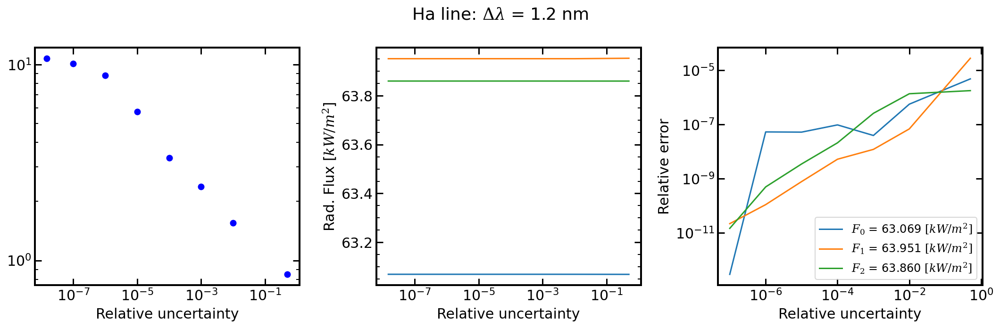

In [27]:
plot_ertest(parHa, line='Ha')

wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]


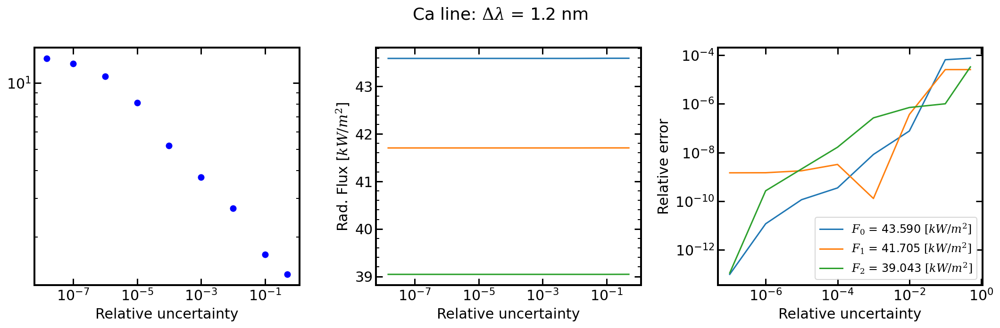

In [29]:
plot_ertest(parCa, line='Ca')

### wavelength test

In [39]:
def plot_wvtest(pars, line='Ha'):
    int_bins = [0.25, 0.5, 1., 1.25, 1.5, 1.75, 2, 2.5, 3, 3.5, 4]
    caltime = []
    frs, errs = [], []

    for int_bin in int_bins:
        t1 = time()
        fr,err = flux_calculator(pars, line=line, int_bin_size=int_bin, calc_opt='flux_sum')
        t2 = time()
    #     print('done')

        caltime.append(t2-t1)
        frs.append(fr)
        errs.append(err)

    frs, errs = np.array(frs), np.array(errs)
    
    fig, ax = plt.subplots(1,3, figsize=(15,5))

    ax[0].plot(int_bins, caltime, 'bo')
    ax[0].set(xlabel=r'$\Delta\lambda$ [nm]', ylabel='Cal. time [s]')
#     ax[0].set_ylim(0.9e-1,3e1)

    ax[1].plot(int_bins, frs[:,0], label=rf'$F_0$ = {frs[-1,0]:.3f} $[kW/m^2]$')
    ax[1].plot(int_bins, frs[:,1], label=rf'$F_1$ = {frs[-1,1]:.3f} $[kW/m^2]$')
    ax[1].plot(int_bins, frs[:,2], label=rf'$F_2$ = {frs[-1,2]:.3f} $[kW/m^2]$')
    ax[1].set(xlabel=r'$\Delta\lambda$ [nm]', ylabel=r'Rad. Flux [$kW/m^2$]')
    ax[1].legend()
    
    ax[2].plot(int_bins, frs[:,0]-frs[:,1], color='red', label='upper chromosphere')
    ax[2].plot(int_bins, frs[:,1]-frs[:,2], color='blue', label='lower chromosphere')
    ax[2].set(xlabel=r'$\Delta\lambda$ [nm]', ylabel=r'Rad. Loss [$kW/m^2$]')
    ax[2].legend()
    
    plt.suptitle(f'{line} line: epsrel = 1e-3')
    plt.tight_layout()
    #plt.savefig('.pdf', format='pdf', dpi=500)
    plt.show()

wavelength integral range = [656.1567, 656.4067]
wavelength integral range = [656.0317, 656.5317]
wavelength integral range = [655.7817, 656.7817]
wavelength integral range = [655.6567, 656.9067]
wavelength integral range = [655.5317, 657.0317]
wavelength integral range = [655.4067, 657.1567]
wavelength integral range = [655.2817, 657.2817]
wavelength integral range = [655.0317, 657.5317]
wavelength integral range = [654.7817, 657.7817]
wavelength integral range = [654.5317, 658.0317]
wavelength integral range = [654.2817, 658.2817]


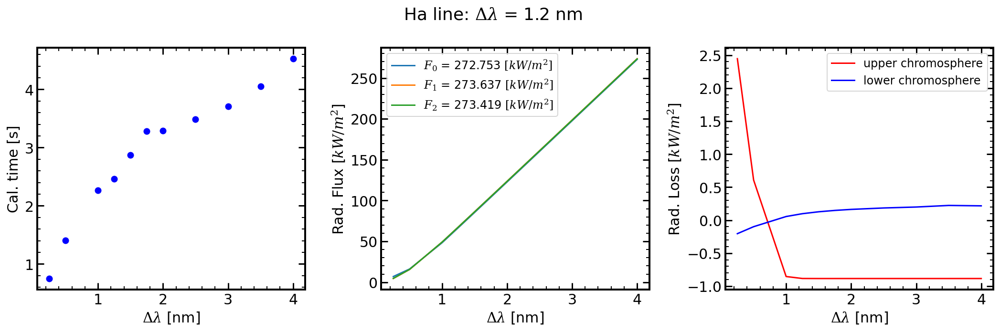

In [38]:
plot_wvtest(parHa, line='Ha')

wavelength integral range = [854.0841, 854.3341]
wavelength integral range = [853.9591, 854.4591]
wavelength integral range = [853.7091, 854.7091]
wavelength integral range = [853.5841, 854.8341]
wavelength integral range = [853.4591, 854.9591]
wavelength integral range = [853.3341, 855.0841]
wavelength integral range = [853.2091, 855.2091]
wavelength integral range = [852.9591, 855.4591]
wavelength integral range = [852.7091, 855.7091]
wavelength integral range = [852.4591, 855.9591]
wavelength integral range = [852.2091, 856.2091]


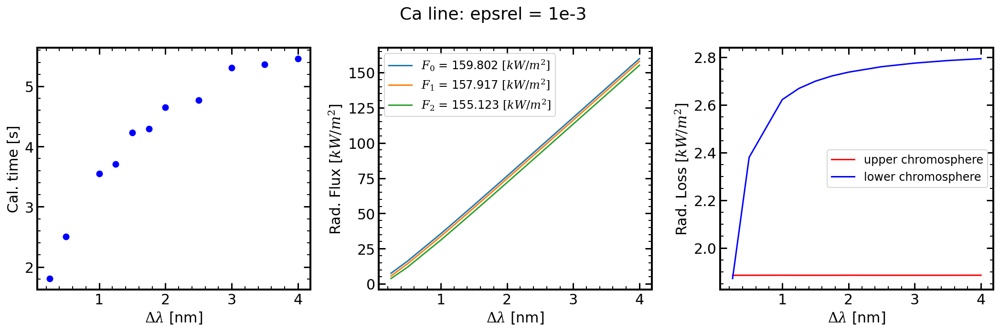

In [40]:
plot_wvtest(parCa, line='Ca')

### calculation time test

In [6]:
pars = parCa
line = 'Ca'
int_bin_size = 1.2
epsrel = 1e-3
calc_opt = 'flux_sum'

# source function, [S] = ?
s0 = 10**pars[13]
s1 = 10**pars[12]
s2 = 10**pars[5]
sp = 10**pars[4]

S1 = lambda x: s0 + (-3*s0+4*s1-s2)/2 * x + (s0-2*s1+s2)/2 * x**2
S2 = lambda x: s1 + (-s0+s2)/2 * x        + (s0-2*s1+s2)/2 * x**2
S3 = lambda x: s2 + (sp-s2) * x/(1-x-1e-9)

# Doppler shift, [v] = km/s
v0 = pars[9]
v1 = pars[8]
v2 = pars[0]
vp = v2

# Doppelr width, [w] = nm
w0 = 10**(pars[11]-1)
w1 = 10**(pars[10]-1)
w2 = 10**(pars[2]-1)
wp = w2

# Other parameters, [a]&[eta]&[tau] = None
a1 = 0.0
a2 = lambda x: pars[14]/10*x/(w1 + (w2-w1)*x)
ap = 10**pars[3]
eta = 10**pars[1]
tau = 5.0
c = 3e5 # km/s

# different parameters of given line
if line == 'Ha':
    line_center = 656.2817 # nm
    flux_factor = 28.5/1.05 # kW m-2 sr-1 nm-1
elif line == 'Ca':
    line_center = 854.2091 # nm
    flux_factor = 17.6/1.05 # kW m-2 sr-1 nm-1
else:
    raise NameError('Wrong line inputting.')

# Line profiles & optical depth
u = lambda y, v, w: (y - (1+v/c)*line_center)/w

r1 = lambda x, y: wofz(u(y,v0 + (v1-v0)*x,w0 + (w1-w0)*x) + a1*1j).real    / wofz(a1*1j).real
r2 = lambda x, y: wofz(u(y,v1 + (v2-v1)*x,w1 + (w2-w1)*x) + a2(x)*1j).real / wofz(a2(x)*1j).real
rp = lambda y:    wofz(u(y,v2            ,w2            ) + ap*1j).real    / wofz(ap*1j).real * eta + 1

xi1 = (1-(3/5)**0.5)/2
xi2 = (1+(3/5)**0.5)/2
xi = [-0.90618, -0.53847, 0, 0.53847, 0.90618]
wi = [0.23693, 0.47863, 0.56889, 0.47863, 0.23693]

t1 = lambda x1, x2, y: tau * (x2-x1)/2 * (5/9*r1(x2*xi1+x1*xi2,y) + 8/9*r1((x1+x2)/2,y) + 5/9*r1(x2*xi2+x1*xi1,y))
t2 = lambda x1, x2, y: tau * (x2-x1)/2 * (5/9*r2(x2*xi1+x1*xi2,y) + 8/9*r2((x1+x2)/2,y) + 5/9*r2(x2*xi2+x1*xi1,y))
# t1 = lambda x1, x2, y: tau * (x2-x1)/2 * np.sum([w*r1(((x2-x1)*x+(x1+x2))/2,y) for x, w in zip(xi,wi)])
# t2 = lambda x1, x2, y: tau * (x2-x1)/2 * np.sum([w*r2(((x2-x1)*x+(x1+x2))/2,y) for x, w in zip(xi,wi)])
tp = lambda x, y:      x/(1-x-1e-9) * rp(y)

E2 = lambda x: special.expn(2,x)

print(t1(0,1,line_center))
print(t2(0,1,line_center))
print(tp(0.5,line_center))

# integration range [nm], default bin size = 2nm
int_bin = [line_center-int_bin_size/2, line_center+int_bin_size/2]
print(f'wavelength integral range = {int_bin}')

# Flux_0: flux to top plane of chromosphere
f00 = lambda x, y: S1(x) * E2(t1(0,x,y)                      ) * r1(x,y) * tau
f01 = lambda x, y: S2(x) * E2(t1(0,1,y) + t2(0,x,y)          ) * r2(x,y) * tau
f02 = lambda x, y: S3(x) * E2(t1(0,1,y) + t2(0,1,y) + tp(x,y)) * rp(y)   / (1-x-1e-9)**2

# Flux_1: flux to mid plane of chromosphere
f10 = lambda x, y: S1(x) * -E2(t1(x,1,y)          ) * r1(x,y) * tau
f11 = lambda x, y: S2(x) *  E2(t2(0,x,y)          ) * r2(x,y) * tau
f12 = lambda x, y: S3(x) *  E2(t2(0,1,y) + tp(x,y)) * rp(y)   / (1-x-1e-9)**2

# Flux_2: flux to bottom plane of chromosphere
f20 = lambda x, y: S1(x) * -E2(t1(x,1,y) + t2(0,1,y)) * r1(x,y) * tau
f21 = lambda x, y: S2(x) * -E2(t2(x,1,y)            ) * r2(x,y) * tau
f22 = lambda x, y: S3(x) *  E2(tp(x,y)              ) * rp(y)   / (1-x-1e-9)**2

# Flux Differenece
# upper chromosphere
f010 = lambda x, y: S1(x) * (E2(t1(0,x,y))                       + E2(t1(x,1,y))          ) * r1(x,y) * tau
f011 = lambda x, y: S2(x) * (E2(t1(0,1,y) + t2(0,x,y))           - E2(t2(0,x,y))          ) * r2(x,y) * tau
f012 = lambda x, y: S3(x) * (E2(t1(0,1,y) + t2(0,1,y) + tp(x,y)) - E2(t2(0,1,y) + tp(x,y))) * rp(y)   /(1-x-1e-9)**2

# lower chromosphere
f120 = lambda x, y: S1(x) * (-E2(t1(x,1,y))          + E2(t1(x,1,y) + t2(0,1,y))) * r1(x,y) * tau
f121 = lambda x, y: S2(x) * (E2(t2(0,x,y))           + E2(t2(x,1,y))            ) * r2(x,y) * tau
f122 = lambda x, y: S3(x) * (E2(t2(0,1,y) + tp(x,y)) - E2(tp(x,y))              ) * rp(y)   /(1-x-1e-9)**2

# Calculation part
quad_kwargs = {'epsrel':epsrel}
       
#     if 'flux' in calc_opt:
#         FR, ERR = np.zeros((3,3)), np.zeros((3,3))

#         FR[0,0], ERR[0,0] = integrate.nquad(f00, [[0,1],int_bin], opts=quad_kwargs)
#         FR[0,1], ERR[0,1] = integrate.nquad(f01, [[0,1],int_bin], opts=quad_kwargs) 
#         FR[0,2], ERR[0,2] = integrate.nquad(f02, [[0,1],int_bin], opts=quad_kwargs)

#         FR[1,0], ERR[1,0] = integrate.nquad(f10, [[0,1],int_bin], opts=quad_kwargs)
#         FR[1,1], ERR[1,1] = integrate.nquad(f11, [[0,1],int_bin], opts=quad_kwargs)
#         FR[1,2], ERR[1,2] = integrate.nquad(f12, [[0,1],int_bin], opts=quad_kwargs)

#         FR[2,0], ERR[2,0] = integrate.nquad(f20, [[0,1],int_bin], opts=quad_kwargs)
#         FR[2,1], ERR[2,1] = integrate.nquad(f21, [[0,1],int_bin], opts=quad_kwargs)
#         FR[2,2], ERR[2,2] = integrate.nquad(f22, [[0,1],int_bin], opts=quad_kwargs)
    
#     elif 'diff' in calc_opt:
#         FR, ERR = np.zeros((2,3)), np.zeros((2,3))

#         FR[0,0], ERR[0,0] = integrate.nquad(f010, [[0,1],int_bin], opts=quad_kwargs)
#         FR[0,1], ERR[0,1] = integrate.nquad(f011, [[0,1],int_bin], opts=quad_kwargs) 
#         FR[0,2], ERR[0,2] = integrate.nquad(f012, [[0,1],int_bin], opts=quad_kwargs)

#         FR[1,0], ERR[1,0] = integrate.nquad(f120, [[0,1],int_bin], opts=quad_kwargs)
#         FR[1,1], ERR[1,1] = integrate.nquad(f121, [[0,1],int_bin], opts=quad_kwargs)
#         FR[1,2], ERR[1,2] = integrate.nquad(f122, [[0,1],int_bin], opts=quad_kwargs)
    
#     if 'sum' in calc_opt:
#         FR, ERR = FR @ np.ones(3), ERR @ np.ones(3)
#     elif 'each' in calc_opt:
#         pass

#     # [F_R] = kW/m^2
#     FR = 2*np.pi * FR * flux_factor
#     ERR = 2*np.pi * ERR * flux_factor
    
#     return FR, ERR

4.690171147570076
4.981203386723589
3.3655179495831433
wavelength integral range = [853.6091, 854.8091000000001]


In [3]:
%matplotlib notebook

<IPython.core.display.Javascript object>


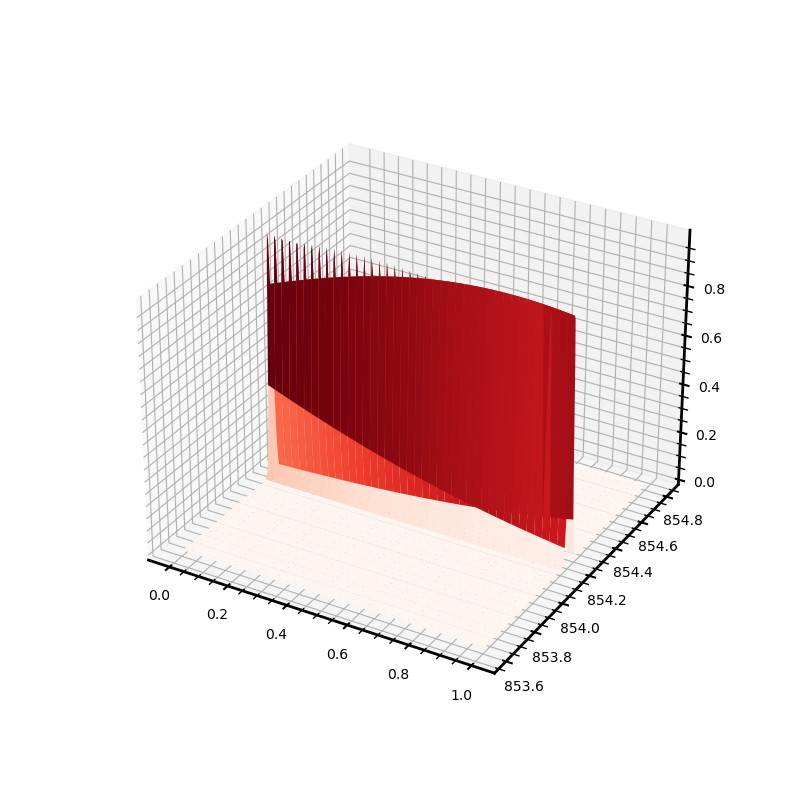

In [9]:
xs = np.linspace(0, 1, 201)
ys = np.linspace(int_bin[0], int_bin[1], 201)

X, Y = np.meshgrid(xs, ys)

fig = plt.figure(figsize=(8,8))
ax = plt.axes(projection='3d')

target = '1'

if target == '1':
    cmap = 'Reds'
    R = r1(X,Y)
    T = t1(0,X,Y)
#     E = E2(t1(0,X,Y))
    E = E2(t1(X,1,Y))
    
elif target == '2':
    cmap = 'Blues'
    R = r2(X,Y)
    T = t2(0,X,Y)
#     E = E2(t2(0,X,Y))
    E = E2(t1(0,1,Y) + t2(0,X,Y))
    
elif target == '3':
    cmap = 'Purples'
    R = rp(Y)
    T = tp(X,Y)
    E = E2(tp(X,Y))

F = S1(X) * E2(t1(0,X,Y)                      ) * r1(X,Y) * tau


# ax.plot_surface(X, Y, Z1, cmap=cmap)
# ax.plot_surface(X, Y, S1(X) * r1(X,Y) * E2(t1(0,X,Y)), cmap='Reds')
ax.plot_surface(X, Y, r1(X,Y), cmap='Reds')

# ax.set(zlim=[-1,10])
    
plt.show()

<IPython.core.display.Javascript object>


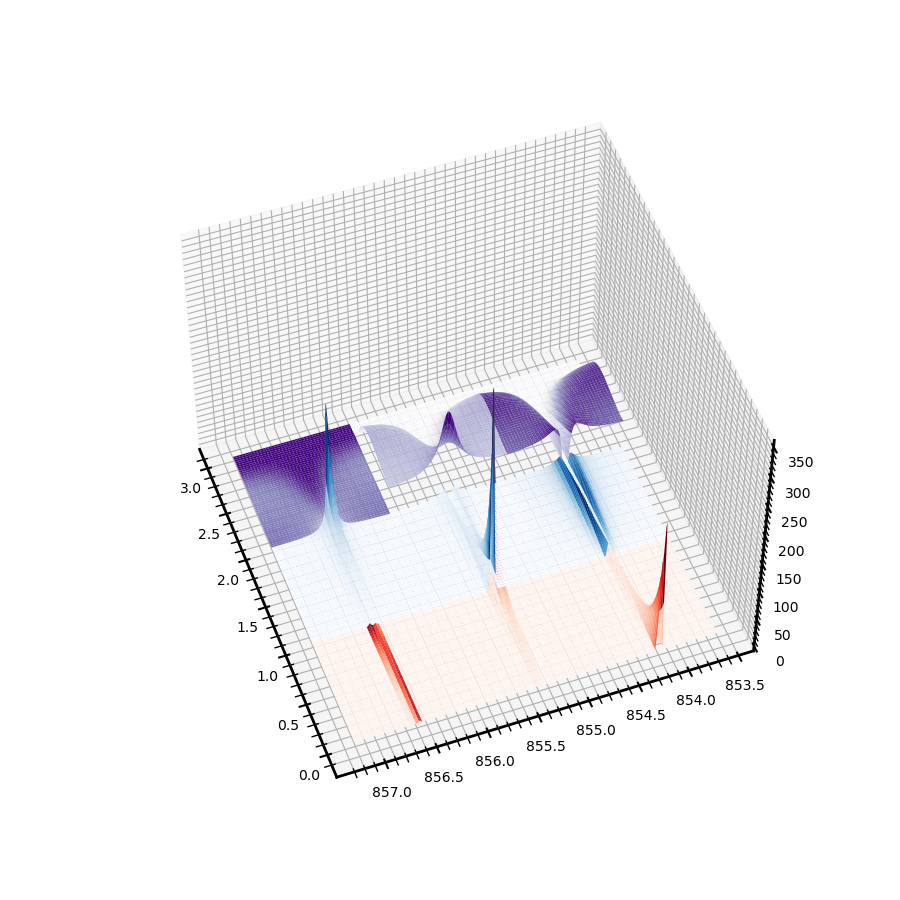

In [23]:
fig = plt.figure(figsize=(9,9))
ax = plt.axes(projection='3d')

F00 = S1(X) * E2(t1(0,X,Y)                      ) * r1(X,Y) * tau
F01 = S2(X) * E2(t1(0,1,Y) + t2(0,X,Y)          ) * r2(X,Y) * tau
F02 = S3(X) * E2(t1(0,1,Y) + t2(0,1,Y) + tp(X,Y)) * rp(Y)   / (1-X-1e-9)**2

# Flux_1: flux to mid plane of chromosphere
F10 = S1(X) * -E2(t1(X,1,Y)          ) * r1(X,Y) * tau
F11 = S2(X) *  E2(t2(0,X,Y)          ) * r2(X,Y) * tau
F12 = S3(X) *  E2(t2(0,1,Y) + tp(X,Y)) * rp(Y)   / (1-X-1e-9)**2

# Flux_2: flux to bottom plane of chromosphere
F20 = S1(X) * -E2(t1(X,1,Y) + t2(0,1,Y)) * r1(X,Y) * tau
F21 = S2(X) * -E2(t2(X,1,Y)            ) * r2(X,Y) * tau
F22 = S3(X) *  E2(tp(X,Y)              ) * rp(Y)   / (1-X-1e-9)**2

F00, F01, F02 = F00*2*np.pi*flux_factor, F01*2*np.pi*flux_factor, F02*2*np.pi*flux_factor
F10, F11, F12 = F10*2*np.pi*flux_factor, F11*2*np.pi*flux_factor, F12*2*np.pi*flux_factor
F20, F21, F12 = F20*2*np.pi*flux_factor, F21*2*np.pi*flux_factor, F22*2*np.pi*flux_factor

ax.plot_surface(X, Y, F00, cmap='Reds')
ax.plot_surface(X+1, Y, F01, cmap='Blues')
ax.plot_surface(2+X[:,:-1], Y[:,:-1], F02[:,:-1], cmap='Purples')

ax.plot_surface(X, 1.2+Y, -F10, cmap='Reds')
ax.plot_surface(1+X, 1.2+Y, F11, cmap='Blues')
ax.plot_surface(2+X[:,:-1], 1.2+Y[:,:-1], F12[:,:-1], cmap='Purples')

ax.plot_surface(X, 2.4+Y, -F20, cmap='Reds')
ax.plot_surface(1+X, 2.4+Y, -F21, cmap='Blues')
ax.plot_surface(2+X[:,:-1], 2.4+Y[:,:-1], -F22[:,:-1], cmap='Purples')


# ax.set(zlim=[-1,10])
    
plt.show()

<IPython.core.display.Javascript object>


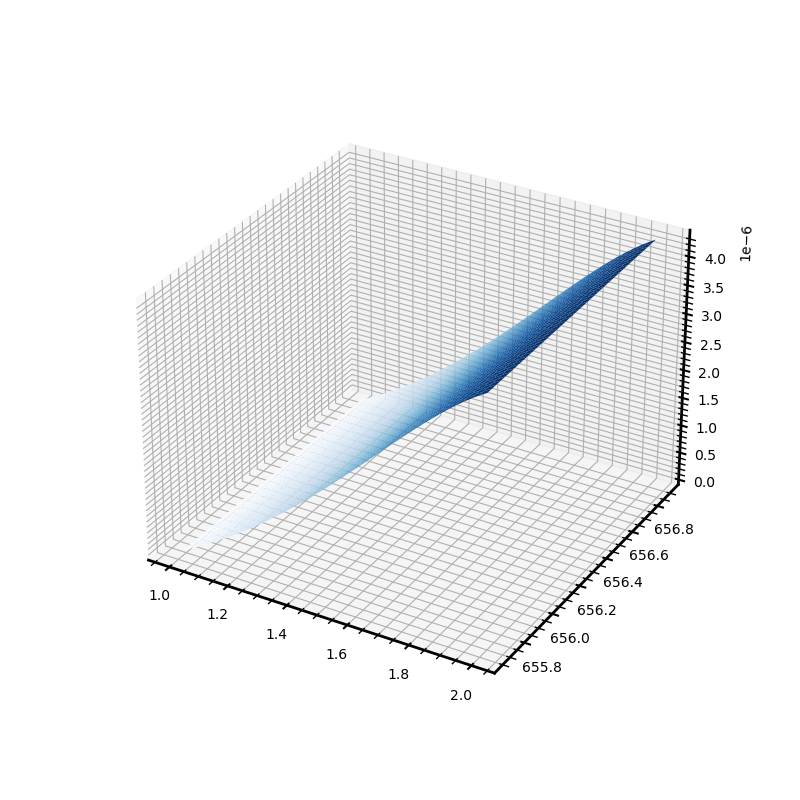

In [153]:
fig = plt.figure(figsize=(8,8))

# F01 = S2(X) *  E2(t1(0,1,Y) + t2(0,X,Y)) * r2(X,Y) * tau
# F11 = S2(X) *  E2(t2(0,X,Y)            ) * r2(X,Y) * tau
# F21 = S2(X) * -E2(t2(X,1,Y)            ) * r2(X,Y) * tau

ax = plt.axes(projection='3d')
#ax.plot_surface(X,Y, F00, cmap='Reds')
ax.plot_surface(1+X,Y, F01, cmap='Blues')
#ax.plot_surface(2+X[:,:-1],Y[:,:-1], F22[:,:-1], cmap='Purples')
#ax.set(zlim=[0,3])

plt.show()

In [17]:
fs = [f00, f01, f02, f10, f11, f12, f20, f21, f22]

for i, f in enumerate(fs):
    if i%3==0:
        print(f'Radiative flux component: ({i//3},j)')
    fr, err = integrate.nquad(f, [[0,1], int_bin], opts={'epsrel':1e-3})
    fr = 2*np.pi * flux_factor * fr
    err = 2*np.pi * flux_factor * err
    print(f'flux = {fr:.4f} +- {err:.4f} [kW/m2]') 
    
    %timeit integrate.nquad(f, [[0,1], int_bin], opts={'epsrel':1e-3})
    print('')

Radiative flux component: (0,j)
flux = 15.0140 +- 0.0178 [kW/m2]
111 ms ± 382 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)

flux = 0.3789 +- 0.0000 [kW/m2]
293 ms ± 3.99 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

flux = 47.6764 +- 0.0083 [kW/m2]
208 ms ± 221 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)

Radiative flux component: (1,j)
flux = -18.2016 +- 0.0336 [kW/m2]
55.4 ms ± 116 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)

flux = 7.4443 +- 0.0434 [kW/m2]
396 ms ± 4.27 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

flux = 74.7086 +- 0.0647 [kW/m2]
518 ms ± 2.1 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

Radiative flux component: (2,j)
flux = -12.4659 +- 0.0010 [kW/m2]
271 ms ± 512 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)

flux = -8.3536 +- 0.0514 [kW/m2]
389 ms ± 678 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)

flux = 84.6793 +- 0.0540 [kW/m2]
99.7 ms ± 435 µs per loop (mean ± std. dev. of 7 runs, 1

In [18]:
dfs = [f010, f011, f012, f120, f121, f122]

for i, f in enumerate(dfs):
    if i%3==0:
        print(f'Radiative Loss component: ({i//3}-{i//3+1},j)')
    fr, err = integrate.nquad(f, [[0,1], int_bin], opts={'epsrel':1e-3})
    fr = 2*np.pi * flux_factor * fr
    err = 2*np.pi * flux_factor * err
    print(f'flux = {fr:.4f} +- {err:.4f} [kW/m2]') 
    
    %timeit integrate.nquad(f, [[0,1], int_bin], opts={'epsrel':1e-3})
    print('')

Radiative Loss component: (0-1,j)
flux = 33.2156 +- 0.0582 [kW/m2]
178 ms ± 1.39 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)

flux = -7.0654 +- 0.0434 [kW/m2]
811 ms ± 4.55 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

flux = -27.0322 +- 0.0475 [kW/m2]
1.48 s ± 8.6 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

Radiative Loss component: (1-2,j)
flux = -5.7357 +- 0.0320 [kW/m2]
785 ms ± 3.39 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

flux = 15.7978 +- 0.0925 [kW/m2]
834 ms ± 12.5 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

flux = -9.9707 +- 0.0580 [kW/m2]
2.6 s ± 34.1 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)



## ver.2 - quad & simpson

In [4]:
def flux_calculator2(pars, line='Ha', wv_int_size=2, wv_bin_size=0.01):
    # different parameters of given line
    if line == 'Ha':
        line_center = 656.2817 # nm
        flux_factor = 28.5 # kW m-2 sr-1 nm-1
    elif line == 'Ca':
        line_center = 854.2091 # nm
        flux_factor = 17.6 # kW m-2 sr-1 nm-1
    else:
        raise NameError('Wrong line inputting.')
    
    # source function, [S] = ?
    s0 = 10**pars[13]
    s1 = 10**pars[12]
    s2 = 10**pars[5]
    sp = 10**pars[4]

    S1 = lambda x: s0 + (-3*s0+4*s1-s2)/2 * x + (s0-2*s1+s2)/2 * x**2
    S2 = lambda x: s1 + (-s0+s2)/2 * x        + (s0-2*s1+s2)/2 * x**2
    S3 = lambda x: s2 + (sp-s2) * x

    # Doppler shift, [v] = km/s
    v0 = pars[9]
    v1 = pars[8]
    v2 = pars[0]
    vp = v2
    
    # Doppler shift in wavelength, [wv] = nm
    c = 3e5 # km/s
    wv0 = v0/c * line_center
    wv1 = v1/c * line_center
    wv2 = v2/c * line_center
    wvp = vp/c * line_center
    
    # Doppelr width, [w] = nm
    w0 = 10**(pars[11]-1)
    w1 = 10**(pars[10]-1)
    w2 = 10**(pars[2]-1)
    wp = w2
    wg = pars[14]/10
    
    # Other parameters, [a]&[eta]&[tau] = None
    a1 = 0.0
    a2 = lambda x: wg*x/(w1 + (w2-w1)*x)
    ap = 10**pars[3]
    eta = 10**pars[1]
    tau2, tau1 = 10**pars[6:8]
    taup = 5
    
    # Dimensionless wavelength
    u = lambda y, wv, w: (y - wv)/w
    
    # Dimensionless Line profiles
    r1 = lambda x, y: wofz(u(y,wv0 + (wv1-wv0)*x,w0 + (w1-w0)*x) + 1j*a1   ).real / wofz(1j*a1   ).real
    r2 = lambda x, y: wofz(u(y,wv1 + (wv2-wv1)*x,w1 + (w2-w1)*x) + 1j*a2(x)).real / wofz(1j*a2(x)).real
    rp = lambda    y: wofz(u(y,wvp              ,wp)             + 1j*ap   ).real / wofz(1j*ap   ).real * eta + 1
        
    # Optical depth functions
    xi1 = (1-(3/5)**0.5)/2
    xi2 = (1+(3/5)**0.5)/2
    t1 = lambda x1, x2, y: tau1 * (x2-x1)/2 * (5/9*r1(x2*xi1+x1*xi2,y) + 8/9*r1((x1+x2)/2,y) + 5/9*r1(x2*xi2+x1*xi1,y))
    t2 = lambda x1, x2, y: tau2 * (x2-x1)/2 * (5/9*r2(x2*xi1+x1*xi2,y) + 8/9*r2((x1+x2)/2,y) + 5/9*r2(x2*xi2+x1*xi1,y))
    tp = lambda      x, y: taup * x * rp(y)
    
    # Points & Weights for Gauss-Legendre quadrature
    Nx = 51
    
    quad_points, quad_weights = np.polynomial.legendre.leggauss(deg=Nx)   
    x_points = (quad_points+1)/2
    x_weights = quad_weights/2
 
    # Number of binning for applying Simpson's 3/8 rule
    # wavelength integration range [nm], default bin size = 2nm    
    Ny = wv_int_size/wv_bin_size
    if Ny%1 != 0:
        raise Exception('wv_bin_size is wrongly inputted...')
    else:
        Ny = int(Ny)
    Ny += 3 - Ny%3 + 1
    
    wv_int_points = np.linspace(-wv_int_size/2, wv_int_size/2, Ny)
   
    wv_int_weights = 3 * np.ones(Ny)
    index = np.arange(Ny)
    wv_int_weights[index%3==0] = 2
    wv_int_weights[0] = 1
    wv_int_weights[-1] = 1
    wv_int_weights = wv_int_weights * 3/8 * wv_bin_size
   
    # Number of layers (2 chromospheres + photosphere)
    Nl = 3
    
    # GENERATE MATRIX
    # line profile matrices 
    R1 = np.array([[r1(x,y) for y in wv_int_points] for x in x_points])
    R2 = np.array([[r2(x,y) for y in wv_int_points] for x in x_points])
    Rp = np.array([[rp(y) for y in wv_int_points] for x in x_points])
    
    # Optical depth matrices
    x_dots = np.append(x_points, 1)
    if False:
        x_dots = np.insert(x_dots, 0, 0)
    TL1 = np.array([[t1(0,x,y) for y in wv_int_points] for x in x_dots])
    TL2 = np.array([[t2(0,x,y) for y in wv_int_points] for x in x_dots])
    TLp = np.array([[tp(x,y) for y in wv_int_points] for x in x_dots])
    
    TL1c = np.array([[t1(x,1,y) for y in wv_int_points] for x in x_dots])
    TL2c = np.array([[t2(x,1,y) for y in wv_int_points] for x in x_dots])
        
    # Kernel functions
    K00 = lambda i, j: expn(2, TL1[i,j]                        )
    K01 = lambda i, j: expn(2, TL1[-1,j] + TL2[i,j]            )
    K02 = lambda i, j: expn(2, TL1[-1,j] + TL2[-1,j] + TLp[i,j])
    
    K10 = lambda i, j: -expn(2, TL1c[i,j]           )
    K11 = lambda i, j:  expn(2, TL2[i,j]            )
    K12 = lambda i, j:  expn(2, TL2[-1,j] + TLp[i,j])
    
    K20 = lambda i, j: -expn(2, TL1c[i,j] + TL2[-1,j])
    K21 = lambda i, j: -expn(2, TL2c[i,j]            )
    K22 = lambda i, j:  expn(2, TLp[i,j]             )
    
    # kernel matrices
    k00 = np.array([[K00(i,j) for j in range(Ny)] for i in range(Nx)])
    k01 = np.array([[K01(i,j) for j in range(Ny)] for i in range(Nx)])
    k02 = np.array([[K02(i,j) for j in range(Ny)] for i in range(Nx)])

    k10 = np.array([[K10(i,j) for j in range(Ny)] for i in range(Nx)])
    k11 = np.array([[K11(i,j) for j in range(Ny)] for i in range(Nx)])
    k12 = np.array([[K12(i,j) for j in range(Ny)] for i in range(Nx)])

    k20 = np.array([[K20(i,j) for j in range(Ny)] for i in range(Nx)])
    k21 = np.array([[K21(i,j) for j in range(Ny)] for i in range(Nx)])
    k22 = np.array([[K22(i,j) for j in range(Ny)] for i in range(Nx)])
    
    flux = np.zeros((3,3))
    
    Sx1 = x_weights * S1(x_points)
    Sx2 = x_weights * S2(x_points)
    Sx3 = x_weights * S3(x_points)
    
    flux[0,0] = Sx1 @ (k00 * R1) @ wv_int_weights * 2*np.pi * tau1 * flux_factor
    flux[0,1] = Sx2 @ (k01 * R2) @ wv_int_weights * 2*np.pi * tau2 * flux_factor
    flux[0,2] = Sx3 @ (k02 * Rp) @ wv_int_weights * 2*np.pi * taup * flux_factor

    flux[1,0] = Sx1 @ (k10 * R1) @ wv_int_weights * 2*np.pi * tau1 * flux_factor
    flux[1,1] = Sx2 @ (k11 * R2) @ wv_int_weights * 2*np.pi * tau2 * flux_factor
    flux[1,2] = Sx3 @ (k12 * Rp) @ wv_int_weights * 2*np.pi * taup * flux_factor
    
    flux[2,0] = Sx1 @ (k20 * R1) @ wv_int_weights * 2*np.pi * tau1 * flux_factor
    flux[2,1] = Sx2 @ (k21 * R2) @ wv_int_weights * 2*np.pi * tau2 * flux_factor
    flux[2,2] = Sx3 @ (k22 * Rp) @ wv_int_weights * 2*np.pi * taup * flux_factor
    
    # Radiative Flux in unit of kW/m^2
    flux0, flux1, flux2 = flux @ np.ones(3)
    
    # Radiative Loss in unit of kW/m^2
    radloss1 = flux0 - flux1
    radloss2 = flux1 - flux2
    
    return flux, flux0, flux1, flux2, radloss1, radloss2

### test - Ha

In [5]:
flux_calculator2(parHa, line='Ha', wv_int_size=2, wv_bin_size=0.002)

(array([[ 15.80241107,   0.51689086,  90.97161118],
        [-19.15624333,   7.95068757, 115.471819  ],
        [-13.12142635,  -8.90749195, 125.28139208]]),
 107.29091310584812,
 104.26626323747072,
 103.25247378001504,
 3.024649868377395,
 1.0137894574556867)

In [6]:
flux_calculator2(parCa, line='Ca', wv_int_size=2, wv_bin_size=0.002)

(array([[ 1.96493424,  3.30034837, 49.85050841],
        [-2.37795383,  5.54957357, 49.93988349],
        [-0.11870955, -4.87204752, 54.21529205]]),
 55.11579101217205,
 53.11150322853323,
 49.224534973670515,
 2.004287783638823,
 3.8869682548627154)

### part by part

In [72]:
pars = parHa
line = 'Ha'
wv_int_size = 2
wv_bin_size = 0.002

# different parameters of given line
if line == 'Ha':
    line_center = 656.2817 # nm
    flux_factor = 28.5 # kW m-2 sr-1 nm-1
elif line == 'Ca':
    line_center = 854.2091 # nm
    flux_factor = 17.6 # kW m-2 sr-1 nm-1
else:
    raise NameError('Wrong line inputting.')

# source function, [S] = ?
s0 = 10**pars[13]
s1 = 10**pars[12]
s2 = 10**pars[5]
sp = 10**pars[4]

S1 = lambda x: s0 + (-3*s0+4*s1-s2)/2 * x + (s0-2*s1+s2)/2 * x**2
S2 = lambda x: s1 + (-s0+s2)/2 * x        + (s0-2*s1+s2)/2 * x**2
S3 = lambda x: s2 + (sp-s2) * x

# Doppler shift, [v] = km/s
v0 = pars[9]
v1 = pars[8]
v2 = pars[0]
vp = v2

# Doppler shift in wavelength, [wv] = nm
c = 3e5 # km/s
wv0 = v0/c * line_center
wv1 = v1/c * line_center
wv2 = v2/c * line_center
wvp = vp/c * line_center

# Doppelr width, [w] = nm
w0 = 10**(pars[11]-1)
w1 = 10**(pars[10]-1)
w2 = 10**(pars[2]-1)
wp = w2
wg = pars[14]/10

# Other parameters, [a]&[eta]&[tau] = None
a1 = 0.0
a2 = lambda x: wg*x/(w1 + (w2-w1)*x)
ap = 10**pars[3]
eta = 10**pars[1]
tau2, tau1 = 10**pars[6:8]
taup = 5

# Dimensionless wavelength
u = lambda y, wv, w: (y - wv)/w

# Dimensionless Line profiles
r1 = lambda x, y: wofz(u(y,wv0 + (wv1-wv0)*x,w0 + (w1-w0)*x) + 1j*a1   ).real / wofz(1j*a1   ).real
r2 = lambda x, y: wofz(u(y,wv1 + (wv2-wv1)*x,w1 + (w2-w1)*x) + 1j*a2(x)).real / wofz(1j*a2(x)).real
rp = lambda    y: wofz(u(y,wvp              ,wp)             + 1j*ap   ).real / wofz(1j*ap   ).real * eta + 1

# Optical depth functions
xi1 = (1-(3/5)**0.5)/2
xi2 = (1+(3/5)**0.5)/2
t1 = lambda x1, x2, y: tau1 * (x2-x1)/2 * (5/9*r1(x2*xi1+x1*xi2,y) + 8/9*r1((x1+x2)/2,y) + 5/9*r1(x2*xi2+x1*xi1,y))
t2 = lambda x1, x2, y: tau2 * (x2-x1)/2 * (5/9*r2(x2*xi1+x1*xi2,y) + 8/9*r2((x1+x2)/2,y) + 5/9*r2(x2*xi2+x1*xi1,y))
tp = lambda      x, y: taup * x * rp(y)

# Points & Weights for Gauss-Legendre quadrature
Nx = 21

quad_points, quad_weights = np.polynomial.legendre.leggauss(deg=Nx)   
x_points = (quad_points+1)/2
x_weights = quad_weights/2

# Number of binning for applying Simpson's 3/8 rule
# wavelength integration range [nm], default bin size = 2nm    
Ny = wv_int_size/wv_bin_size
if Ny%1 != 0:
    raise Exception('wv_bin_size is wrongly inputted...')
else:
    Ny = int(Ny)
Ny += 3 - Ny%3 + 1

wv_int_points = np.linspace(-wv_int_size/2, wv_int_size/2, Ny)

wv_int_weights = 3 * np.ones(Ny)
index = np.arange(Ny)
wv_int_weights[index%3==0] = 2
wv_int_weights[0] = 1
wv_int_weights[-1] = 1
wv_int_weights = wv_int_weights * 3/8 * wv_bin_size

# Number of layers (2 chromospheres + photosphere)
Nl = 3

# GENERATE MATRIX
# line profile matrices 
R1 = np.array([[r1(x,y) for y in wv_int_points] for x in x_points])
R2 = np.array([[r2(x,y) for y in wv_int_points] for x in x_points])
Rp = np.array([[rp(  y) for y in wv_int_points] for x in x_points])

# Optical depth matrices
x_dots = np.append(x_points, 1)
if False:
    x_dots = np.insert(x_dots, 0, 0)
TL1 = np.array([[t1(0,x,y) for y in wv_int_points] for x in x_dots])
TL2 = np.array([[t2(0,x,y) for y in wv_int_points] for x in x_dots])
TLp = np.array([[tp(x,y) for y in wv_int_points] for x in x_dots])

TL1c = np.array([[t1(x,1,y) for y in wv_int_points] for x in x_dots])
TL2c = np.array([[t2(x,1,y) for y in wv_int_points] for x in x_dots])

# Kernel functions
K00 = lambda i, j: expn(2, TL1[i,j]                        )
K01 = lambda i, j: expn(2, TL1[-1,j] + TL2[i,j]            )
K02 = lambda i, j: expn(2, TL1[-1,j] + TL2[-1,j] + TLp[i,j])

K10 = lambda i, j: -expn(2, TL1c[i,j]           )
K11 = lambda i, j:  expn(2, TL2[i,j]            )
K12 = lambda i, j:  expn(2, TL2[-1,j] + TLp[i,j])

K20 = lambda i, j: -expn(2, TL1c[i,j] + TL2[-1,j])
K21 = lambda i, j: -expn(2, TL2c[i,j]            )
K22 = lambda i, j:  expn(2, TLp[i,j]             )

# kernel matrices
k00 = np.array([[K00(i,j) for j in range(Ny)] for i in range(Nx)])
k01 = np.array([[K01(i,j) for j in range(Ny)] for i in range(Nx)])
k02 = np.array([[K02(i,j) for j in range(Ny)] for i in range(Nx)])

k10 = np.array([[K10(i,j) for j in range(Ny)] for i in range(Nx)])
k11 = np.array([[K11(i,j) for j in range(Ny)] for i in range(Nx)])
k12 = np.array([[K12(i,j) for j in range(Ny)] for i in range(Nx)])

k20 = np.array([[K20(i,j) for j in range(Ny)] for i in range(Nx)])
k21 = np.array([[K21(i,j) for j in range(Ny)] for i in range(Nx)])
k22 = np.array([[K22(i,j) for j in range(Ny)] for i in range(Nx)])

flux = np.zeros((3,3))

Sx1 = x_weights * S1(x_points)
Sx2 = x_weights * S2(x_points)
Sx3 = x_weights * S3(x_points)

flux[0,0] = Sx1 @ (k00 * R1) @ wv_int_weights * 2*np.pi * tau1 * flux_factor
flux[0,1] = Sx2 @ (k01 * R2) @ wv_int_weights * 2*np.pi * tau2 * flux_factor
flux[0,2] = Sx3 @ (k02 * Rp) @ wv_int_weights * 2*np.pi * taup * flux_factor

flux[1,0] = Sx1 @ (k10 * R1) @ wv_int_weights * 2*np.pi * tau1 * flux_factor
flux[1,1] = Sx2 @ (k11 * R2) @ wv_int_weights * 2*np.pi * tau2 * flux_factor
flux[1,2] = Sx3 @ (k12 * Rp) @ wv_int_weights * 2*np.pi * taup * flux_factor

flux[2,0] = Sx1 @ (k20 * R1) @ wv_int_weights * 2*np.pi * tau1 * flux_factor
flux[2,1] = Sx2 @ (k21 * R2) @ wv_int_weights * 2*np.pi * tau2 * flux_factor
flux[2,2] = Sx3 @ (k22 * Rp) @ wv_int_weights * 2*np.pi * taup * flux_factor

# Radiative Flux in unit of kW/m^2
flux0, flux1, flux2 = flux @ np.ones(3)

# Radiative Loss in unit of kW/m^2
radloss1 = flux0 - flux1
radloss2 = flux1 - flux2

In [59]:
flux, flux0, flux1, flux2, radloss1, radloss2

(array([[ 1.96489863,  3.30034837, 49.84925703],
        [-2.37789887,  5.54951862, 49.93863211],
        [-0.11870955, -4.8719879 , 54.20929346]]),
 55.11450402165063,
 53.110251861952186,
 49.218596012096725,
 2.0042521596984457,
 3.8916558498554608)

### draw parameters

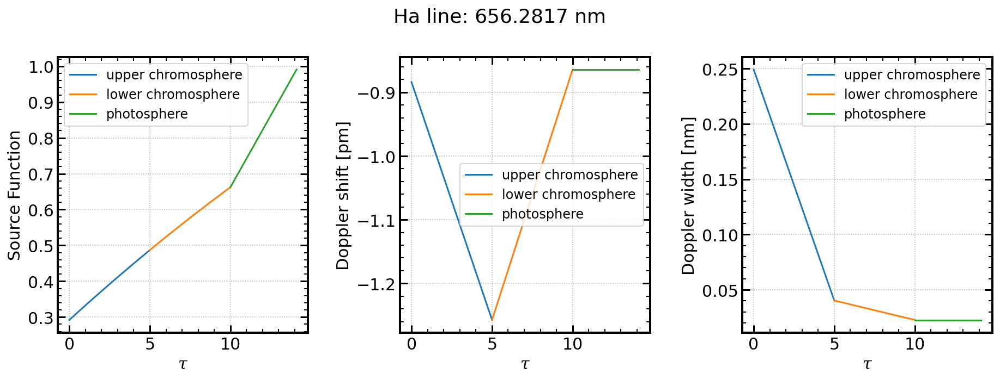

In [73]:
# parameters figure: source function, doppler shift, doppler width
fig, ax = plt.subplots(1, 3, figsize=(13,5))

x = np.linspace(0,1,10)

ax[0].plot(tau1*x, S1(x), label='upper chromosphere')
ax[0].plot(tau1+tau2*x, S2(x), label='lower chromosphere')
ax[0].plot(tau1+tau2+(1+eta)*x, S3(x), label='photosphere')

ax[0].set(xlabel=r'$\tau$', ylabel=r'Source Function')
ax[0].grid(ls=':')
ax[0].legend()

ax[1].plot(tau1*x, 1e3*(wv0 + (wv1-wv0)*x), label='upper chromosphere')
ax[1].plot(tau1+tau2*x, 1e3*(wv1 + (wv2-wv1)*x), label='lower chromosphere')
ax[1].plot(tau1+tau2+(1+eta)*x, 1e3*wvp*np.ones(10), label='photosphere')

ax[1].set(xlabel=r'$\tau$', ylabel=r'Doppler shift [pm]')
ax[1].grid(ls=':')
ax[1].legend()

ax[2].plot(tau1*x, w0 + (w1-w0)*x, label='upper chromosphere')
ax[2].plot(tau1+tau2*x, w1 + (w2-w1)*x, label='lower chromosphere')
ax[2].plot(tau1+tau2+(1+eta)*x, wp*np.ones(10), label='photosphere')

ax[2].set(xlabel=r'$\tau$', ylabel=r'Doppler width [nm]')
ax[2].grid(ls=':')
ax[2].legend()

plt.suptitle(f'{line} line: {line_center} nm')
plt.tight_layout()
plt.show()

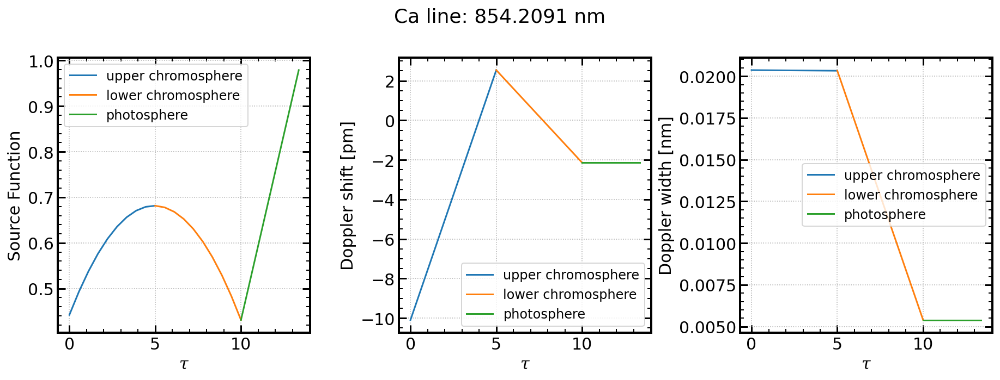

In [60]:
# parameters figure: source function, doppler shift, doppler width
fig, ax = plt.subplots(1, 3, figsize=(13,5))

x = np.linspace(0,1,10)

ax[0].plot(tau1*x, S1(x), label='upper chromosphere')
ax[0].plot(tau1+tau2*x, S2(x), label='lower chromosphere')
ax[0].plot(tau1+tau2+(1+eta)*x, S3(x), label='photosphere')

ax[0].set(xlabel=r'$\tau$', ylabel=r'Source Function')
ax[0].grid(ls=':')
ax[0].legend()

ax[1].plot(tau1*x, 1e3*(wv0 + (wv1-wv0)*x), label='upper chromosphere')
ax[1].plot(tau1+tau2*x, 1e3*(wv1 + (wv2-wv1)*x), label='lower chromosphere')
ax[1].plot(tau1+tau2+(1+eta)*x, 1e3*wvp*np.ones(10), label='photosphere')

ax[1].set(xlabel=r'$\tau$', ylabel=r'Doppler shift [pm]')
ax[1].grid(ls=':')
ax[1].legend()

ax[2].plot(tau1*x, w0 + (w1-w0)*x, label='upper chromosphere')
ax[2].plot(tau1+tau2*x, w1 + (w2-w1)*x, label='lower chromosphere')
ax[2].plot(tau1+tau2+(1+eta)*x, wp*np.ones(10), label='photosphere')

ax[2].set(xlabel=r'$\tau$', ylabel=r'Doppler width [nm]')
ax[2].grid(ls=':')
ax[2].legend()

plt.suptitle(f'{line} line: {line_center} nm')
plt.tight_layout()
plt.show()

### draw optical depth

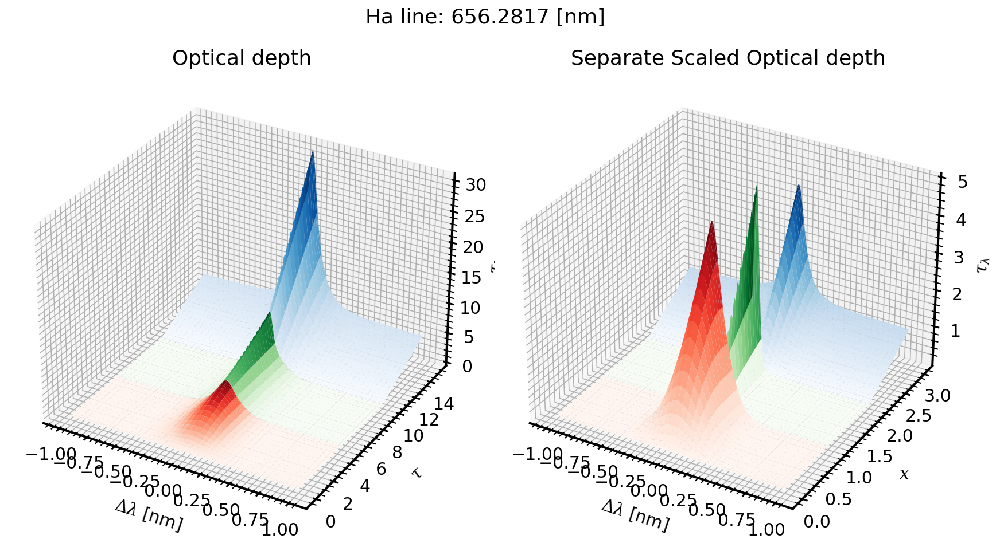

In [74]:
# optical depth figure
fig, ax = plt.subplots(1, 2, figsize=(12,7), subplot_kw={'projection':'3d'})
ax_kwargs1 = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$\tau$', 'zlabel':r'$\tau_\lambda$'}
ax_kwargs2 = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$x$', 'zlabel':r'$\tau_\lambda$'}

Y, X = np.meshgrid(wv_int_points, x_dots)

ax[0].plot_surface(Y, tau1*X, TL1, cmap='Reds')
ax[0].plot_surface(Y, tau1+tau2*X, TL1[-1,:]+TL2, cmap='Greens')
ax[0].plot_surface(Y, tau1+tau2+taup*X, TL1[-1,:]+TL2[-1,:]+TLp, cmap='Blues')

ax[0].set(**ax_kwargs1, title='Optical depth')
ax[0].set_xlabel(r'$\Delta\lambda$ [nm]', labelpad=10)
ax[0].set_ylabel(r'$\tau$', labelpad=10)

ax[1].plot_surface(Y, X, TL1, cmap='Reds')
ax[1].plot_surface(Y, 1+X, TL2, cmap='Greens')
ax[1].plot_surface(Y, 2+X, TLp/taup, cmap='Blues')

ax[1].set(**ax_kwargs2, title='Separate Scaled Optical depth')
# ax[1].Axis(labelpad=10)
ax[1].set_xlabel(r'$\Delta\lambda$ [nm]', labelpad=10)
ax[1].set_ylabel(r'$x$', labelpad=10)

plt.suptitle(f'{line} line: {line_center} [nm]')
plt.tight_layout()
plt.show()

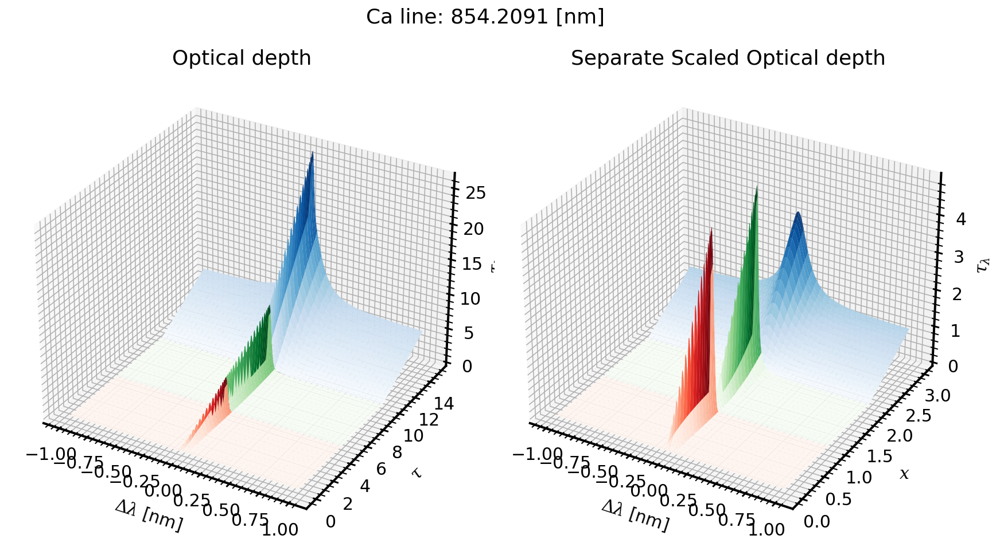

In [61]:
# optical depth figure
fig, ax = plt.subplots(1, 2, figsize=(12,7), subplot_kw={'projection':'3d'})
ax_kwargs1 = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$\tau$', 'zlabel':r'$\tau_\lambda$'}
ax_kwargs2 = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$x$', 'zlabel':r'$\tau_\lambda$'}

Y, X = np.meshgrid(wv_int_points, x_dots)

ax[0].plot_surface(Y, tau1*X, TL1, cmap='Reds')
ax[0].plot_surface(Y, tau1+tau2*X, TL1[-1,:]+TL2, cmap='Greens')
ax[0].plot_surface(Y, tau1+tau2+taup*X, TL1[-1,:]+TL2[-1,:]+TLp, cmap='Blues')

ax[0].set(**ax_kwargs1, title='Optical depth')
ax[0].set_xlabel(r'$\Delta\lambda$ [nm]', labelpad=10)
ax[0].set_ylabel(r'$\tau$', labelpad=10)

ax[1].plot_surface(Y, X, TL1, cmap='Reds')
ax[1].plot_surface(Y, 1+X, TL2, cmap='Greens')
ax[1].plot_surface(Y, 2+X, TLp/taup, cmap='Blues')

ax[1].set(**ax_kwargs2, title='Separate Scaled Optical depth')
# ax[1].Axis(labelpad=10)
ax[1].set_xlabel(r'$\Delta\lambda$ [nm]', labelpad=10)
ax[1].set_ylabel(r'$x$', labelpad=10)

plt.suptitle(f'{line} line: {line_center} [nm]')
plt.tight_layout()
plt.show()

### draw profile

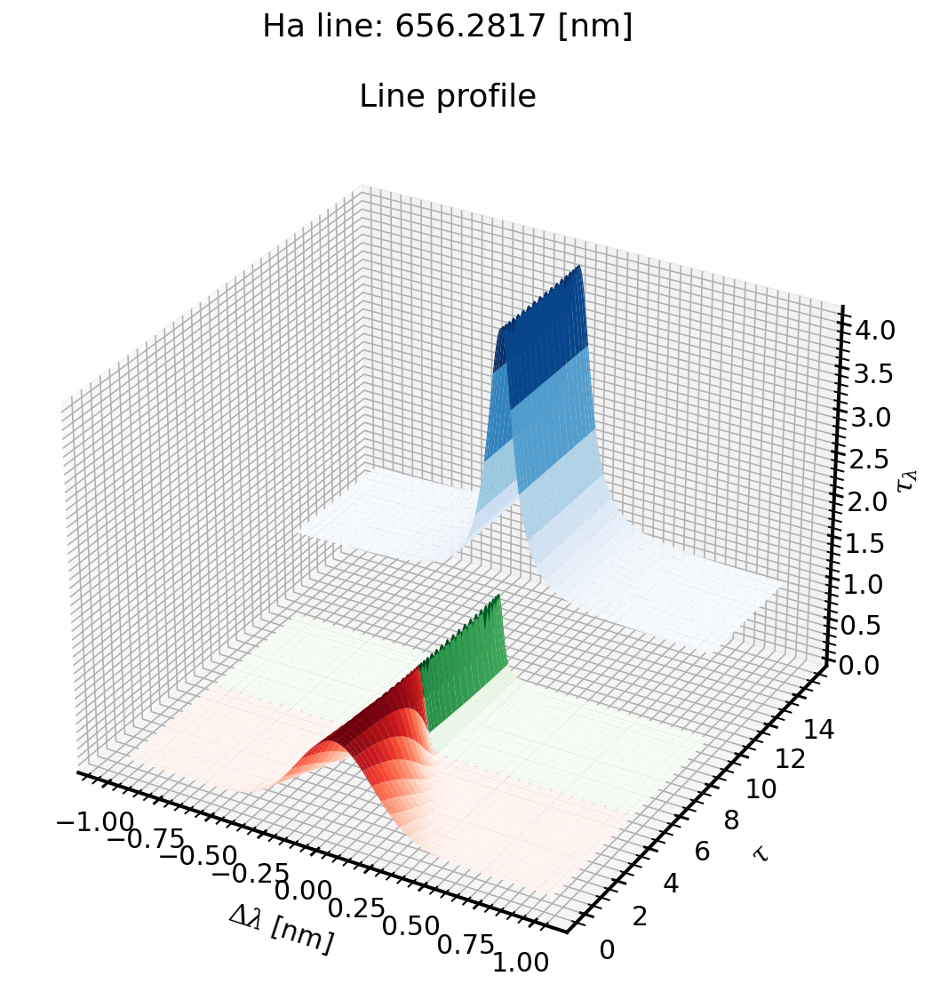

In [75]:
# optical depth figure
fig, ax = plt.subplots(figsize=(8,8), subplot_kw={'projection':'3d'})
ax_kwargs1 = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$\tau$', 'zlabel':r'$\tau_\lambda$'}
ax_kwargs2 = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$x$', 'zlabel':r'$\tau_\lambda$'}

Y, X = np.meshgrid(wv_int_points, x_points)

ax.plot_surface(Y, tau1*X, R1, cmap='Reds')
ax.plot_surface(Y, tau1+tau2*X, R2, cmap='Greens')
ax.plot_surface(Y, tau1+tau2+taup*X, Rp, cmap='Blues')

ax.set(**ax_kwargs1, title='Line profile')
ax.set_xlabel(r'$\Delta\lambda$ [nm]', labelpad=10)
ax.set_ylabel(r'$\tau$', labelpad=10)

plt.suptitle(f'{line} line: {line_center} [nm]')
plt.tight_layout()
plt.show()

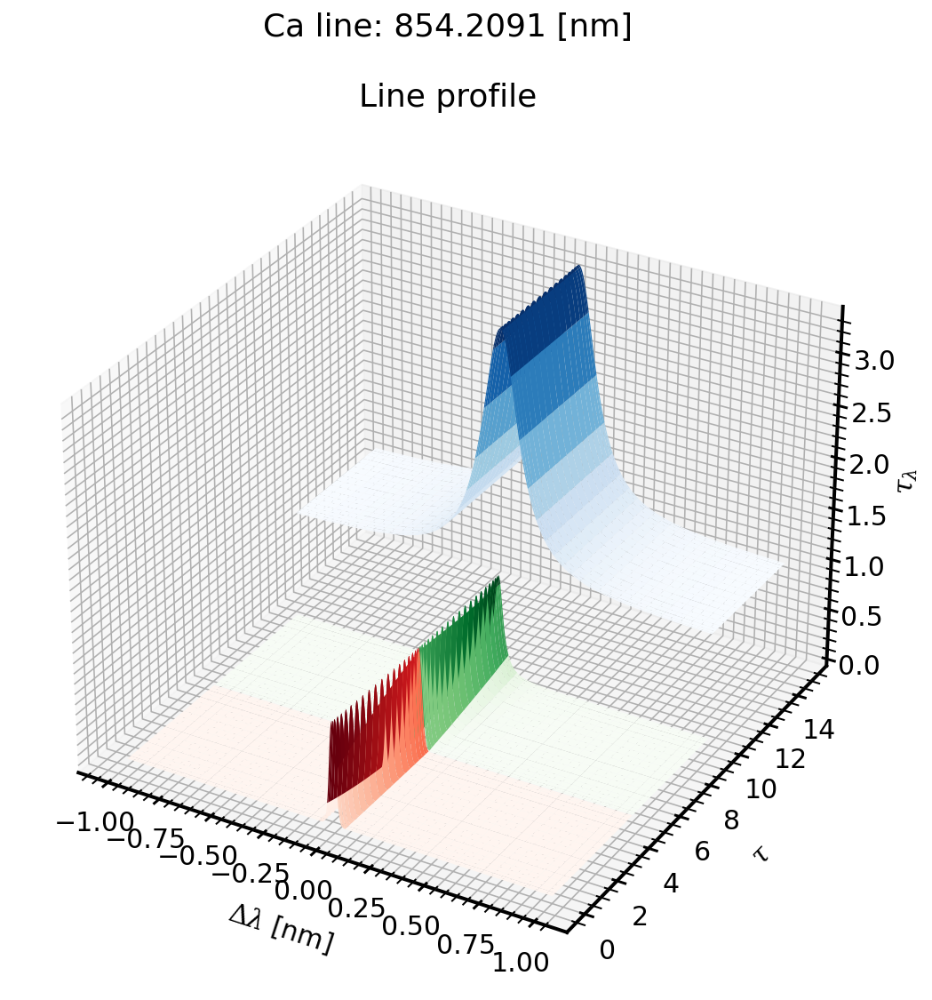

In [62]:
# optical depth figure
fig, ax = plt.subplots(figsize=(8,8), subplot_kw={'projection':'3d'})
ax_kwargs1 = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$\tau$', 'zlabel':r'$\tau_\lambda$'}
ax_kwargs2 = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$x$', 'zlabel':r'$\tau_\lambda$'}

Y, X = np.meshgrid(wv_int_points, x_points)

ax.plot_surface(Y, tau1*X, R1, cmap='Reds')
ax.plot_surface(Y, tau1+tau2*X, R2, cmap='Greens')
ax.plot_surface(Y, tau1+tau2+taup*X, Rp, cmap='Blues')

ax.set(**ax_kwargs1, title='Line profile')
ax.set_xlabel(r'$\Delta\lambda$ [nm]', labelpad=10)
ax.set_ylabel(r'$\tau$', labelpad=10)

plt.suptitle(f'{line} line: {line_center} [nm]')
plt.tight_layout()
plt.show()

### draw E2 function 

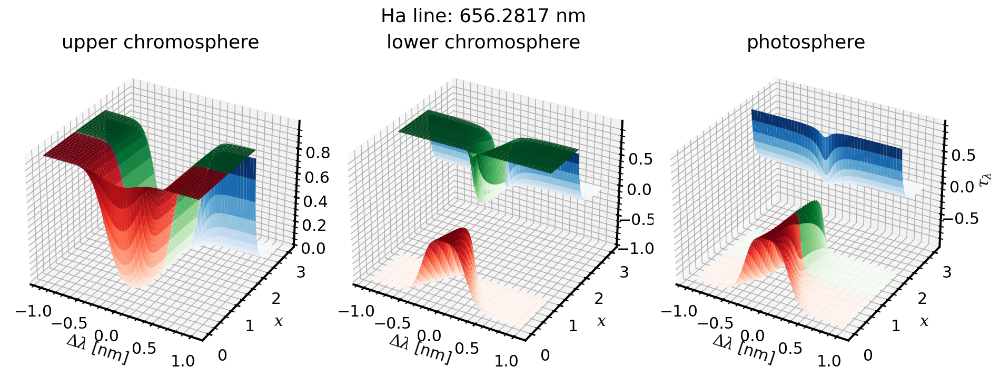

In [76]:
# kernel figure
fig, ax = plt.subplots(1, 3, figsize=(13,5), subplot_kw={'projection':'3d'})
ax_kwargs = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$x$', 'zlabel':r'$\tau_\lambda$'}

Y, X = np.meshgrid(wv_int_points, x_points)

ax[0].plot_surface(Y, X, k00, cmap='Reds')
ax[0].plot_surface(Y, 1+X, k01, cmap='Greens')
ax[0].plot_surface(Y, 2+X, k02, cmap='Blues')

ax[0].set(**ax_kwargs, title='upper chromosphere')

ax[1].plot_surface(Y, X, k10, cmap='Reds')
ax[1].plot_surface(Y, 1+X, k11, cmap='Greens')
ax[1].plot_surface(Y, 2+X, k12, cmap='Blues')

ax[1].set(**ax_kwargs, title='lower chromosphere')

ax[2].plot_surface(Y, X, k20, cmap='Reds')
ax[2].plot_surface(Y, 1+X, k21, cmap='Greens')
ax[2].plot_surface(Y, 2+X, k22, cmap='Blues')

ax[2].set(**ax_kwargs, title='photosphere')

plt.suptitle(f'{line} line: {line_center} nm')
plt.tight_layout()
plt.show()

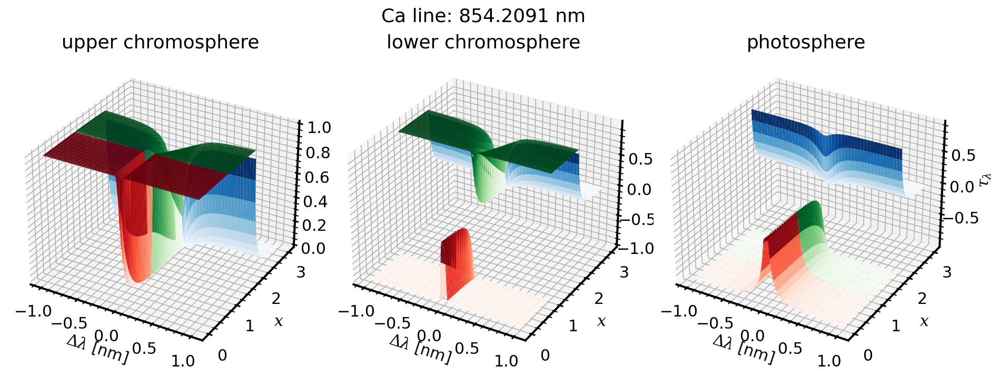

In [63]:
# kernel figure
fig, ax = plt.subplots(1, 3, figsize=(13,5), subplot_kw={'projection':'3d'})
ax_kwargs = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$x$', 'zlabel':r'$\tau_\lambda$'}

Y, X = np.meshgrid(wv_int_points, x_points)

ax[0].plot_surface(Y, X, k00, cmap='Reds')
ax[0].plot_surface(Y, 1+X, k01, cmap='Greens')
ax[0].plot_surface(Y, 2+X, k02, cmap='Blues')

ax[0].set(**ax_kwargs, title='upper chromosphere')

ax[1].plot_surface(Y, X, k10, cmap='Reds')
ax[1].plot_surface(Y, 1+X, k11, cmap='Greens')
ax[1].plot_surface(Y, 2+X, k12, cmap='Blues')

ax[1].set(**ax_kwargs, title='lower chromosphere')

ax[2].plot_surface(Y, X, k20, cmap='Reds')
ax[2].plot_surface(Y, 1+X, k21, cmap='Greens')
ax[2].plot_surface(Y, 2+X, k22, cmap='Blues')

ax[2].set(**ax_kwargs, title='photosphere')

plt.suptitle(f'{line} line: {line_center} nm')
plt.tight_layout()
plt.show()

### draw E2 function x profile

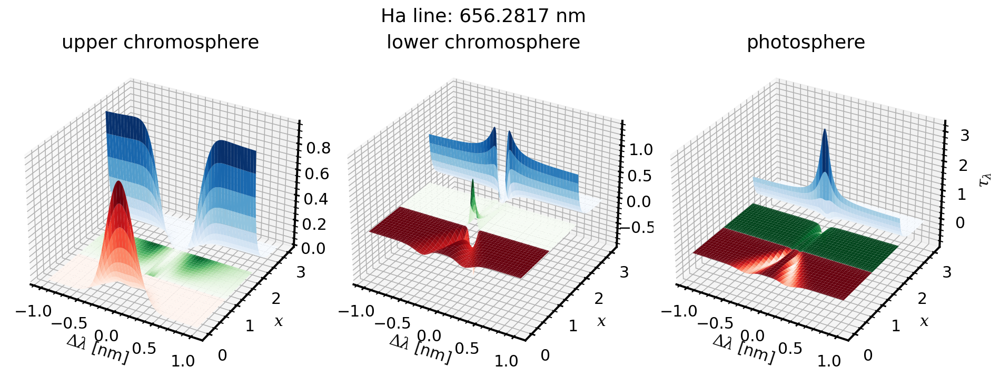

In [77]:
# kernel figure
fig, ax = plt.subplots(1, 3, figsize=(13,5), subplot_kw={'projection':'3d'})
ax_kwargs = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$x$', 'zlabel':r'$\tau_\lambda$'}

Y, X = np.meshgrid(wv_int_points, x_points)

ax[0].plot_surface(Y, X, k00*R1, cmap='Reds')
ax[0].plot_surface(Y, 1+X, k01*R2, cmap='Greens')
ax[0].plot_surface(Y, 2+X, k02*Rp, cmap='Blues')

ax[0].set(**ax_kwargs, title='upper chromosphere')

ax[1].plot_surface(Y, X, k10*R1, cmap='Reds')
ax[1].plot_surface(Y, 1+X, k11*R2, cmap='Greens')
ax[1].plot_surface(Y, 2+X, k12*Rp, cmap='Blues')

ax[1].set(**ax_kwargs, title='lower chromosphere')

ax[2].plot_surface(Y, X, k20*R1, cmap='Reds')
ax[2].plot_surface(Y, 1+X, k21*R2, cmap='Greens')
ax[2].plot_surface(Y, 2+X, k22*Rp, cmap='Blues')

ax[2].set(**ax_kwargs, title='photosphere')

plt.suptitle(f'{line} line: {line_center} nm')
plt.tight_layout()
plt.show()

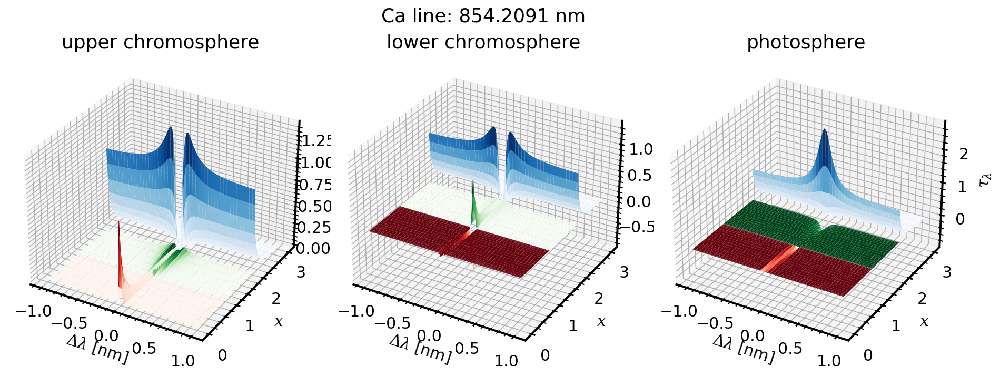

In [64]:
# kernel figure
fig, ax = plt.subplots(1, 3, figsize=(13,5), subplot_kw={'projection':'3d'})
ax_kwargs = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$x$', 'zlabel':r'$\tau_\lambda$'}

Y, X = np.meshgrid(wv_int_points, x_points)

ax[0].plot_surface(Y, X, k00*R1, cmap='Reds')
ax[0].plot_surface(Y, 1+X, k01*R2, cmap='Greens')
ax[0].plot_surface(Y, 2+X, k02*Rp, cmap='Blues')

ax[0].set(**ax_kwargs, title='upper chromosphere')

ax[1].plot_surface(Y, X, k10*R1, cmap='Reds')
ax[1].plot_surface(Y, 1+X, k11*R2, cmap='Greens')
ax[1].plot_surface(Y, 2+X, k12*Rp, cmap='Blues')

ax[1].set(**ax_kwargs, title='lower chromosphere')

ax[2].plot_surface(Y, X, k20*R1, cmap='Reds')
ax[2].plot_surface(Y, 1+X, k21*R2, cmap='Greens')
ax[2].plot_surface(Y, 2+X, k22*Rp, cmap='Blues')

ax[2].set(**ax_kwargs, title='photosphere')

plt.suptitle(f'{line} line: {line_center} nm')
plt.tight_layout()
plt.show()

### test - voigt profile normalization

In [65]:
# Dimensionless Line profiles
# r1 = lambda x, y: wofz(u(y,wv0 + (wv1-wv0)*x,w0 + (w1-w0)*x) + 1j*a1   ).real / wofz(1j*a1   ).real
# r2 = lambda x, y: wofz(u(y,wv1 + (wv2-wv1)*x,w1 + (w2-w1)*x) + 1j*a2(x)).real / wofz(1j*a2(x)).real
# rp = lambda    y: wofz(u(y,wvp              ,wp)             + 1j*ap   ).real / wofz(1j*ap   ).real * eta + 1

# Number of binning for applying Simpson's 3/8 rule
# wavelength integration range [nm], default bin size = 2nm
Ny = wv_int_size/wv_bin_size
if Ny%1 != 0:
    raise Exception('wv_bin_size is wrongly inputted...')
else:
    Ny = int(Ny)
Ny += 3 - Ny%3 + 1

print(wv_int_size)
print(wv_bin_size)
print(Ny)

wv_int_points = np.linspace(-wv_int_size/2, wv_int_size/2, Ny)
print(wv_int_points.shape)
print(wv_int_points)

wv_int_weights = 3 * np.ones(Ny)
index = np.arange(Ny)
wv_int_weights[index%3==0] = 2
wv_int_weights[0] = 1
wv_int_weights[-1] = 1
wv_int_weights = wv_int_weights * 3/8 * wv_bin_size
print(wv_int_weights.shape)
print(wv_int_weights)

voigt1 = np.array([[wofz(u(y,wv0 + (wv1-wv0)*x,w0 + (w1-w0)*x) + 1j*a1   ).real/(w0 + (w1-w0)*x)/np.sqrt(np.pi) for y in wv_int_points] for x in x_points])
voigt2 = np.array([[wofz(u(y,wv1 + (wv2-wv1)*x,w1 + (w2-w1)*x) + 1j*a2(x)).real/(w1 + (w2-w1)*x)/np.sqrt(np.pi) for y in wv_int_points] for x in x_points])
# Rp = np.array([[rp(  y) for y in wv_int_points] for x in x_points])
print(voigt1.shape)

norm1 = voigt1 @ wv_int_weights

2
0.002
1003
(1003,)
[-1.         -0.99800399 -0.99600798 ...  0.99600798  0.99800399
  1.        ]
(1003,)
[0.00075 0.00225 0.00225 ... 0.00225 0.00225 0.00075]
(21, 1003)


In [66]:
norm1

array([1.002, 1.002, 1.002, 1.002, 1.002, 1.002, 1.002, 1.002, 1.002,
       1.002, 1.002, 1.002, 1.002, 1.002, 1.002, 1.002, 1.002, 1.002,
       1.002, 1.002, 1.002])

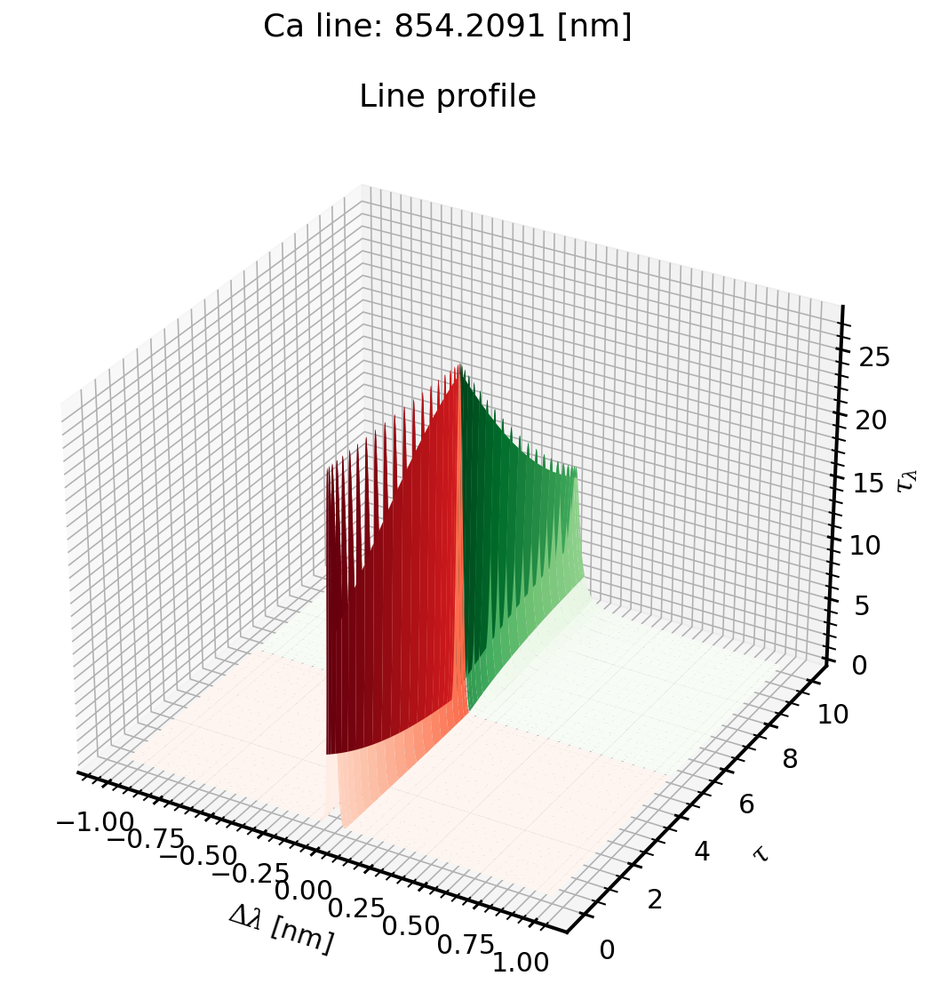

In [67]:
# optical depth figure
fig, ax = plt.subplots(figsize=(8,8), subplot_kw={'projection':'3d'})
ax_kwargs1 = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$\tau$', 'zlabel':r'$\tau_\lambda$'}
ax_kwargs2 = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$x$', 'zlabel':r'$\tau_\lambda$'}

Y, X = np.meshgrid(wv_int_points, x_points)

ax.plot_surface(Y, tau1*X, voigt1, cmap='Reds')
ax.plot_surface(Y, tau1+tau2*X, voigt2, cmap='Greens')
# ax.plot_surface(Y, tau1+tau2+taup*X, Rp, cmap='Blues')

ax.set(**ax_kwargs1, title='Line profile')
ax.set_xlabel(r'$\Delta\lambda$ [nm]', labelpad=10)
ax.set_ylabel(r'$\tau$', labelpad=10)

plt.suptitle(f'{line} line: {line_center} [nm]')
plt.tight_layout()
plt.show()

### draw flux density

In [78]:
ss1 = np.repeat(Sx1[:,np.newaxis], 1003, axis=1)

In [79]:
ss2 = np.repeat(Sx2[:,np.newaxis], 1003, axis=1)

In [80]:
ss3 = np.repeat(Sx3[:,np.newaxis], 1003, axis=1)

In [54]:
ss1.shape

(21, 1003)

In [55]:
k00.shape

(21, 1003)

In [56]:
R1.shape

(21, 1003)

In [21]:
ss1[:,0] == Sx1

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True])

In [41]:
ss1 * k00

array([[0.00234319, 0.00234319, 0.00234319, ..., 0.00234319, 0.00234319,
        0.00234319],
       [0.00545619, 0.00545619, 0.00545619, ..., 0.00545619, 0.00545619,
        0.00545619],
       [0.00857336, 0.00857336, 0.00857336, ..., 0.00857336, 0.00857336,
        0.00857336],
       ...,
       [0.01369948, 0.01369948, 0.01369948, ..., 0.01369948, 0.01369948,
        0.01369948],
       [0.00894152, 0.00894152, 0.00894152, ..., 0.00894152, 0.00894152,
        0.00894152],
       [0.0038953 , 0.0038953 , 0.0038953 , ..., 0.0038953 , 0.0038953 ,
        0.0038953 ]])

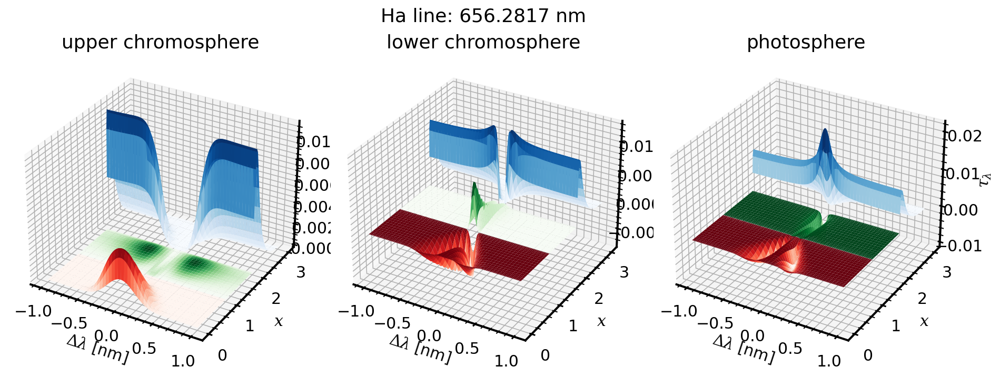

In [81]:
# kernel figure
fig, ax = plt.subplots(1, 3, figsize=(13,5), subplot_kw={'projection':'3d'})
ax_kwargs = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$x$', 'zlabel':r'$\tau_\lambda$'}

Y, X = np.meshgrid(wv_int_points, x_points)

ax[0].plot_surface(Y, X, ss1*k00*R1, cmap='Reds')
ax[0].plot_surface(Y, 1+X, ss2*k01*R2, cmap='Greens')
ax[0].plot_surface(Y, 2+X, ss3*k02*Rp, cmap='Blues')

ax[0].set(**ax_kwargs, title='upper chromosphere')

ax[1].plot_surface(Y, X, ss1*k10*R1, cmap='Reds')
ax[1].plot_surface(Y, 1+X, ss2*k11*R2, cmap='Greens')
ax[1].plot_surface(Y, 2+X, ss3*k12*Rp, cmap='Blues')

ax[1].set(**ax_kwargs, title='lower chromosphere')

ax[2].plot_surface(Y, X, ss1*k20*R1, cmap='Reds')
ax[2].plot_surface(Y, 1+X, ss2*k21*R2, cmap='Greens')
ax[2].plot_surface(Y, 2+X, ss3*k22*Rp, cmap='Blues')

ax[2].set(**ax_kwargs, title='photosphere')

plt.suptitle(f'{line} line: {line_center} nm')
plt.tight_layout()
plt.show()

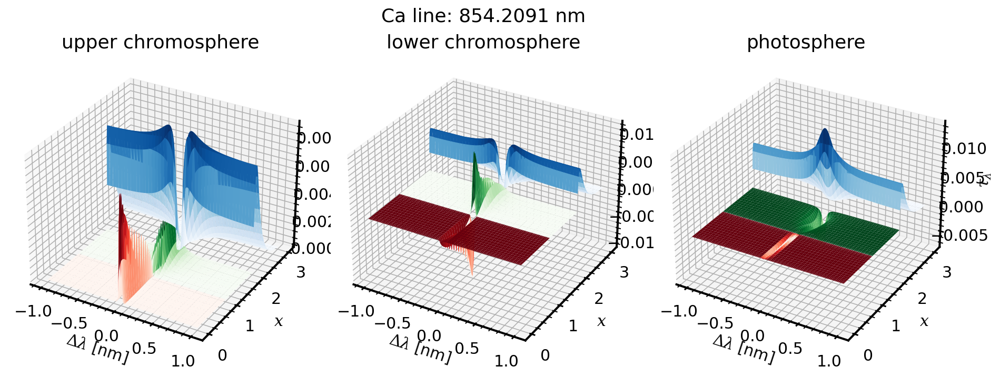

In [71]:
# kernel figure
fig, ax = plt.subplots(1, 3, figsize=(13,5), subplot_kw={'projection':'3d'})
ax_kwargs = {'xlabel':r'$\Delta\lambda$ [nm]', 'ylabel':r'$x$', 'zlabel':r'$\tau_\lambda$'}

Y, X = np.meshgrid(wv_int_points, x_points)

ax[0].plot_surface(Y, X, ss1*k00*R1, cmap='Reds')
ax[0].plot_surface(Y, 1+X, ss2*k01*R2, cmap='Greens')
ax[0].plot_surface(Y, 2+X, ss3*k02*Rp, cmap='Blues')

ax[0].set(**ax_kwargs, title='upper chromosphere')

ax[1].plot_surface(Y, X, ss1*k10*R1, cmap='Reds')
ax[1].plot_surface(Y, 1+X, ss2*k11*R2, cmap='Greens')
ax[1].plot_surface(Y, 2+X, ss3*k12*Rp, cmap='Blues')

ax[1].set(**ax_kwargs, title='lower chromosphere')

ax[2].plot_surface(Y, X, ss1*k20*R1, cmap='Reds')
ax[2].plot_surface(Y, 1+X, ss2*k21*R2, cmap='Greens')
ax[2].plot_surface(Y, 2+X, ss3*k22*Rp, cmap='Blues')

ax[2].set(**ax_kwargs, title='photosphere')

plt.suptitle(f'{line} line: {line_center} nm')
plt.tight_layout()
plt.show()

### wavelength-calc. time test

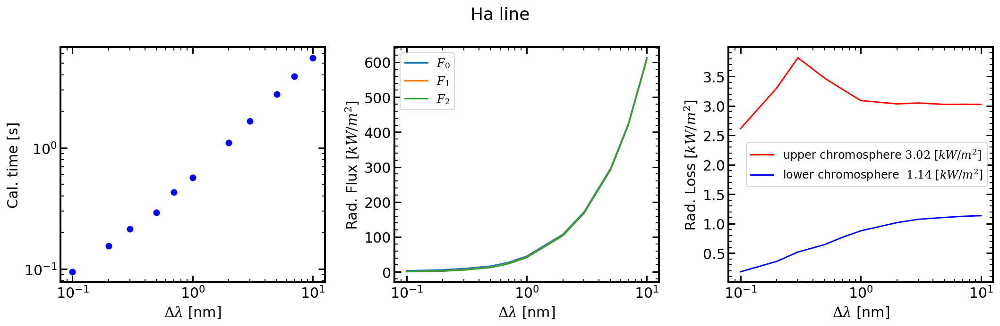

In [35]:
plot_wvtest(parHa, 'Ha')

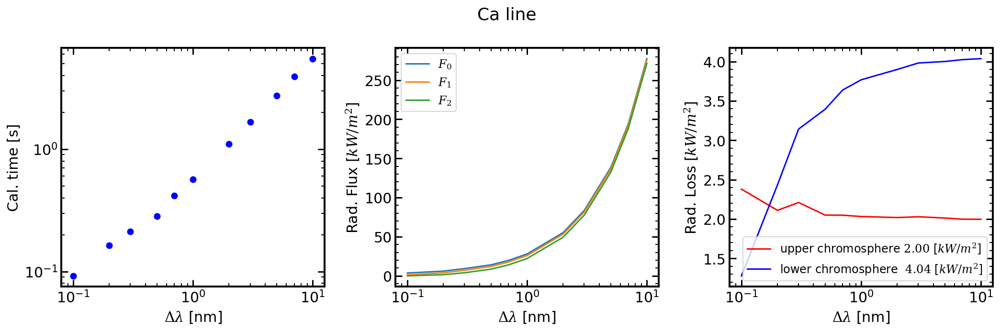

In [36]:
plot_wvtest(parCa, 'Ca')

In [34]:
def plot_wvtest(pars, line):
    wv_int_sizes = [0.1, 0.15, 0.2, 0.3, 0.5, 0.7, 1, 1.5, 2, 3, 5, 7, 10] 

    calc_times = []
    flux = []
    flux0, flux1, flux2 = [], [], []
    radloss1, radloss2 = [], []

    for wv_int_size in list_wv_int_size:
        t1 = time()
        results = flux_calculator2(pars, line, wv_int_size=wv_int_size, wv_bin_size=0.01)
        t2 = time()

        calc_times.append(t2-t1)
        flux.append(results[0])
        flux0.append(results[1])
        flux1.append(results[2])
        flux2.append(results[3])
        radloss1.append(results[4])
        radloss2.append(results[5])
    
    fig, ax = plt.subplots(1,3, figsize=(15,5))

    ax[0].plot(wv_int_sizes, calc_times, 'bo')
    ax[0].set(xlabel=r'$\Delta\lambda$ [nm]', ylabel='Cal. time [s]', xscale='log', yscale='log')

    ax[1].plot(wv_int_sizes, flux0, label=r'$F_0$')
    ax[1].plot(wv_int_sizes, flux1, label=r'$F_1$')
    ax[1].plot(wv_int_sizes, flux2, label=r'$F_2$')
    ax[1].set(xlabel=r'$\Delta\lambda$ [nm]', ylabel=r'Rad. Flux [$kW/m^2$]', xscale='log')
    ax[1].legend()
    
    ax[2].plot(wv_int_sizes, radloss1, color='red', label=rf'upper chromosphere ${radloss1[-1]:.2f}$ [$kW/m^2$]')
    ax[2].plot(wv_int_sizes, radloss2, color='blue', label=rf'lower chromosphere  ${radloss2[-1]:.2f}$ [$kW/m^2$]')
    ax[2].set(xlabel=r'$\Delta\lambda$ [nm]', ylabel=r'Rad. Loss [$kW/m^2$]', xscale='log')
    ax[2].legend()
    
    plt.suptitle(f'{line} line')
    plt.tight_layout()
    #plt.savefig('.pdf', format='pdf', dpi=500)
    plt.show()

### nx, ny test

In [30]:
# Calculation Time depending on epsabs/epsrel
def plot_ntest(pars, line='Ha'):
    nxs = [3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 15]
    nys = [10, 12, 14, 16, 18, 20, 24, 30, 40, 50]
    caltime = []
    frs, errs = [], []

    for nx in nxs:
        t1 = time()
        fr, err = flux_calculator(pars, line=line, int_bin_size=1.2, calc_opt='flux_sum', nx=nx, ny=30)
        t2 = time()
    #     print('done')

        caltime.append(t2-t1)
        frs.append(fr)
        

    frs = np.array(frs)
    
    fig, ax = plt.subplots(2,3, figsize=(15,9))

    ax[0,0].plot(nxs, caltime, 'bo')
    ax[0,0].set(xlabel='Nx', ylabel='Cal. time [s]')

    ax[0,1].plot(nxs, frs[:,0])
    ax[0,1].plot(nxs, frs[:,1])
    ax[0,1].plot(nxs, frs[:,2])
    ax[0,1].set(xlabel='Nx', ylabel=r'Rad. Flux [$kW/m^2$]')

    ax[0,2].plot(nxs[:-1], abs(frs[:,0]/frs[-1,0]-1)[:-1], label=rf'$F_0$ = {frs[-1,0]:.3f} $[kW/m^2]$')
    ax[0,2].plot(nxs[:-1], abs(frs[:,1]/frs[-1,1]-1)[:-1], label=rf'$F_1$ = {frs[-1,1]:.3f} $[kW/m^2]$')
    ax[0,2].plot(nxs[:-1], abs(frs[:,2]/frs[-1,2]-1)[:-1], label=rf'$F_2$ = {frs[-1,2]:.3f} $[kW/m^2]$')
    ax[0,2].set(xlabel='Nx', ylabel='Relative error')
    ax[0,2].legend()
    
    frs = []
    caltime = []
    for ny in nys:
        t1 = time()
        fr, err = flux_calculator(pars, line=line, int_bin_size=1.2, calc_opt='flux_sum', nx=11, ny=ny)
        t2 = time()
    #     print('done')

        caltime.append(t2-t1)
        frs.append(fr)
        
    frs = np.array(frs)

    ax[1,0].plot(nys, caltime, 'bo')
    ax[1,0].set(xlabel='Ny', ylabel='Cal. time [s]')

    ax[1,1].plot(nys, frs[:,0])
    ax[1,1].plot(nys, frs[:,1])
    ax[1,1].plot(nys, frs[:,2])
    ax[1,1].set(xlabel='Ny', ylabel=r'Rad. Flux [$kW/m^2$]')

    ax[1,2].plot(nys[:-1], abs(frs[:,0]/frs[-1,0]-1)[:-1], label=rf'$F_0$ = {frs[-1,0]:.3f} $[kW/m^2]$')
    ax[1,2].plot(nys[:-1], abs(frs[:,1]/frs[-1,1]-1)[:-1], label=rf'$F_1$ = {frs[-1,1]:.3f} $[kW/m^2]$')
    ax[1,2].plot(nys[:-1], abs(frs[:,2]/frs[-1,2]-1)[:-1], label=rf'$F_2$ = {frs[-1,2]:.3f} $[kW/m^2]$')
    ax[1,2].set(xlabel='Ny', ylabel='Relative error')
    ax[1,2].legend()

    plt.suptitle(f'{line} line: $\Delta\lambda$ = 1.2 nm')
    plt.tight_layout()
    #plt.savefig('.pdf', format='pdf', dpi=500)
    plt.show()

wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral range = [655.6817, 656.8817]
wavelength integral 

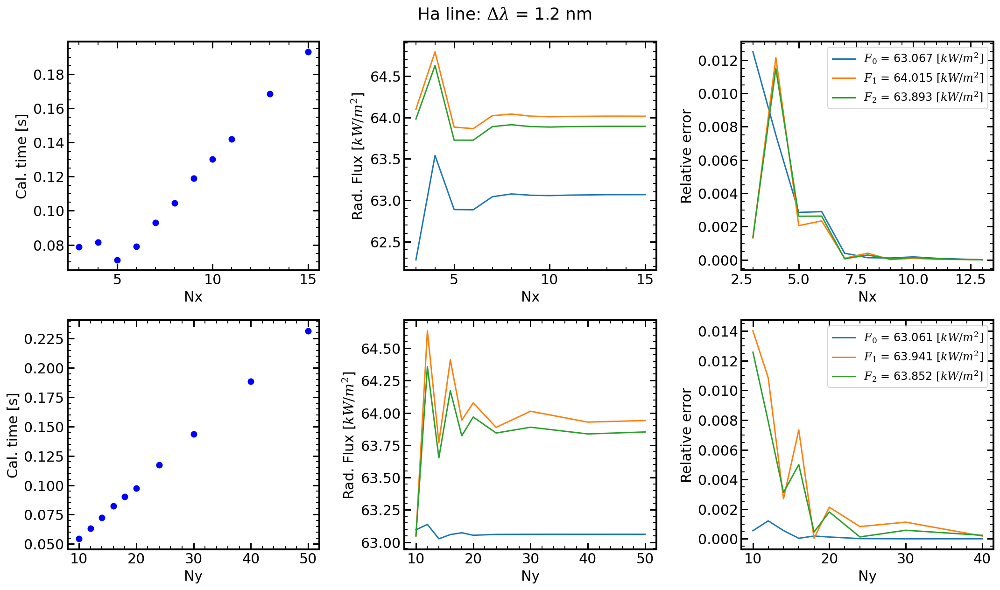

In [31]:
plot_ntest(parHa, line='Ha')

wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength integral range = [853.6091, 854.8091000000001]
wavelength int

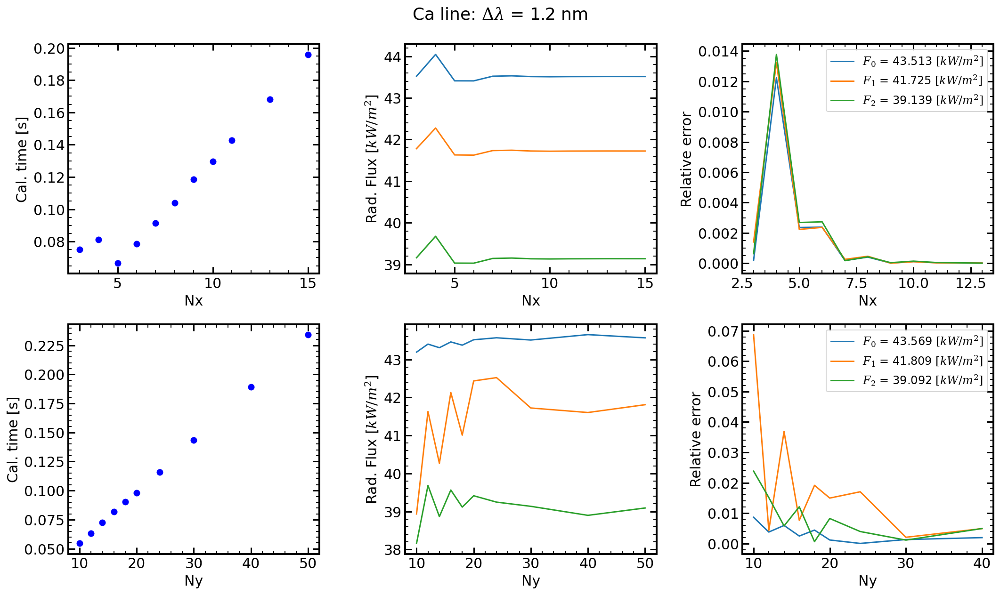

In [32]:
plot_ntest(parCa, line='Ca')

### dlint

In [15]:
def dlint(func, int_range, nx=7, ny=20):
    result = 0
    n_x = nx
    n_y = ny
    
    xs, ws = np.polynomial.legendre.leggauss(deg=n_x)
    xs = xs/2 + 0.5
    ws = ws/2
    
    if n_y % 2 == 1:
        raise ValueError("N must be an even integer.")
    ys = np.linspace(int_range[1][0], int_range[1][1], n_y+1)
    dy = (int_range[1][1]-int_range[1][0])/n_y
#     print(xs)
#     print(ys)
    
    for x, w in zip(xs, ws):
        f = [w*func(x,y) for y in ys]
#         print(f)
    
        result += dy/3 * np.sum(f[0:-1:2] + 4*f[1::2] + f[2::2])
    
    return result

In [8]:
%time dlint(lambda x, y: x, [[0,1],[-1,1]])

CPU times: user 1.2 ms, sys: 21 µs, total: 1.22 ms
Wall time: 1.14 ms


1.0

In [ ]:
b

## Test

### Ha test

In [24]:
%time flux_calculator(parHa, line='Ha', int_bin_size=1.2, epsrel=1e-3, calc_opt='flux_each')

4.999351468552971
4.998681988492293
4.106318224671674
wavelength integral range = [655.6817, 656.8817]
CPU times: user 1.37 s, sys: 989 µs, total: 1.38 s
Wall time: 1.38 s


(array([[ 15.01400171,   9.92228986,  34.51849389],
        [-18.20160594,  30.76269207,  42.90640763],
        [ -3.46713703, -33.33222354,  84.67927642]]),
 array([[0.01781117, 0.00365431, 0.00202731],
        [0.03364809, 0.0428331 , 0.01131241],
        [0.00012902, 0.04969677, 0.05401473]]))

In [25]:
%time flux_calculator(parHa, line='Ha', int_bin_size=1.2, epsrel=1e-3, calc_opt='diff_sum')

4.999351468552971
4.998681988492293
4.106318224671674
wavelength integral range = [655.6817, 656.8817]
CPU times: user 2.17 s, sys: 0 ns, total: 2.17 s
Wall time: 2.17 s


(array([3.98728603, 7.58756437]), array([0.11192846, 0.16902146]))

In [35]:
%time flux_calculator2(parHa, line='Ha', int_bin_size=1.2, calc_opt='flux_each')

wavelength integral range = [655.6817, 656.8817]
CPU times: user 182 ms, sys: 1.01 ms, total: 183 ms
Wall time: 183 ms


array([[ 15.00835417,   0.37806868,  47.67488667],
       [-18.20001574,   7.24578331,  74.96677512],
       [-12.61961502,  -8.16298221,  84.67165153]])

In [33]:
%time flux_calculator2(parHa, line='Ha', int_bin_size=1.2, calc_opt='diff_sum')

wavelength integral range = [655.6817, 656.8817]
CPU times: user 183 ms, sys: 0 ns, total: 183 ms
Wall time: 182 ms


array([-0.95123317,  0.12348839])

In [6]:
import fissprocinv

In [12]:
%time fissprocinv.ThreeLayerRadLoss(parHa, line='Ha')

CPU times: user 1.87 ms, sys: 0 ns, total: 1.87 ms
Wall time: 1.75 ms


(20.99883234680857, 8.686580575786696)

In [13]:
db.parHa.shape

(17, 250, 150)

In [17]:
flux_Ha = np.zeros((3,250,150))
for i in range(250):
    for j in range(150):
        flux_Ha[:2,i,j] = fissprocinv.ThreeLayerRadLoss(db.parHa[:,i,j], line='Ha')
        flux_Ha[2,i,j] = flux_Ha[:2,i,j].sum()

In [20]:
flux_Ha.shape

(3, 250, 150)

In [18]:
def flux_hist_plot(flux, line='Ha', save=False):
    fig, ax = plt.subplots(1,2, figsize=(15,7))

    nlayer, nx, ny = flux.shape
    hist_kwargs = {'bins':100, 'histtype':'step', 'density':True}

    for i in range(nlayer):
        ax[0].hist(flux[i,:,:].reshape(-1), **hist_kwargs, label=rf'$F_{i}$')
        
    ax[0].set(xlabel=r'Radiative Flux [$kW/m^2$]', ylabel='Probability density')
    ax[0].legend()

    ax[1].hist((flux[0,:,:]-flux[1,:,:]).reshape(-1), label=r'upper chromosphere, $F_0-F_1$', **hist_kwargs)
    ax[1].hist((flux[1,:,:]-flux[2,:,:]).reshape(-1), label=r'lower chromosphere, $F_1-F_2$', **hist_kwargs)
    ax[1].hist((flux[0,:,:]-flux[2,:,:]).reshape(-1), label=r'whole chormosphere, $F_0-F_2$', **hist_kwargs)

    ax[1].set(xlabel=r'Radiative Loss [$kW/m^2$]', ylabel='Probability density')
    ax[1].legend()

    fig.suptitle(f'Flux Histogram of {line} line', fontsize=20)
    plt.tight_layout()
    
    if save:
        plt.savefig(f'Flux_hist_{line}_{save}.png', dpi=300)
        plt.close(fig)
    else:
        plt.show()

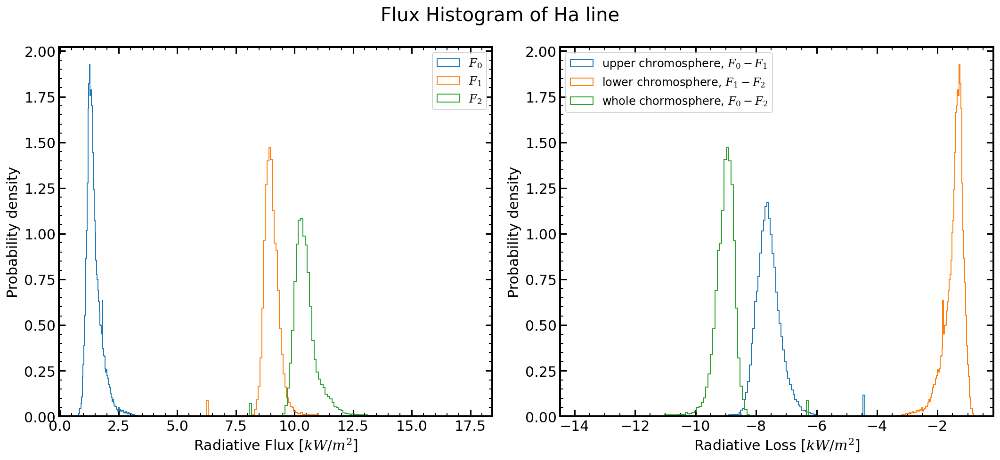

In [21]:
flux_hist_plot(flux_Ha, line='Ha')

In [48]:
def flux_map_plot(flux, line='Ha', vbin=None, cmap=None, which='both', save=False):
    # extent: pixel to physical dimesion conversion [Mm]
    nlayer, ny, nx  = flux.shape
    extent = np.array([-nx/2., nx/2., -ny/2., ny/2.])*0.16*0.725
    
    # figure configuration
    if nx==150:
        figwidth = 9
    elif nx==250:
        figwidth = 13
    else:
        raise NameError('Different fig size inputted!')
        
    if which=='both':
        rows, figheight = 2, 8
    elif which=='flux' or which=='diff' :
        rows, figheight = 1, 4
    else:
        raise NameError('Wrong map inputted!')
    fig, ax = plt.subplots(rows,3, figsize=(figwidth, figheight))
    
    # colormap
    if cmap is None:
        if line=='Ha':
            cmap = fisscmap.ha
        elif line=='Ca':
            cmap = fisscmap.ca
    
    # colorbar range
    if vbin is None:
        if line=='Ha':
            vbin = [(70, 140), (0,3), (8,14)]
        elif line=='Ca':
            vbin = [(45, 90), (0,3), (3,9)]
    
    # keywarguments
    fm_kwargs = {'cmap':cmap, 'norm':colors.Normalize(vmin=vbin[0][0], vmax=vbin[0][1]), 
                  'interpolation':'nearest', 'extent':extent, 'origin':'lower'}
    fdm0_kwargs = {'cmap':'inferno', 'norm':colors.Normalize(vmin=vbin[1][0], vmax=vbin[1][1]), 
                  'interpolation':'nearest', 'extent':extent, 'origin':'lower'}
    fdm1_kwargs = {'cmap':'inferno', 'norm':colors.Normalize(vmin=0, vmax=9), 
                  'interpolation':'nearest', 'extent':extent, 'origin':'lower'}
    fdm2_kwargs = {'cmap':'inferno', 'norm':colors.Normalize(vmin=vbin[2][0], vmax=vbin[2][1]), 
                  'interpolation':'nearest', 'extent':extent, 'origin':'lower'}
    
    # flux map
    if which=='both':
        axes = ax[0,:]
    elif which=='flux':
        axes = ax
        
    if which=='both' or which=='flux':
        for i in range(nlayer):
            im = axes[i].imshow(flux[i,:,:], **fm_kwargs)
        
            divider = make_axes_locatable(axes[i])
            cax = divider.append_axes('right', size=0.2, pad=0.1)
            cb = fig.colorbar(im, cax=cax)
            cb.set_label(r'Radiative Flux [$kW/m^2$]')
            if i!=2:
                 cb.remove()
    
        axes[0].set(title=r'$F_0$', ylabel='Solar Y [Mm]')
        axes[1].set(title=r'$F_1$')
        axes[2].set(title=r'$F_2$')
    
        plt.setp(axes[1].get_yticklabels(), visible=False)
        plt.setp(axes[2].get_yticklabels(), visible=False)
    
    # flux difference map
    if which=='both':
        axes = ax[1,:]
    elif which=='diff':
        axes = ax
    
    if which=='both' or which=='diff':
        for i in range(nlayer):
            if i==0:
                fdm_kwargs = fdm0_kwargs
            elif i==1:
                fdm_kwargs = fdm1_kwargs
            else:
                fdm_kwargs = fdm2_kwargs
#             top, bot = i%2, (i+1)//2+1
#             im = axes[i].imshow(flux[top,:,:]-flux[bot,:,:], **fdm_kwargs)
            im = axes[i].imshow(flux[i,:,:], **fdm_kwargs)
        
            divider = make_axes_locatable(axes[i])
            cax = divider.append_axes('right', size=0.2, pad=0.1)
            cb = fig.colorbar(im, cax=cax)
            if i==2:
                cb.set_label(r'Radiative Loss [$kW/m^2$]')
#             if i==1:
#                 cb.remove()
    
        axes[0].set(title=r'upper, $F_0-F_1$', ylabel='Solar Y [Mm]')
        axes[1].set(title=r'lower, $F_1-F_2$')
        axes[2].set(title=r'whole, $F_0-F_2$')
    
        plt.setp(axes[1].get_yticklabels(), visible=False)
        plt.setp(axes[2].get_yticklabels(), visible=False)
    
    fig.suptitle(f'Flux map of {line} line', fontsize=20)
    plt.tight_layout()
    
    if save:
        plt.savefig(f'Flux_map_20170614/flux_map_{line}_{save}.png', dpi=300)
        plt.close(fig)
    else:
        plt.show()

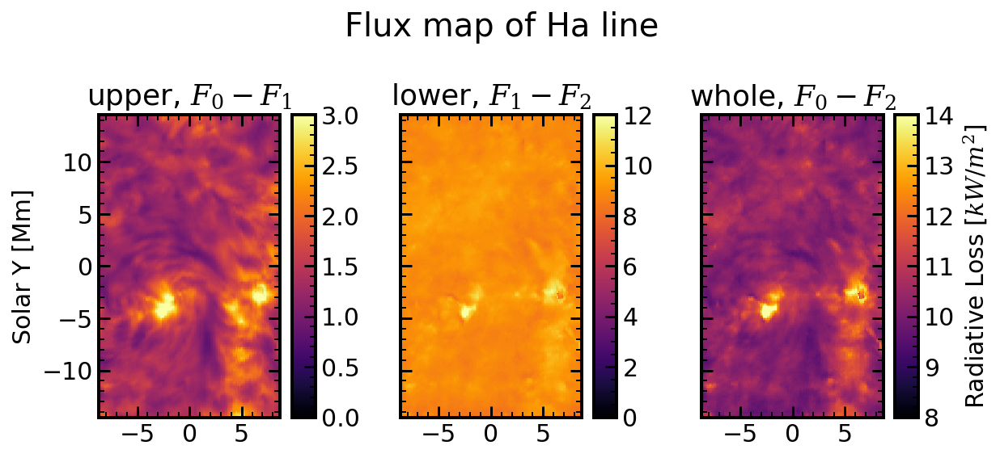

In [44]:
flux_map_plot(flux_Ha, line='Ha', which='diff')

In [45]:
flux_Ca = np.zeros((3,250,150))
for i in range(250):
    for j in range(150):
        flux_Ca[:2,i,j] = fissprocinv.ThreeLayerRadLoss(db.parCa[:,i,j], line='Ca')
        flux_Ca[2,i,j] = flux_Ca[:2,i,j].sum()

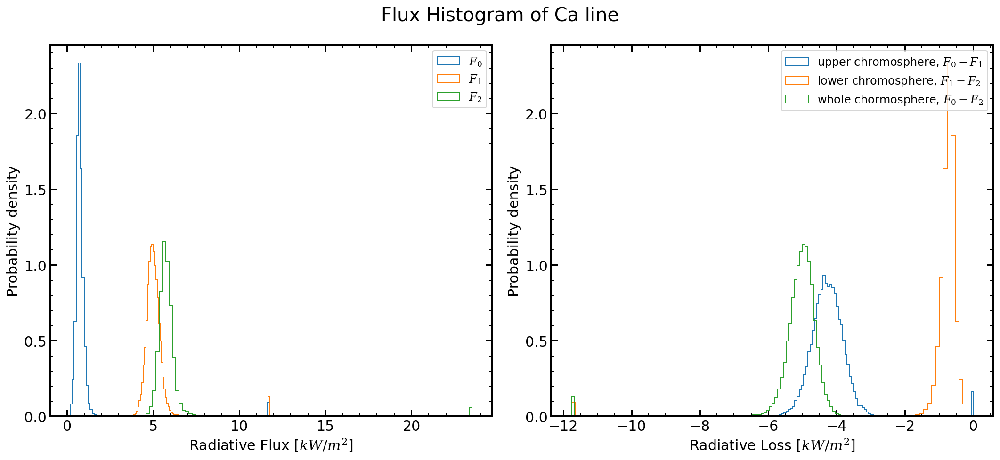

In [46]:
flux_hist_plot(flux_Ca, line='Ca')

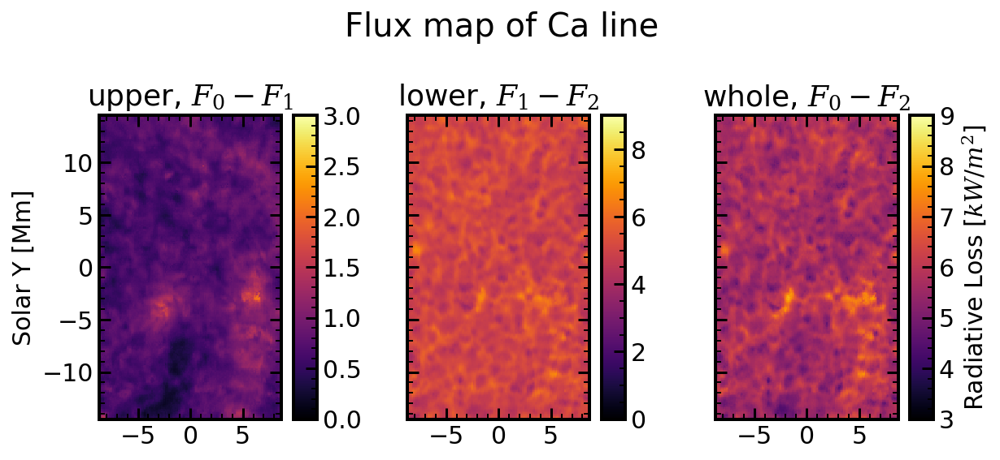

In [49]:
flux_map_plot(flux_Ca, line='Ca', which='diff')

### Ca II test

In [38]:
%time flux_calculator(parCa, line='Ca', int_bin_size=1.2, epsrel=1e-3, calc_opt='flux_each')

4.690171147570076
4.9946466598405115
3.3655179495831433
wavelength integral range = [853.6091, 854.8091000000001]
CPU times: user 2.38 s, sys: 0 ns, total: 2.38 s
Wall time: 2.38 s


(array([[ 1.86760966e+00,  2.04098424e+01,  1.88706757e+01],
        [-2.26016084e+00,  2.27201749e+01,  1.88768125e+01],
        [-6.73223197e-03, -1.95439143e+01,  4.36800461e+01]]),
 array([[2.59565590e-02, 1.84518148e-03, 1.05016802e-02],
        [3.01236761e-02, 1.45302984e-02, 3.13043998e-03],
        [2.97002010e-06, 1.93763148e-02, 3.66469736e-02]]))

In [40]:
%time flux_calculator(parCa, line='Ca', int_bin_size=1.2, epsrel=1e-3, calc_opt='diff_sum')

4.690171147570076
4.9946466598405115
3.3655179495831433
wavelength integral range = [853.6091, 854.8091000000001]
CPU times: user 4.33 s, sys: 0 ns, total: 4.33 s
Wall time: 4.33 s


(array([ 1.81124643, 15.20741327]), array([0.0828967 , 0.11261015]))

In [41]:
%time flux_calculator2(parCa, line='Ca', int_bin_size=1.2, calc_opt='flux_each')

wavelength integral range = [853.6091, 854.8091000000001]
CPU times: user 143 ms, sys: 992 µs, total: 144 ms
Wall time: 143 ms


array([[ 1.78067034,  2.97653817, 38.75409105],
       [-2.26375343,  5.14679806, 38.84034898],
       [-0.09052088, -4.44953473, 43.67660686]])

In [42]:
%time flux_calculator2(parCa, line='Ca', int_bin_size=1.2, calc_opt='diff_sum')

wavelength integral range = [853.6091, 854.8091000000001]
CPU times: user 242 ms, sys: 7 µs, total: 242 ms
Wall time: 241 ms


array([1.78790595, 2.58684236])

In [43]:
%time fissprocinv.ThreeLayerRadLoss(parCa, line='Ca')

CPU times: user 4.66 ms, sys: 0 ns, total: 4.66 ms
Wall time: 4.32 ms


(1.8323729957663206, 6.43189422505472)

# Flux Calculator (old)
---
## Flux Calculator ver.1
Exact calculation based on the double integraion.

In [2]:
def flux_calculator(pars, line='Ha', epsabs=1.49e-8, epsrel=1.49e-8, int_bin_size=1, calc_option='bundle'):
    e2 = lambda x: special.expn(2,x)
    
    # [S] = ?
    S0 = 10**pars[13]
    S1 = 10**pars[12]
    S2 = 10**pars[5]
    Sp = 10**pars[4]

    s1 = lambda x: S0 + (-3*S0+4*S1-S2)/2 * x + (S0-2*S1+S2)/2 * x**2
    s2 = lambda x: S1 + (-S0+S2)/2 * x        + (S0-2*S1+S2)/2 * x**2
    s3 = lambda x: S2 + (Sp-S2) * x

    # [v] = km/s, [w] = nm, [a]&[eta]&[tau] = None
    v1 = pars[9]
    w1 = 10**(pars[11]-1)
    a1 = 0.0
    
    v2 = pars[8]
    w2 = 10**(pars[10]-1)
    a2 = 0.3
    
    vp = pars[0]
    wp = 10**(pars[2]-1)
    ap = 10**pars[3]
    eta = 10**pars[1]
    
    tau = 5.0
    c = 3e5 # km/s
    
    # different parameters of given line
    if line == 'Ha':
        wv0 = 656.3 # nm
        factor = 28.5/1.05 # kW m-2 sr-1 nm-1
    elif line == 'Ca':
        wv0 = 854.2 # nm
        factor = 17.6/1.05 # kW m-2 sr-1 nm-1
    else:
        raise NameError('Wrong line inputting.')
        
    # integration range [nm], default bin size = 1nm
    int_bin = [wv0-int_bin_size/2, wv0+int_bin_size/2]
    
    def u(wv, v, w):
        return (wv - (1+v/c)*wv0)/w

    h1 = lambda y: tau * wofz(u(y,v1,w1) + a1*1j).real / wofz(a1*1j).real
    h2 = lambda y: tau * wofz(u(y,v2,w2) + a2*1j).real / wofz(a2*1j).real
    hp = lambda y: eta * wofz(u(y,vp,wp) + ap*1j).real / wofz(ap*1j).real + 1

    # Flux_0
    f00 = lambda x,y: s1(x) * e2(x*h1(y)                ) * h1(y)
    f01 = lambda x,y: s2(x) * e2(h1(y) + x*h2(y)        ) * h2(y)
    f02 = lambda x,y: s3(x) * e2(h1(y) + h2(y) + x*hp(y)) * hp(y)
    
    # Flux_1
    f10 = lambda x,y: s1(x) * -e2((1-x)*h1(y)    ) * h1(y)
    f11 = lambda x,y: s2(x) *  e2(x*h2(y)        ) * h2(y)
    f12 = lambda x,y: s3(x) *  e2(h2(y) + x*hp(y)) * hp(y)
    
    # Flux_2
    f20 = lambda x,y: s1(x) * -e2((1-x)*h1(y) + h2(y)) * h1(y)
    f21 = lambda x,y: s2(x) * -e2(        (1-x)*h2(y)) * h2(y)
    f22 = lambda x,y: s3(x) *  e2(            x*hp(y)) * hp(y)

    # Calculation part
    FR, ERR = np.zeros((3,3)), np.zeros((3,3))
    opts = [{'epsabs':epsabs,'epsrel':epsrel},{'epsabs':epsabs,'epsrel':epsrel}]
   
    FR[0,0], ERR[0,0] = integrate.nquad(f00, [[0,1],int_bin], opts=opts)
    FR[0,1], ERR[0,1] = integrate.nquad(f01, [[0,1],int_bin], opts=opts) 
    FR[0,2], ERR[0,2] = integrate.nquad(f02, [[0,np.inf],int_bin], opts=opts)
    
    FR[1,0], ERR[1,0] = integrate.nquad(f10, [[0,1],int_bin], opts=opts)
    FR[1,1], ERR[1,1] = integrate.nquad(f11, [[0,1],int_bin], opts=opts)
    FR[1,2], ERR[1,2] = integrate.nquad(f12, [[0,np.inf],int_bin], opts=opts)

    FR[2,0], ERR[2,0] = integrate.nquad(f20, [[0,1],int_bin], opts=opts)
    FR[2,1], ERR[2,1] = integrate.nquad(f21, [[0,1],int_bin], opts=opts)
    FR[2,2], ERR[2,2] = integrate.nquad(f22, [[0,np.inf],int_bin], opts=opts)
    
    if calc_option == 'bundle':
        FR, ERR = FR @ np.ones(3), ERR @ np.ones(3)
    elif calc_option == 'each':
        pass
    else:
        raise NameError('Wrong calculation option iputted!')

    # [F_R] = kW/m^2
    FR = 2*np.pi * FR * factor
    ERR = 2*np.pi * ERR * factor
    
    return FR, ERR

### As a function of $\Delta\lambda$

In [6]:
# wavelength [nm]
integration_binsize = np.linspace(0.1,10, 100)
#print(integration_binsize)

params_Ha = db.parHa[:,195,74]
params_Ca = db.parCa[:,195,74]
FR_Ha = []
FR_Ca = []

for idx, int_binsize in enumerate(integration_binsize):
    print(idx)
    fr_Ha, err_Ha = flux_calculator(params_Ha, line='Ha', int_bin_size=int_binsize)
    fr_Ca, err_Ca = flux_calculator(params_Ca, line='Ca', int_bin_size=int_binsize)
    
    FR_Ha.append(fr_Ha)
    FR_Ca.append(fr_Ca)
    
FR_Ha = np.array(FR_Ha)
FR_Ca = np.array(FR_Ca)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99


In [25]:
def fplot(dwv, fr, line='Ha'):
    fig, ax = plt.subplots(1,2, figsize=(10,6))

    ax[0].plot(dwv, fr[:,0], label='$F_0$')
    ax[0].plot(dwv, fr[:,1], label='$F_1$')
    ax[0].plot(dwv, fr[:,2], label='$F_2$')
    ax[0].set(xlabel='$\Delta\lambda$ [nm]', ylabel='Radiative Flux [kW/m$^2$]', yscale='log')
    ax[0].legend()


    ax[1].plot(dwv, fr[:,0]-fr[:,1], label='$F_0-F_1$')
    ax[1].plot(dwv, fr[:,1]-fr[:,2], label='$F_1-F_2$')
    ax[1].plot(dwv, fr[:,0]-fr[:,2], label='$F_0-F_2$')
    ax[1].set(xlabel='$\Delta\lambda$ [nm]', ylabel='Radiative Cooling [kW/m$^2$]')
    ax[1].legend()

    fig.suptitle(line)
    plt.tight_layout()
    plt.show()

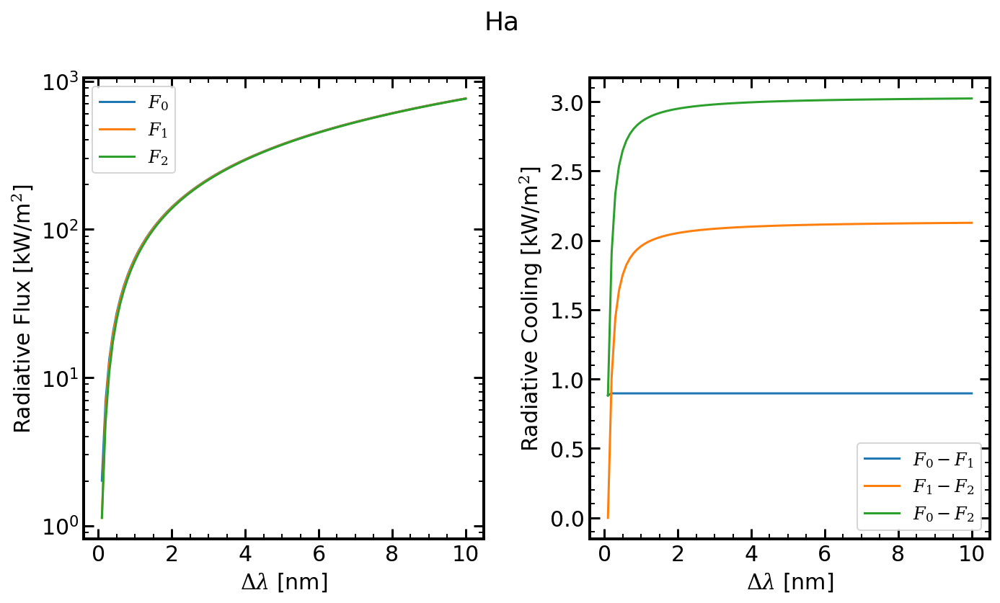

In [24]:
fplot(dwv=integration_binsize, fr=FR_Ha, line='Ha')

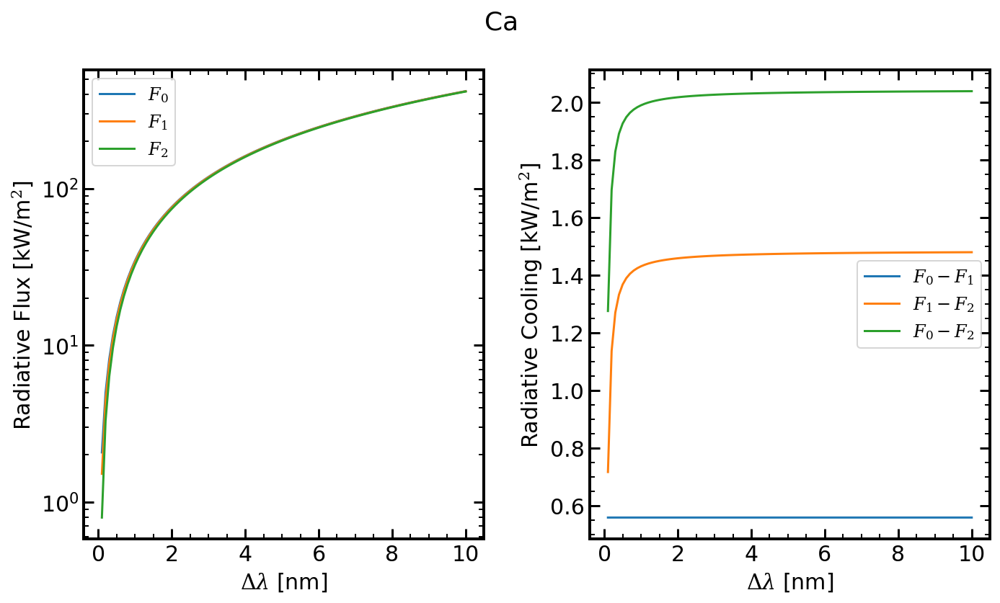

In [26]:
fplot(dwv=integration_binsize, fr=FR_Ca, line='Ca')

### Test

In [88]:
# typical parameters
params_Ha = db.parHa[:,195,74]
params_Ca = db.parCa[:,195,74]
print(params_Ha)
print(params_Ca)

t1 = time()
fr_Ha, err_Ha = flux_calculator(params_Ha, line='Ha')
t2 = time()
fr_Ca, err_Ca = flux_calculator(params_Ca, line='Ca')
t3 = time()

print(f'Flux and error of Ha line: Time for one calc. = {(t2-t1):.3f} [sec]\n', fr_Ha, err_Ha)
print(f'Flux and error of Ca II line: Time for one calc. = {(t3-t2):.3f} [sec]\n', fr_Ca, err_Ca)

[-0.23561827  0.51       -1.16        1.1         0.01623684 -0.17620977
  0.69897     0.69897    -0.04488366 -0.28742185 -0.45361545 -0.45479517
 -0.41356372 -0.75684617  1.01331481  0.0114648   0.2082937 ]
[-1.26005755e-01  4.30000000e-01 -1.27000000e+00  1.32000000e+00
  2.23460520e-03 -3.67490708e-01  6.98970004e-01  6.98970004e-01
 -2.77493924e-01 -4.64212929e-01 -6.93438776e-01 -7.92449403e-01
 -3.12704712e-01 -7.64941134e-01  4.13889635e+00  2.61559420e-01
  2.44994229e-01]
Flux and error of Ha line: Time for one calc. = 5.772 [sec]
 [64.05231037 63.1554922  61.1974298 ] [7.45991595e-06 7.45616235e-06 4.43967420e-06]
Flux and error of Ca II line: Time for one calc. = 6.767 [sec]
 [34.52193793 33.96302533 32.53202805] [4.52871635e-06 4.68694908e-06 2.69105673e-06]


In [15]:
db.parCa[:,0,1]

array([ 3.15908468e-03,  4.30000000e-01, -1.27000000e+00,  1.32000000e+00,
       -7.18105541e-03, -5.03346341e-01,  6.98970004e-01,  6.98970004e-01,
       -4.07569201e-01,  1.60883983e+00, -7.35534114e-01, -8.31962509e-01,
       -4.52915429e-01, -1.01851623e+00,  5.74394150e+00,  4.84160455e-01,
        1.70351881e-01])

In [14]:
fr_Ha, err_Ha = flux_calculator(db.parCa[:,0,1], line='Ca')

In [16]:
print(fr_Ha)

[30.51636498 30.21987038 29.50166376]


### Mining flux data with Multiprocessing

In [79]:
import multiprocessing as mp
from multiprocessing import Pool, Process, Queue, Manager

In [80]:
mp.cpu_count()

48

In [111]:
# Calculation by Multiprocessing
def worker(result_list, num1, num2):
    flux, err = flux_calculator(db.parHa[:,num1,num2], line='Ha')
    result = []
    result.append((num1,num2))
    result.append(flux)
    
    result_list.append(result)
    
if __name__ == '__main__':
    cols = range(250)
    rows = range(150)
    
    pool = Pool(8)
    manager = Manager()
    result_list = manager.list()

    t_start = time()
    pool.starmap(worker, [(result_list, i, j) for i in cols for j in rows])
    pool.close()
    pool.join()
    t_end = time()
    print(f'runtime for 8 calculations = {t_end-t_start:.2e} [sec] = {(t_end-t_start)/3600:.2f} [hr]')

runtime for 8 calculations = 2.78e+04 [sec] = 7.72 [hr]


In [119]:
FLUX_Ha = np.zeros((3,250,150))

for (i, j), flux in result_list:
    FLUX_Ha[:,i,j] = flux

In [121]:
np.save('FR_20170614_180941_Ha.npy', FLUX_Ha)

## Flux Calculator ver.1.1

In [6]:
def flux_calculator_1(pars, line='Ha', int_bin_size=1, optical_depth=0, calc_option='aggregate'):
    e2 = lambda x: special.expn(2,x)
    
    # [S] = ?
    S0 = 10**pars[13]
    S1 = 10**pars[12]
    S2 = 10**pars[5]
    Sp = 10**pars[4]

    s1 = lambda x: S0 + (-3*S0+4*S1-S2)/2 * x + (S0-2*S1+S2)/2 * x**2
    s2 = lambda x: S1 + (-S0+S2)/2 * x        + (S0-2*S1+S2)/2 * x**2
    s3 = lambda x: S2 + (Sp-S2) * x

    # [v] = km/s, [w] = nm, [a]&[eta]&[tau] = None
    v1 = pars[9]
    w1 = 10**(pars[11]-1)
    a1 = 0.0
    
    v2 = pars[8]
    w2 = 10**(pars[10]-1)
    a2 = 0.3
    
    vp = pars[0]
    wp = 10**(pars[2]-1)
    ap = 10**pars[3]
    eta = 10**pars[1]
    
    tau = 5.0
    c = 3e5 # km/s
    
    # different parameters of given line
    if line == 'Ha':
        wv0 = 656.3 # nm
        factor = 28.5/1.05 # kW m-2 sr-1 nm-1
    elif line == 'Ca':
        wv0 = 854.2 # nm
        factor = 17.6/1.05 # kW m-2 sr-1 nm-1
    else:
        raise NameError('Wrong line inputting.')
        
    # integration range [nm], default bin size = 1nm
    int_bin = [wv0-int_bin_size/2, wv0+int_bin_size/2]
    
    def u(wv, v, w):
        return (wv - (1+v/c)*wv0)/w

    h1 = lambda y: tau * wofz(u(y,v1,w1) + a1*1j).real / wofz(a1*1j).real
    h2 = lambda y: tau * wofz(u(y,v2,w2) + a2*1j).real / wofz(a2*1j).real
    hp = lambda y: eta * wofz(u(y,vp,wp) + ap*1j).real / wofz(ap*1j).real + 1

    # Flux by layer
    if optical_depth >= 0 and optical_depth < 1:
        xx = optical_depth
        f0 = lambda x,y: s1(x) * e2(abs(x-xx)*h1(y)                  ) * h1(y) * np.sign(x-xx)
        f1 = lambda x,y: s2(x) * e2(   (1-xx)*h1(y) + x*h2(y)        ) * h2(y)
        f2 = lambda x,y: s3(x) * e2(   (1-xx)*h1(y) + h2(y) + x*hp(y)) * hp(y)
        
    elif optical_depth >= 1 and optical_depth < 2:
        xx = optical_depth-1
        f0 = lambda x,y: s1(x) * -e2((1-x)*h1(y) + xx*h2(y)             ) * h1(y)
        f1 = lambda x,y: s2(x) *  e2(          abs(x-xx)*h2(y)          ) * h2(y) * np.sign(x-xx)
        f2 = lambda x,y: s3(x) *  e2(             (1-xx)*h2(y) + x*hp(y)) * hp(y)
    
    elif optical_depth >= 2:
        xx = optical_depth-2
        f0 = lambda x,y: s1(x) * -e2((1-x)*h1(y) + h2(y)      + xx*hp(y)   ) * h1(y)
        f1 = lambda x,y: s2(x) * -e2(             (1-x)*h2(y) + xx*hp(y)   ) * h2(y)
        f2 = lambda x,y: s3(x) *  e2(                       abs(x-xx)*hp(y)) * hp(y) * np.sign(x-xx)
    else:
        raise NameError('Wrong optical depth inputted!')

    # Calculation by layer
    num = 3
    FR, ERR = np.zeros(num), np.zeros(num)
    
    FR[0], ERR[0] = integrate.nquad(f0, [[0,1],int_bin])
    FR[1], ERR[1] = integrate.nquad(f1, [[0,1],int_bin]) 
    FR[2], ERR[2] = integrate.nquad(f2, [[0,np.inf],int_bin])
    
    if calc_option == 'aggregate':
        FR, ERR = FR @ np.ones(num), ERR @ np.ones(num)
    elif calc_option == 'separate':
        pass
    else:
        raise NameError('Wrong calculation option iputted!')

    # [F_R] = kW/m^2
    FR = 2*np.pi * FR * factor
    ERR = 2*np.pi * ERR * factor
    
    return FR, ERR

### Test

In [50]:
# typical parameters
params_Ha = db.parHa[:,195,74]
params_Ca = db.parCa[:,195,74]
optdepths = [0,1,2]

for optdepth in optdepths:
    t1 = time()
    fr_Ha, err_Ha = flux_calculator_1(params_Ha, line='Ha', optical_depth=optdepth)
    t2 = time()
    fr_Ca, err_Ca = flux_calculator_1(params_Ca, line='Ca', optical_depth=optdepth)
    t3 = time()

    print(f'Flux and error of Ha line: Time for one calc. = {(t2-t1):.3f} [sec]\n', fr_Ha, err_Ha)
    print(f'Flux and error of Ca II line: Time for one calc. = {(t3-t2):.3f} [sec]\n', fr_Ca, err_Ca)

Flux and error of Ha line: Time for one calc. = 2.264 [sec]
 64.05231037334485 7.459915952614864e-06
Flux and error of Ca II line: Time for one calc. = 3.104 [sec]
 34.52193792583937 4.528716350811497e-06
Flux and error of Ha line: Time for one calc. = 2.558 [sec]
 63.15549220281858 7.4561623485016486e-06
Flux and error of Ca II line: Time for one calc. = 2.766 [sec]
 33.963025330840544 4.686949082887351e-06
Flux and error of Ha line: Time for one calc. = 1.821 [sec]
 61.19742979768063 4.439674198846707e-06
Flux and error of Ca II line: Time for one calc. = 1.625 [sec]
 32.532028054191 2.6910567291011527e-06


In [51]:
FR_Ha[9]

array([64.05231037, 63.1554922 , 61.1974298 ])

In [74]:
fr_Ha, err_Ha = flux_calculator_1(params_Ha, line='Ha', optical_depth=0.5)
print(fr_Ha)

63.264201546500544


### As a function of $x=\tau/\tau_0$

In [105]:
# optical depth []
optical_depth_list = np.linspace(0,3, 3*20+1)
#print(optical_depth_list)

params_Ha = db.parHa[:,195,74]
params_Ca = db.parCa[:,195,74]
FR_Ha_x = []
FR_Ca_x = []

for idx, optical_depth in enumerate(optical_depth_list):
    print(idx)
    fr_Ha, err_Ha = flux_calculator_1(params_Ha, line='Ha', optical_depth=optical_depth)
    fr_Ca, err_Ca = flux_calculator_1(params_Ca, line='Ca', optical_depth=optical_depth)
    
    FR_Ha_x.append(fr_Ha)
    FR_Ca_x.append(fr_Ca)
    
FR_Ha_x = np.array(FR_Ha_x)
FR_Ca_x = np.array(FR_Ca_x)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60


In [106]:
def fplot(x, fr, params, line='Ha'):
    fig, ax = plt.subplots(1,3, figsize=(14,6))
    
    S0 = 10**params[13]
    S1 = 10**params[12]
    S2 = 10**params[5]
    Sp = 10**params[4]

    s1 = lambda x: S0 + (-3*S0+4*S1-S2)/2 * x + (S0-2*S1+S2)/2 * x**2
    s2 = lambda x: S1 + (-S0+S2)/2 * x        + (S0-2*S1+S2)/2 * x**2
    s3 = lambda x: S2 + (Sp-S2) * x

    # [v] = km/s, [w] = nm, [a]&[eta]&[tau] = None
    eta = 10**params[1]
    
    x_uc = x[x<=1]
    x_lc = x[np.logical_and(x<=2, x>=1)]
    x_ph = (x[x>=2]-2)*(1+eta) + 2
    
    # Source function graph
    ax[0].plot(x_uc, s1(x_uc), label='upper chromosphere')
    ax[0].plot(x_lc, s2(x_lc-1), label='lower chromosphere')
    ax[0].plot(x_ph, s3(x[x>=2]-2), label='photosphere')
    ax[0].set(xlabel=r'$t/\tau$', ylabel='Source Function', title=r'$S$')
    ax[0].legend()
    
    # Radiative Flux graph
    ax[1].plot(x_uc, fr[x<=1])
    ax[1].plot(x_lc, fr[np.logical_and(x<=2, x>=1)])
    ax[1].plot(x_ph, fr[x>=2])
    ax[1].set(xlabel=r'$t/\tau$', ylabel=r'Radiative Flux [kW/m$^2$]', title=r'$F_R$')
    
    # Radiative Loss graph
    loss = fr.copy()
    loss[:-1] += -fr[1:].copy()
    loss[-1] = 0
    
    ax[2].step(x_uc, loss[x<=1])
    ax[2].step(x_lc, loss[np.logical_and(x<=2, x>=1)])
    ax[2].step(x_ph, loss[x>=2])
    ax[2].set(xlabel=r'$t/\tau$', ylabel=r'Radiative Loss [kW/m$^2$]', title=r'$\Delta F_R$')
    ax[2].grid(ls=':')

    fig.suptitle(line)
    plt.tight_layout()
    #plt.savefig('.pdf', format='pdf', dpi=300)
    plt.show()

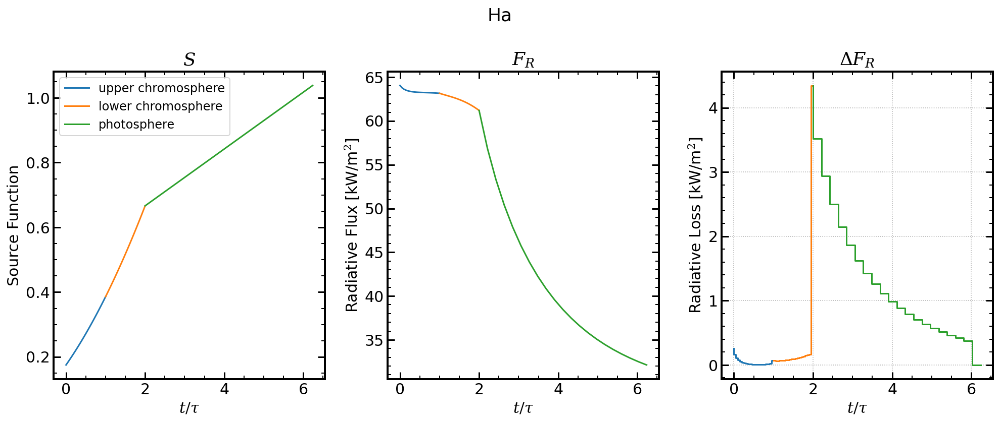

In [107]:
fplot(x=optical_depth_list, fr=FR_Ha_x, params=params_Ha, line='Ha')

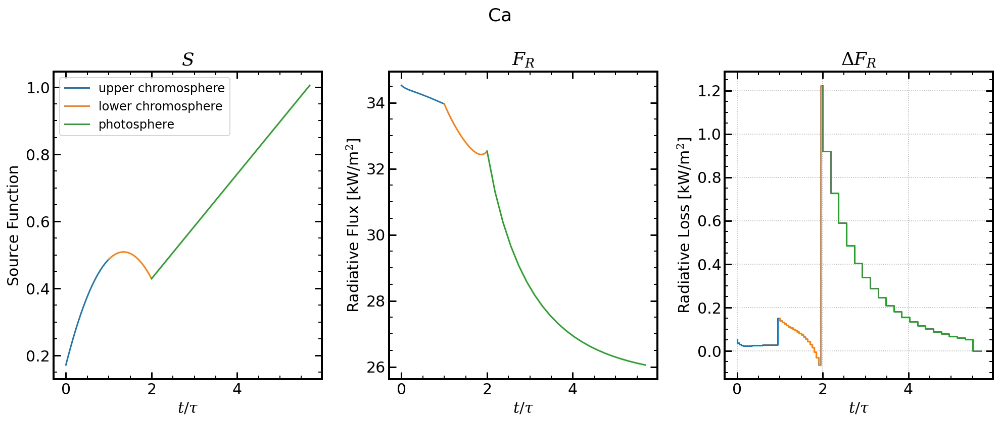

In [108]:
fplot(x=optical_depth_list, fr=FR_Ca_x, params=params_Ca, line='Ca')

## Flux Calculator ver.1.2 (Chae et al. 2021 in prep.)

In [2]:
def flux_calculator_2(pars, line='Ha', int_bin_size=2, calc_option='bundle'):  
    # source function, [S] = ?
    s0 = 10**pars[13]
    s1 = 10**pars[12]
    s2 = 10**pars[5]
    sp = 10**pars[4]

    S1 = lambda x: s0 + (-3*s0+4*s1-s2)/2 * x + (s0-2*s1+s2)/2 * x**2
    S2 = lambda x: s1 + (-s0+s2)/2 * x        + (s0-2*s1+s2)/2 * x**2
    S3 = lambda x: s2 + (sp-s2) * x

    # Doppler shift, [v] = km/s
    v0 = pars[9]
    v1 = pars[8]
    v2 = pars[0]
    vp = v2
    
    V1 = lambda x: v0 + (v1-v0)*x
    V2 = lambda x: v1 + (v2-v1)*x
    V3 = lambda x: v2
    
    # Doppelr width, [w] = nm
    w0 = 10**(pars[11]-1)
    w1 = 10**(pars[10]-1)
    w2 = 10**(pars[2]-1)
    wp = w2
    
    W1 = lambda x: w0 + (w1-w0)*x
    W2 = lambda x: w1 + (w2-w1)*x
    W3 = lambda x: w2
    
    # Other parameters, [a]&[eta]&[tau] = None
    a1 = 0.0
    a2 = lambda x: 10**(pars[14]-1)*x/W2(x)
    ap = 10**pars[3]
    eta = 10**pars[1]
    tau = 5.0
    c = 3e5 # km/s
    
    # different parameters of given line
    if line == 'Ha':
        line_center = 656.2817 # nm
        flux_factor = 28.5/1.05 # kW m-2 sr-1 nm-1
    elif line == 'Ca':
        line_center = 854.2091 # nm
        flux_factor = 17.6/1.05 # kW m-2 sr-1 nm-1
    else:
        raise NameError('Wrong line inputting.')
    
    # Line profiles & optical depth
    def u(wavelength, velocity, width):
        return (wavelength - (1+velocity/c)*line_center)/width
    
    r1 = lambda x, y: wofz(u(y,V1(x),W1(x)) + a1*1j).real    / wofz(a1*1j).real
    r2 = lambda x, y: wofz(u(y,V2(x),W2(x)) + a2(x)*1j).real / wofz(a2(x)*1j).real
    rp = lambda x, y: wofz(u(y,V3(x),W3(x)) + ap*1j).real    / wofz(ap*1j).real * eta + 1
    
    t1 = lambda x, y: tau * x/2 * (5/9*r1(x*(1-np.sqrt(3/5))/2,y) + 8/9*r1(x/2,y) + 5/9*r1(x*(1+np.sqrt(3/5))/2,y))
    t2 = lambda x, y: tau * x/2 * (5/9*r2(x*(1-np.sqrt(3/5))/2,y) + 8/9*r2(x/2,y) + 5/9*r2(x*(1+np.sqrt(3/5))/2,y))
    tp = lambda x, y: x * rp(x,y)

    E2 = lambda x: special.expn(2,x)
    
    # integration range [nm], default bin size = 2nm
    int_bin = [line_center-int_bin_size/2, line_center+int_bin_size/2]

    # Flux_0
    f00 = lambda x, y: S1(x) * E2(t1(x,y)                    ) * r1(x,y) * tau
    f01 = lambda x, y: S2(x) * E2(t1(1,y) + t2(x,y)          ) * r2(x,y) * tau
    f02 = lambda x, y: S3(x) * E2(t1(1,y) + t2(1,y) + tp(x,y)) * rp(x,y)
    
    # Flux_1
    f10 = lambda x, y: S1(x) * -E2(t1(1-x,y)                 ) * r1(1-x,y) * tau
    f11 = lambda x, y: S2(x) *  E2(         t2(x,y)          ) * r2(x,y)   * tau
    f12 = lambda x, y: S3(x) *  E2(         t2(1,y) + tp(x,y)) * rp(x,y)
    
    # Flux_2
    f20 = lambda x, y: S1(x) * -E2(t1(1-x,y) + t2(1,y)         ) * r1(1-x,y) * tau
    f21 = lambda x, y: S2(x) * -E2(            t2(1-x,y)       ) * r2(1-x,y) * tau
    f22 = lambda x, y: S3(x) *  E2(                     tp(x,y)) * rp(x,y)

    # Calculation part
    FR, ERR = np.zeros((3,3)), np.zeros((3,3))
   
    FR[0,0], ERR[0,0] = integrate.nquad(f00, [[0,1],int_bin])
    FR[0,1], ERR[0,1] = integrate.nquad(f01, [[0,1],int_bin]) 
    FR[0,2], ERR[0,2] = integrate.nquad(f02, [[0,np.inf],int_bin])
    
    FR[1,0], ERR[1,0] = integrate.nquad(f10, [[0,1],int_bin])
    FR[1,1], ERR[1,1] = integrate.nquad(f11, [[0,1],int_bin])
    FR[1,2], ERR[1,2] = integrate.nquad(f12, [[0,np.inf],int_bin])

    FR[2,0], ERR[2,0] = integrate.nquad(f20, [[0,1],int_bin])
    FR[2,1], ERR[2,1] = integrate.nquad(f21, [[0,1],int_bin])
    FR[2,2], ERR[2,2] = integrate.nquad(f22, [[0,np.inf],int_bin])
    
    if calc_option == 'bundle':
        FR, ERR = FR @ np.ones(3), ERR @ np.ones(3)
    elif calc_option == 'each':
        pass
    else:
        raise NameError('Wrong calculation option iputted!')

    # [F_R] = kW/m^2
    FR = 2*np.pi * FR * flux_factor
    ERR = 2*np.pi * ERR * flux_factor
    
    return FR, ERR

### Test

In [5]:
print(db.parHa.shape, db.parCa.shape)

(17, 250, 150) (17, 250, 150)


In [6]:
db.parHa[:,10,11]

array([ 0.43537463,  0.5117362 , -0.6465525 ,  0.53778269, -0.00416036,
       -0.24600326,  0.69897   ,  0.69897   , -1.94284752,  2.4122754 ,
       -0.44945142, -0.56162425, -0.3919701 , -0.82363146,  0.14271902,
        1.01203401,  0.74659271])

In [7]:
t1 = time()
fr_Ha, err_Ha = flux_calculator_2(db.parHa[:,10,11], line='Ha')
t2 = time()
fr_Ca, err_Ca = flux_calculator_2(db.parCa[:,10,11], line='Ca')
t3 = time()

print(f'Flux and error of Ha line: Time for one calc. = {(t2-t1):.3f} [sec]\n', fr_Ha)
print(f'Flux and error of Ca II line: Time for one calc. = {(t3-t2):.3f} [sec]\n', fr_Ca)

Flux and error of Ha line: Time for one calc. = 10.968 [sec]
 [121.13677725 120.06063361 107.4828755 ]
Flux and error of Ca II line: Time for one calc. = 10.290 [sec]
 [60.97875755 60.56158633 51.90369576]


In [9]:
db.fissHa.data.shape

(250, 150, 512)

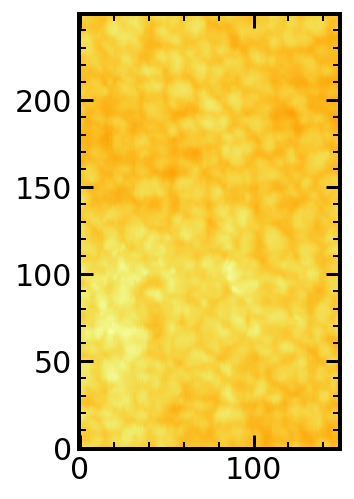

In [13]:
plt.imshow(db.fissHa.data[:,:,20], origin='lower', cmap='inferno')

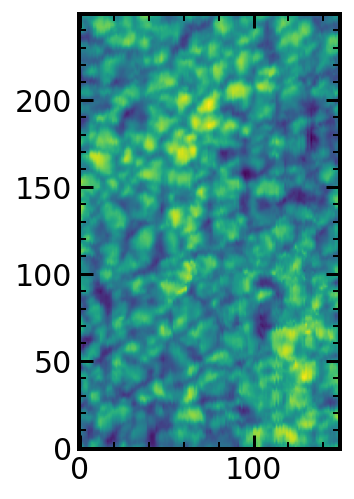

In [16]:
plt.imshow(db.parHa[4,:,:], origin='lower')

### Mining data

In [8]:
mp.cpu_count()

48

In [17]:
# Calculation by Multiprocessing
def worker(result_list, num1, num2):
    lines = ['Ha', 'Ca']
    for line in lines:
        flux, err = flux_calculator_2(db.parHa[:,num1,num2], line=line)
        result = []
        result.append((num1,num2))
        result.append(flux)
        result.append(line)
        
        result_list.append(result)
    
if __name__ == '__main__':    
    num_cpu = 32
    pool = Pool(num_cpu)
    manager = Manager()
    result_list = manager.list()

    npar, rows, cols = db.parHa.shape
    
    t_start = time()
    pool.starmap(worker, [(result_list, i, j) for i in range(rows) for j in range(cols)])
    pool.close()
    pool.join()
    t_end = time()
    print(f'runtime with {num_cpu} CPUs = {t_end-t_start:.2e} [sec] = {(t_end-t_start)/3600:.2f} [hr]')
    
    FLUX_Ha = np.zeros((3,rows,cols))
    FLUX_Ca = np.zeros((3,rows,cols))

    for (i, j), flux, line in result_list:
        if line=='Ha':
            FLUX_Ha[:,i,j] = flux
        elif line=='Ca':
            FLUX_Ca[:,i,j] = flux
        else:
            raise NameError('wrong line name saved..')
    
    if np.any(FLUX_Ha == None):
        print((FLUX_Ha == None).sum())
    else:
        np.save('FR_20130717_185221_Ha.npy', FLUX_Ha)
        
    if np.any(FLUX_Ca == None):
        print((FLUX_Ca == None).sum())
    else:
        np.save('FR_20130717_185222_Ca.npy', FLUX_Ca)

runtime with 32 CPUs = 3.19e+04 [sec] = 8.86 [hr]


In [92]:
np.save('FR_20200730_171326_Ha.npy', FLUX_Ha)
np.save('FR_20200730_171326_Ca.npy', FLUX_Ca)

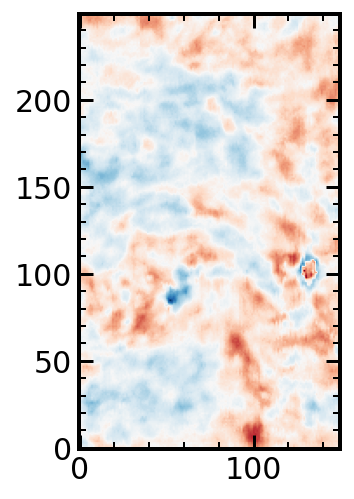

In [19]:
plt.imshow(FLUX_Ha[0,:,:]-FLUX_Ha[2,:,:], origin='lower', cmap='RdBu',  )

(array([3.0000e+00, 1.1300e+02, 1.3040e+03, 5.7850e+03, 1.4117e+04,
        1.2560e+04, 3.4390e+03, 1.5300e+02, 2.1000e+01, 5.0000e+00]),
 array([ 5.7427644 ,  7.19399991,  8.64523541, 10.09647091, 11.54770641,
        12.99894191, 14.45017741, 15.90141291, 17.35264841, 18.80388391,
        20.25511942]),
 <BarContainer object of 10 artists>)

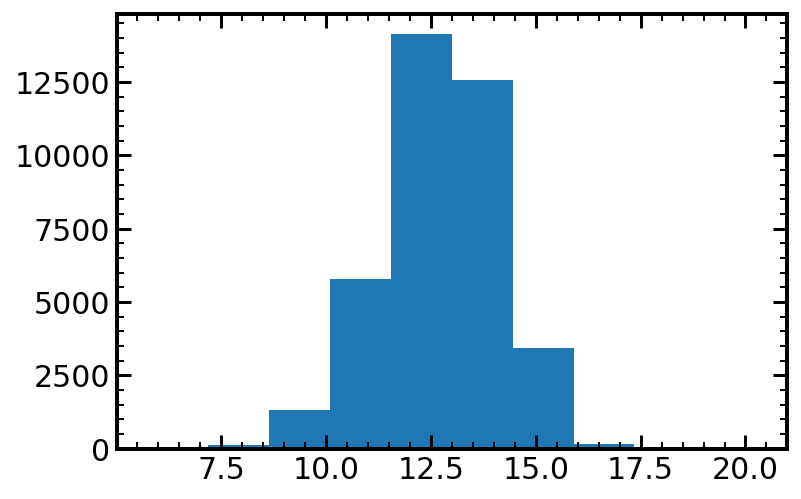

In [21]:
plt.hist((FLUX_Ha[0,:,:]-FLUX_Ha[2,:,:]).reshape(-1))

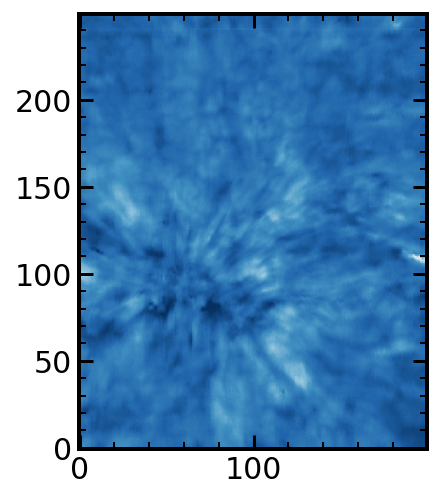

In [89]:
plt.imshow(FLUX_Ca[0,:,:]-FLUX_Ca[2,:,:], origin='lower', cmap='RdBu',  norm=colors.Normalize(vmin=-10, vmax=10))

## Flux Calculator ver.2
Apply single integration with generated Kernel function in order to make flux calculation faster than before.
$$\begin{align}
K_{0,0}(x) &= \int E_2(H_{\lambda,1}x) H_{\lambda,1}d\lambda, &K_{0,0}(x) &= \int E_2(H_{\lambda,1}x) H_{\lambda,1}d\lambda,\\
K_{0,1}(x) &= \int E_2(H_{\lambda,1}+H_{\lambda,2}x) H_{\lambda,2}d\lambda, &K_{1,0}(x) &= -\int E_2(H_{\lambda,1}(1-x)) H_{\lambda,1}d\lambda\\
K_{0,2}(x) &= \int E_2(H_{\lambda,1}+H_{\lambda,2}+H_{\lambda,p}x) H_{\lambda,p}d\lambda, &K_{2,0}(x) &= -\int E_2(H_{\lambda,1}(1-x)+H_{\lambda,2}) H_{\lambda,1}d\lambda\\ \\
K_{1,0}(x) &= -\int E_2(H_{\lambda,1}(1-x)) H_{\lambda,1}d\lambda, &K_{0,1}(x) &= \int E_2(H_{\lambda,1}+H_{\lambda,2}x) H_{\lambda,2}d\lambda\\
K_{1,1}(x) &= \int E_2(H_{\lambda,2}x) H_{\lambda,2}d\lambda, &K_{1,1}(x) &= \int E_2(H_{\lambda,2}x) H_{\lambda,2}d\lambda\\
K_{1,2}(x) &= \int E_2(H_{\lambda,2}+H_{\lambda,p}x) H_{\lambda,p}d\lambda, &K_{2,1}(x) &= -\int E_2(H_{\lambda,2}(1-x)) H_{\lambda,2}d\lambda\\ \\
K_{2,0}(x) &= -\int E_2(H_{\lambda,1}(1-x)+H_{\lambda,2}) H_{\lambda,1}d\lambda, &K_{0,2}(x) &= \int E_2(H_{\lambda,1}+H_{\lambda,2}+H_{\lambda,p}x) H_{\lambda,p}d\lambda\\
K_{2,1}(x) &= -\int E_2(H_{\lambda,2}(1-x)) H_{\lambda,2}d\lambda, &K_{1,2}(x) &= \int E_2(H_{\lambda,2}+H_{\lambda,p}x) H_{\lambda,p}d\lambda\\
K_{2,2}(x) &= \int E_2(H_{\lambda,p}x) H_{\lambda,p}d\lambda. &K_{2,2}(x) &= \int E_2(H_{\lambda,p}x) H_{\lambda,p}d\lambda.
\end{align}
$$

### Kernel

In [3]:
def gen_kernel(line='Ha'):
    e2 = lambda x: special.expn(2,x)
    x = np.linspace(0,1, 101)
    kernel = []
    
    # [v] = km/s, [w] = nm, [a]&[eta]&[tau] = None
    a1 = 0.0
    a2 = 0.3
    tau = 5.0
    c = 3e5 # km/s
    
    # different parameters of given line
    if line == 'Ha':
        ap = 10**1.1
        eta = 10**0.51
        int_bin = [-80,80] # integration range [dimensionless] 
        
    elif line == 'Ca':
        ap = 10**1.32
        eta = 10**0.43
        int_bin = [-120,120] # integration range [dimensionless]
        
    else:
        raise NameErorr('Wrong line inputting.')

    h1 = lambda y: tau * wofz(y + a1*1j).real / wofz(a1*1j).real
    h2 = lambda y: tau * wofz(y + a2*1j).real / wofz(a2*1j).real
    hp = lambda y: eta * wofz(y + ap*1j).real / wofz(ap*1j).real + 1
    
    for i in range(3):
        for j in range(3):
            ker = np.zeros(len(x))
            for k, xx in enumerate(x):
                if j==0:
                    if i==0:   f = lambda y:  e2(xx*h1(y)            ) * h1(y)
                    elif i==1: f = lambda y: -e2((1-xx)*h1(y)        ) * h1(y)
                    elif i==2: f = lambda y: -e2((1-xx)*h1(y) + h2(y)) * h1(y)
                elif j==1:
                    if i==0:   f = lambda y:  e2(h1(y) + xx*h2(y)) * h2(y)
                    elif i==1: f = lambda y:  e2(        xx*h2(y)) * h2(y)
                    elif i==2: f = lambda y: -e2(    (1-xx)*h2(y)) * h2(y)
                elif j==2:
                    if i==0:   f = lambda y: e2(h1(y) + h2(y) + xx*hp(y)) * hp(y)
                    elif i==1: f = lambda y: e2(        h2(y) + xx*hp(y)) * hp(y)
                    elif i==2: f = lambda y: e2(                xx*hp(y)) * hp(y)
                ker[k] = integrate.quad(f, int_bin[0],int_bin[1], epsrel=1e-5)[0]
            kernel.append(interpolate.interp1d(x, ker, kind='linear', fill_value='extrapolate'))
    
    return kernel

### Modified Kernel-wavelength issue

In [4]:
def gen_kernel2(line='Ha'):
    e2 = lambda x: special.expn(2,x)
    x = np.linspace(0,1, 101)
    kernel = []
    
    # [v] = km/s, [w] = nm, [a]&[eta]&[tau] = None
    a1 = 0.0
    a2 = 0.3
    tau = 5.0
    c = 3e5 # km/s
    
    # different parameters of given line
    if line == 'Ha':
        ap = 10**1.1
        eta = 10**0.51
        int_bin = [-500,500] # [pm], integration range = 1nm
        w1, w2, wp = 10**1.55, 10**1.55, 10**0.84 # [w] = pm
        
    elif line == 'Ca':
        ap = 10**1.32
        eta = 10**0.43
        int_bin = [-500,500] # [pm], integration range = 1nm
        w1, w2, wp = 10**1.21, 10**1.31, 10**0.73 # [w] = pm
        
    else:
        raise NameErorr('Wrong line inputting.')

    h1 = lambda y: tau * wofz(y/w1 + a1*1j).real / wofz(a1*1j).real
    h2 = lambda y: tau * wofz(y/w2 + a2*1j).real / wofz(a2*1j).real
    hp = lambda y: eta * wofz(y/wp + ap*1j).real / wofz(ap*1j).real + 1
    
    for i in range(3):
        for j in range(3):
            ker = np.zeros(len(x))
            for k, xx in enumerate(x):
                if j==0:
                    if i==0:   f = lambda y:  e2(xx*h1(y)            ) * h1(y) / w1
                    elif i==1: f = lambda y: -e2((1-xx)*h1(y)        ) * h1(y) / w1
                    elif i==2: f = lambda y: -e2((1-xx)*h1(y) + h2(y)) * h1(y) / w1
                elif j==1:
                    if i==0:   f = lambda y:  e2(h1(y) + xx*h2(y)) * h2(y) / w2
                    elif i==1: f = lambda y:  e2(        xx*h2(y)) * h2(y) / w2
                    elif i==2: f = lambda y: -e2(    (1-xx)*h2(y)) * h2(y) / w2
                elif j==2:
                    if i==0:   f = lambda y: e2(h1(y) + h2(y) + xx*hp(y)) * hp(y) / wp
                    elif i==1: f = lambda y: e2(        h2(y) + xx*hp(y)) * hp(y) / wp
                    elif i==2: f = lambda y: e2(                xx*hp(y)) * hp(y) / wp
                ker[k] = integrate.quad(f, int_bin[0],int_bin[1], epsrel=1e-5)[0]
            kernel.append(interpolate.interp1d(x, ker, kind='linear', fill_value='extrapolate'))
    
    return kernel

### Modified Kernel-optical depth issue

In [5]:
def gen_kernel3(line='Ha'):
    e2 = lambda x: special.expn(2,x)
    x = np.linspace(0,1, 101)
    N = 10
    kernel = []
    
    # [v] = km/s, [w] = nm, [a]&[eta]&[tau] = None
    a1 = 0.0
    a2 = 0.3
    tau = 5.0
    c = 3e5 # km/s
    
    # different parameters of given line
    if line == 'Ha':
        ap = 10**1.1
        eta = 10**0.51
        int_bin = [-500,500] # [pm], integration range = 1nm
        w1, w2, wp = 10**1.55, 10**1.55, 10**0.84 # [w] = pm
        
    elif line == 'Ca':
        ap = 10**1.32
        eta = 10**0.43
        int_bin = [-500,500] # [pm], integration range = 1nm
        w1, w2, wp = 10**1.21, 10**1.31, 10**0.73 # [w] = pm
        
    else:
        raise NameErorr('Wrong line inputting.')

    h1 = lambda y: tau * wofz(y/w1 + a1*1j).real / wofz(a1*1j).real
    h2 = lambda y: tau * wofz(y/w2 + a2*1j).real / wofz(a2*1j).real
    hp = lambda y: eta * wofz(y/wp + ap*1j).real / wofz(ap*1j).real + 1
    
    for i in range(3):
        for j in range(3):
            ker = np.zeros(len(x))
            for k, xx in enumerate(x):
                if j==0:
                    if i==0:   f = lambda y:  e2(xx*h1(y)            ) * h1(y) / w1
                    elif i==1: f = lambda y: -e2((1-xx)*h1(y)        ) * h1(y) / w1
                    elif i==2: f = lambda y: -e2((1-xx)*h1(y) + h2(y)) * h1(y) / w1
                elif j==1:
                    if i==0:   f = lambda y:  e2(h1(y) + xx*h2(y)) * h2(y) / w2
                    elif i==1: f = lambda y:  e2(        xx*h2(y)) * h2(y) / w2
                    elif i==2: f = lambda y: -e2(    (1-xx)*h2(y)) * h2(y) / w2
                elif j==2:
                    if i==0:   f = lambda y: e2(h1(y) + h2(y) + N*xx*hp(y)) * hp(y) / wp
                    elif i==1: f = lambda y: e2(        h2(y) + N*xx*hp(y)) * hp(y) / wp
                    elif i==2: f = lambda y: e2(                N*xx*hp(y)) * hp(y) / wp
                ker[k] = integrate.quad(f, int_bin[0],int_bin[1], epsrel=1e-5)[0]
            if j==2:
                kernel.append(interpolate.interp1d(N*x, ker, kind='linear', fill_value='extrapolate'))
            else:
                kernel.append(interpolate.interp1d(x, ker, kind='linear', fill_value='extrapolate'))
    
    return kernel

In [6]:
# Obtain kernel for the Ca II line
t1 = time()
KERNEL = gen_kernel(line='Ca')
t2 = time()
KERNEL2 = gen_kernel2(line='Ca')
t3 = time()
KERNEL3 = gen_kernel3(line='Ca')
t4 = time()
print(f'Time for obtaining a kernel function of ver.1 = {(t2-t1):.2e} [sec]')
print(f'Time for obtaining a kernel function of ver.2 = {(t3-t2):.2e} [sec]\n')
print(f'Time for obtaining a kernel function of ver.3 = {(t3-t2):.2e} [sec]\n')

print('Kernels are all set!')

Time for obtaining a kernel function of ver.1 = 3.38e+00 [sec]
Time for obtaining a kernel function of ver.2 = 2.26e+00 [sec]

Time for obtaining a kernel function of ver.3 = 2.26e+00 [sec]

Kernels are all set!


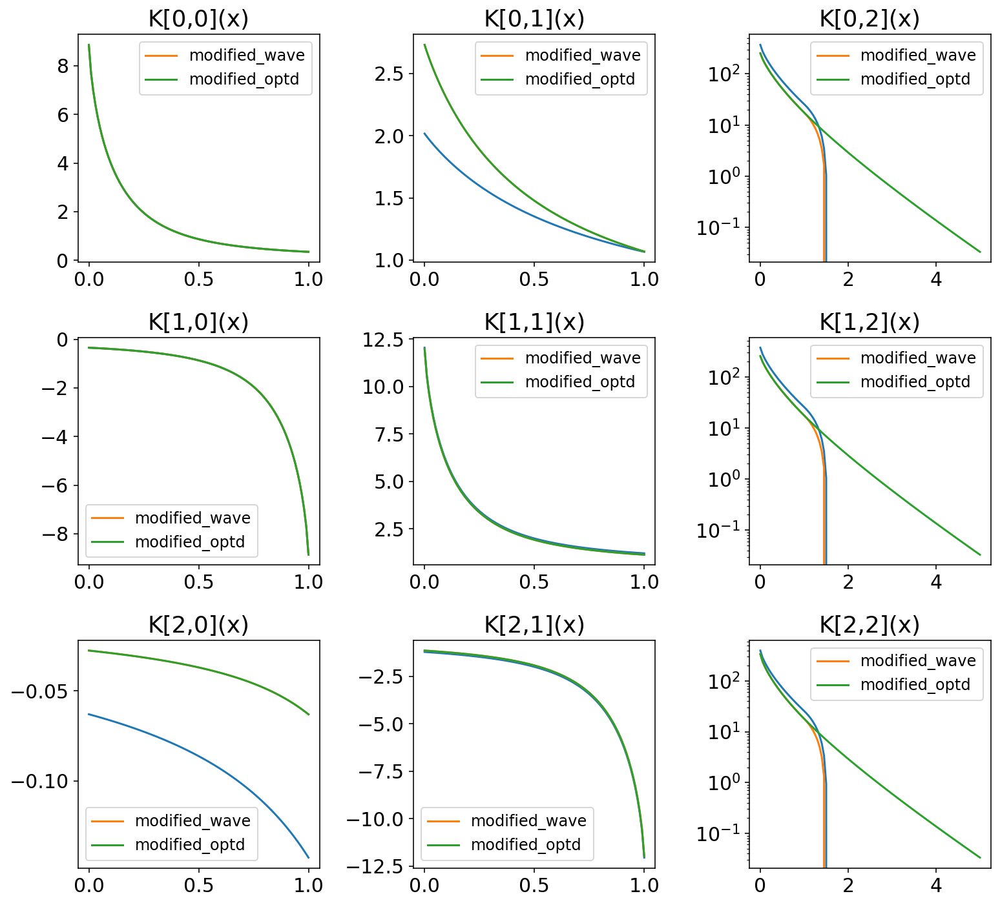

In [12]:
xc = np.linspace(0,1,101)
xp = np.linspace(0,5,101)

fig,ax = plt.subplots(3,3,figsize=(11,10))

for i in range(3):
    for j in range(3):
        if j==2:
            x = xp
        else:
            x = xc
        ax[i,j].plot(x,KERNEL[3*i+j](x))
        ax[i,j].plot(x,KERNEL2[3*i+j](x), label='modified_wave')
        ax[i,j].plot(x,KERNEL3[3*i+j](x), label='modified_optd')
        
        if j==2:
            ax[i,j].set_yscale('log')
        ax[i,j].set_title(f'K[{i},{j}](x)')
        ax[i,j].legend()
        #ax[i,j].tick_params(which='both', direction='in')
        #ax[i,j].tick_params(which='major', length=5)
        
plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

In [13]:
def flux_calculator2(pars, line='Ha', kernel=None, criterion=False):
    e2 = lambda x: special.expn(2,x)
    
    # [S] = ?
    S0 = 10**pars[13]
    S1 = 10**pars[12]
    S2 = 10**pars[5]
    Sp = 10**pars[4]

    s1 = lambda x: S0 + (-3*S0+4*S1-S2)/2 * x + (S0-2*S1+S2)/2 * x**2
    s2 = lambda x: S1 + (-S0+S2)/2 * x        + (S0-2*S1+S2)/2 * x**2
    s3 = lambda x: S2 + (Sp-S2) * x
    
    # [w] = nm
    w1 = 10**(pars[11]-1)
    w2 = 10**(pars[10]-1)
    wp = 10**(pars[2]-1)
    
    # different parameters of given line
    if line == 'Ha':
        factor = 2.85e4/1.05 # W m-2 sr-1 nm-1
    elif line == 'Ca':
        factor = 1.76e4/1.05 # W m-2 sr-1 nm-1

    if kernel is None:
        raise NameError('Kernel is none.')
    f00 = lambda x: s1(x) * w1 * kernel[0](x)
    f10 = lambda x: s1(x) * w1 * kernel[3](x)
    f20 = lambda x: s1(x) * w1 * kernel[6](x)
    
    f01 = lambda x: s2(x) * w2 * kernel[1](x)
    f11 = lambda x: s2(x) * w2 * kernel[4](x)
    f21 = lambda x: s2(x) * w2 * kernel[7](x)
    
    f02 = lambda x: s3(x) * wp * kernel[2](x)
    f12 = lambda x: s3(x) * wp * kernel[5](x)
    f22 = lambda x: s3(x) * wp * kernel[8](x)

    FR = np.zeros((3,3))
    N = 13
    
    FR[0,0] = integrate.fixed_quad(f00, 0,1, n=N)[0]
    FR[1,0] = integrate.fixed_quad(f10, 0,1, n=N)[0]
    FR[2,0] = integrate.fixed_quad(f20, 0,1, n=N)[0]
    
    FR[0,1] = integrate.fixed_quad(f01, 0,1, n=N)[0]
    FR[1,1] = integrate.fixed_quad(f11, 0,1, n=N)[0]
    FR[2,1] = integrate.fixed_quad(f21, 0,1, n=N)[0]
    
    if criterion:
        FR[0,2] = integrate.fixed_quad(f02, 0,10, n=N)[0]
        FR[1,2] = integrate.fixed_quad(f12, 0,10, n=N)[0]
        FR[2,2] = integrate.fixed_quad(f22, 0,10, n=N)[0]
    else:
        FR[0,2] = integrate.fixed_quad(f02, 0,1, n=N)[0]
        FR[1,2] = integrate.fixed_quad(f12, 0,1, n=N)[0]
        FR[2,2] = integrate.fixed_quad(f22, 0,1, n=N)[0]

    # [F_R] = W/m^2
    FR = 2*np.pi * FR * factor
    
    return FR.reshape(9)

### Comparison between each versions and observed data

In [17]:
# Caculation from Calculator ver.1
t1 = time()
fr0,err = flux_calculator(db.parCa[:,195,74], line='Ca')
t2 = time()
print(f'Time for one point = {(t2-t1):.3f} [sec]\n')
fr = fr0

print(f'Radiative Flux matrix \n{fr.reshape((3,3))}\n')
print(f'Uncertainty matrix \n{err.reshape((3,3))}\n')

print(f'F_0 = {(fr[0] + fr[1] + fr[2]):.3e} +/- {(err[0]**2 + err[1]**2 + err[2]**2)**0.5:.3e} [W/m^2]')
print(f'F_1 = {(fr[3] + fr[4] + fr[5]):.3e} +/- {(err[3]**2 + err[4]**2 + err[5]**2)**0.5:.3e} [W/m^2]')
print(f'F_2 = {(fr[6] + fr[7] + fr[8]):.3e} +/- {(err[6]**2 + err[7]**2 + err[8]**2)**0.5:.3e} [W/m^2]\n')

print(f'F_0 - F_2 = {(fr[0] + fr[1] + fr[2])-(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]')
print(f'F_0 - F_1 = {(fr[0] + fr[1] + fr[2])-(fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_1 - F_2 = {(fr[3] + fr[4] + fr[5])-(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]')

Time for one point = 6.401 [sec]

Radiative Flux matrix 
[[ 7.41292128e+02  1.67835854e+03  3.21022873e+04]
 [-1.15921219e+03  2.98209357e+03  3.21401440e+04]
 [-2.58582180e+01 -2.85619103e+03  3.54140773e+04]]

Uncertainty matrix 
[[1.41547359e-03 1.54625434e-03 1.56698843e-03]
 [1.56037815e-03 1.55926769e-03 1.56730324e-03]
 [5.02910557e-07 1.56800926e-03 1.12254456e-03]]

F_0 = 3.452e+04 +/- 2.617e-03 [W/m^2]
F_1 = 3.396e+04 +/- 2.706e-03 [W/m^2]
F_2 = 3.253e+04 +/- 1.928e-03 [W/m^2]

F_0 - F_2 = 1.990e+03 [W/m^2]
F_0 - F_1 = 5.589e+02 [W/m^2]
F_1 - F_2 = 1.431e+03 [W/m^2]


In [18]:
# Calculation from Calculator ver.2
t1 = time()
fr2 = flux_calculator2(db.parCa[:,195,74], line='Ca', kernel=KERNEL)
t2 = time()
print(f'Time for one point = {(t2-t1):.2e} [sec]\n')
fr = fr2

print(f'Radiative Flux matrix \n{fr.reshape((3,3))}\n')

print(f'F_0 = {(fr[0] + fr[1] + fr[2]):.3e} [W/m^2]')
print(f'F_1 = {(fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_2 = {(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]\n')

print(f'F_0 - F_2 = {(fr[0] + fr[1] + fr[2])-(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]')
print(f'F_0 - F_1 = {(fr[0] + fr[1] + fr[2])-(fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_1 - F_2 = {(fr[3] + fr[4] + fr[5])-(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]')

Time for one point = 1.50e-03 [sec]

Radiative Flux matrix 
[[  741.70459556  1476.64126583 34672.22518929]
 [-1160.22575081  3060.86948736 34699.85115574]
 [  -59.02993653 -2934.78984979 35553.77229003]]

F_0 = 3.689e+04 [W/m^2]
F_1 = 3.660e+04 [W/m^2]
F_2 = 3.256e+04 [W/m^2]

F_0 - F_2 = 4.331e+03 [W/m^2]
F_0 - F_1 = 2.901e+02 [W/m^2]
F_1 - F_2 = 4.041e+03 [W/m^2]


In [19]:
# Single Point Calculation from Calculator ver.3 - wavelength issue solved!
t1 = time()
fr3 = flux_calculator2(db.parCa[:,195,74], line='Ca', kernel=KERNEL2)
t2 = time()
print(f'Time for one point = {(t2-t1):.2e} [sec]\n')
fr = fr3

print(f'Radiative Flux matrix \n{fr.reshape((3,3))}\n')

print(f'F_0 = {(fr[0] + fr[1] + fr[2]):.3e} [W/m^2]')
print(f'F_1 = {(fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_2 = {(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]\n')

print(f'F_0 - F_2 = {(fr[0] + fr[1] + fr[2])-(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]')
print(f'F_0 - F_1 = {(fr[0] + fr[1] + fr[2])-(fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_1 - F_2 = {(fr[3] + fr[4] + fr[5])-(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]')

Time for one point = 1.62e-03 [sec]

Radiative Flux matrix 
[[ 7.41704596e+02  1.68020518e+03  2.46272618e+04]
 [-1.16022575e+03  2.98292002e+03  2.46638449e+04]
 [-2.55621422e+01 -2.85684916e+03  2.78530133e+04]]

F_0 = 2.705e+04 [W/m^2]
F_1 = 2.649e+04 [W/m^2]
F_2 = 2.497e+04 [W/m^2]

F_0 - F_2 = 2.079e+03 [W/m^2]
F_0 - F_1 = 5.626e+02 [W/m^2]
F_1 - F_2 = 1.516e+03 [W/m^2]


In [20]:
# Single Point Calculation from Calculator ver.3 - optical depth solved!
t1 = time()
fr4 = flux_calculator2(db.parCa[:,195,74], line='Ca', kernel=KERNEL3, criterion=True)
t2 = time()
print(f'Time for one point = {(t2-t1):.2e} [sec]\n')
fr = fr4

print(f'Radiative Flux matrix \n{fr.reshape((3,3))}\n')

print(f'F_0 = {(fr[0] + fr[1] + fr[2]):.3e} [W/m^2]')
print(f'F_1 = {(fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_2 = {(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]\n')

print(f'F_0 - F_2 = {(fr[0] + fr[1] + fr[2])-(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]')
print(f'F_0 - F_1 = {(fr[0] + fr[1] + fr[2])-(fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_1 - F_2 = {(fr[3] + fr[4] + fr[5])-(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]')

Time for one point = 1.37e-03 [sec]

Radiative Flux matrix 
[[ 7.41704596e+02  1.68020518e+03  3.24068241e+04]
 [-1.16022575e+03  2.98292002e+03  3.24451684e+04]
 [-2.55621422e+01 -2.85684916e+03  3.60284612e+04]]

F_0 = 3.483e+04 [W/m^2]
F_1 = 3.427e+04 [W/m^2]
F_2 = 3.315e+04 [W/m^2]

F_0 - F_2 = 1.683e+03 [W/m^2]
F_0 - F_1 = 5.609e+02 [W/m^2]
F_1 - F_2 = 1.122e+03 [W/m^2]


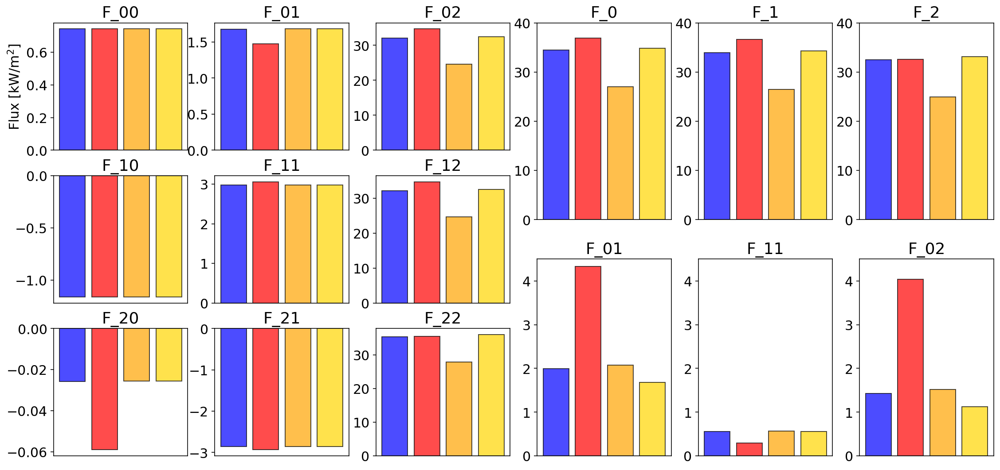

In [62]:
# Comparision btw. results
label = ['2-int', '1-int', '1-int-wave', '1-int-optd']
frs = [fr0/1e3, fr2/1e3, fr3/1e3, fr4/1e3]

fig = plt.figure(figsize=(19,9))
colors = ['blue', 'red', 'orange', 'gold']

ax1, ax2, ax3 = fig.add_subplot(3,6,1), fig.add_subplot(3,6,2), fig.add_subplot(3,6,3)
ax4, ax5, ax6 = fig.add_subplot(3,6,7), fig.add_subplot(3,6,8), fig.add_subplot(3,6,9)
ax7, ax8, ax9 = fig.add_subplot(3,6,13), fig.add_subplot(3,6,14), fig.add_subplot(3,6,15)
axes = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]

ax11, ax12, ax13 = fig.add_subplot(2,6,4), fig.add_subplot(2,6,5), fig.add_subplot(2,6,6)
ax21, ax22, ax23 = fig.add_subplot(2,6,10), fig.add_subplot(2,6,11), fig.add_subplot(2,6,12)
axes1 = [ax11, ax12, ax13]
axes2 = [ax21, ax22, ax23]

for i, ax in enumerate(axes):
    data = []
    for fr in frs:
        data.append(fr[i])
    ax.bar(label, data, color=colors, alpha=0.7, edgecolor='black')
    ax.set_title(f'F_{i//3}{i%3}')
    ax.get_xaxis().set_visible(False)
ax1.set_ylabel(r'Flux [kW/m$^2$]')

for j, ax in enumerate(axes1):
    data = []
    for i, fr in enumerate(frs):
        if j == 0:
            data.append(fr[0] + fr[1] + fr[2])
        elif j == 1:
            data.append(fr[3] + fr[4] + fr[5])
        elif j == 2 :
            data.append(fr[6] + fr[7] + fr[8])
    ax.bar(label, data, color=colors, alpha=0.7, edgecolor='black')    
    ax.get_xaxis().set_visible(False)
    ax.set_title(f'F_{j}')
    ax.set_ylim(0,40)

for j, ax in enumerate(axes2):
    data = []
    for i, fr in enumerate(frs):
        if j == 0:
            data.append(fr[0] + fr[1] + fr[2] - (fr[6] + fr[7] + fr[8]))
        elif j == 1:
            data.append(fr[0] + fr[1] + fr[2] - (fr[3] + fr[4] + fr[5]))
        elif j == 2 :
            data.append(fr[3] + fr[4] + fr[5] - (fr[6] + fr[7] + fr[8]))
    ax.bar(label, data, color=colors, alpha=0.7, edgecolor='black')    
    ax.get_xaxis().set_visible(False)
    ax.set_title(f'F_{j%2}{round(j/2)+1}')
    ax.set_ylim(0,4.5)
        
#plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

# FISS data (Chae et al. 2021 in prep.)
---

In [8]:
from fisspy.read import FISS
import fisspy.cm as fisscmap

In [9]:
# import a FISS file and its corresponding parameters file.
db = None
Initialized = False

# # Active Region
# fiss_path = '/data/home/sskang/Documents/Data/FISS_20130717_AR_/fiss_data'
# pars_path = '/data/home/sskang/Documents/Data/FISS_20130717_AR_/pars'

# fHa = '/FISS_20130717_185221_A1_c.fts'
# fCa = '/FISS_20130717_185222_B1_c.fts'
# fHapars = '/FISS_20130717_185221_A1_par.fts'
# fCapars = '/FISS_20130717_185222_B1_par.fts'

# Quiet Sun
fiss_path = '/data/home/sskang/Documents/Data/FISS_20170614_QS_/fiss_data'
pars_path = '/data/home/sskang/Documents/Data/FISS_20170614_QS_/pars'

fHa = '/FISS_20170614_171833_A1_c.fts'
fCa = '/FISS_20170614_171833_B1_c.fts'
fHapars = '/FISS_20170614_171833_A1_par.fts'
fCapars = '/FISS_20170614_171833_B1_par.fts'

fHa, fCa = fiss_path + fHa, fiss_path + fCa
fHapars, fCapars = pars_path + fHapars, pars_path + fCapars
print(fHa, fCa)
print(fHapars, fCapars)

if (db is None) and not Initialized:
    fissHa = FISS(fHa, absScale=False)   # 6562.82
    fissCa = FISS(fCa, absScale=False)   # 8542.09
    
    fissHa.data = np.flip(fissHa.data,1)
    fissCa.data = np.flip(fissCa.data,1)
    
    icont = fissHa.data[:,:,50]
    qs = icont > (icont.max()*0.7)
    fissHa.refProfile = fissHa.data[qs,:].mean(0)
    icont = fissCa.data[:,:, 50]
    qs = icont > (icont.max()*0.7)
    fissCa.refProfile = fissCa.data[qs,:].mean(0)
    
    del icont, qs
    Initialized = True

Fitted = True
if Fitted:
    db = fissDB(fissHa, fissCa, Aparfile=fHapars, Bparfile=fCapars)
else:
    db = fissDB(fissHa, fissCa)

/data/home/sskang/Documents/Data/FISS_20170614_QS_/fiss_data/FISS_20170614_171833_A1_c.fts /data/home/sskang/Documents/Data/FISS_20170614_QS_/fiss_data/FISS_20170614_171833_B1_c.fts
/data/home/sskang/Documents/Data/FISS_20170614_QS_/pars/FISS_20170614_171833_A1_par.fts /data/home/sskang/Documents/Data/FISS_20170614_QS_/pars/FISS_20170614_171833_B1_par.fts


[-499.994573414427, 474.93858502141296, -14.5, 14.5]
[-703.6267240474143, 580.1378778875855, -14.5, 14.5]


AttributeError: 'FigureManagerBase' object has no attribute 'window'

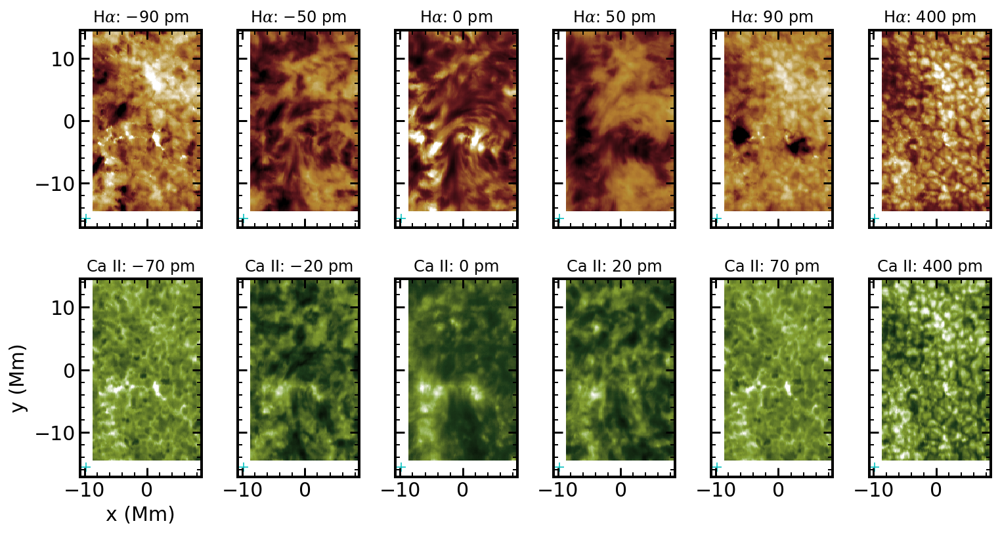

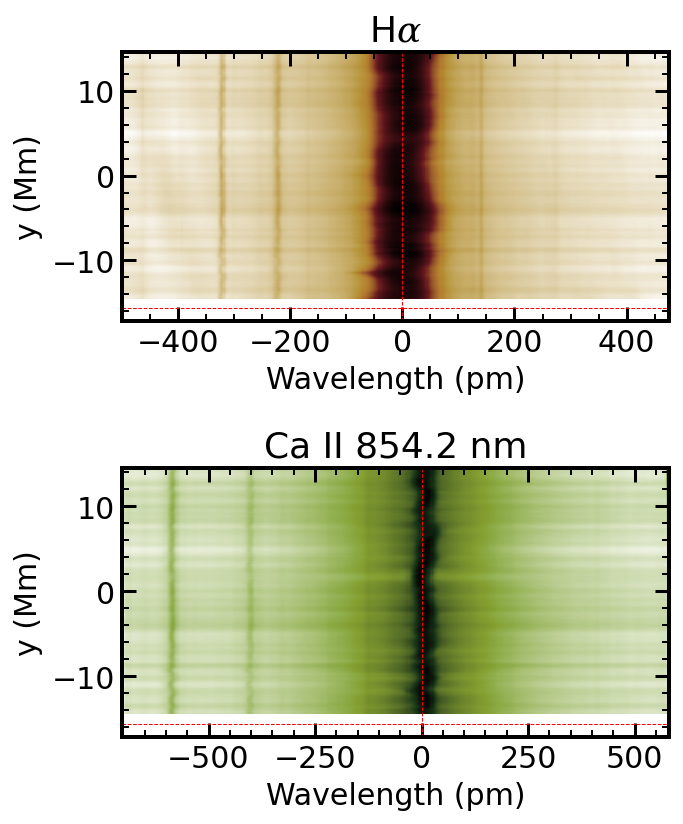

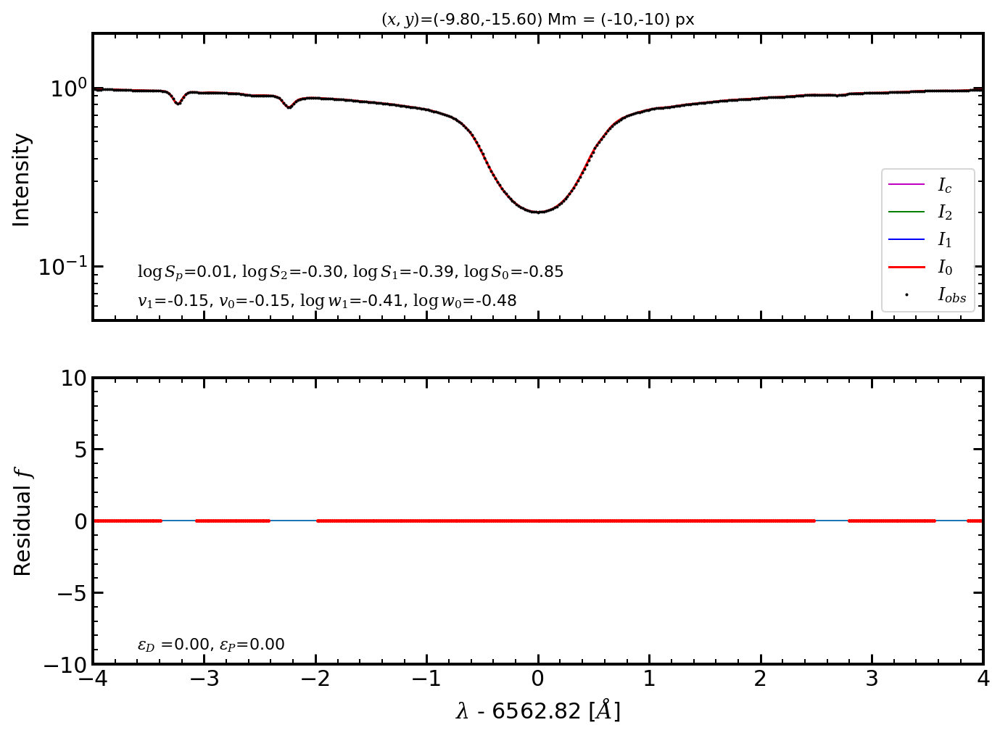

In [10]:
db.imshow(0,0)

## Flux direct calculation from FISS

In [4]:
db.parCa[:,195,74]

array([-1.26005755e-01,  4.30000000e-01, -1.27000000e+00,  1.32000000e+00,
        2.23460520e-03, -3.67490708e-01,  6.98970004e-01,  6.98970004e-01,
       -2.77493924e-01, -4.64212929e-01, -6.93438776e-01, -7.92449403e-01,
       -3.12704712e-01, -7.64941134e-01,  4.13889635e+00,  2.61559420e-01,
        2.44994229e-01])

In [108]:
# flux calculation of Ca II 8542 within [853.7 nm, 854.7nm]
wv_crit_Ca = 854.2 + 4.5 #nm

# refered to the Allen's Astrophysical Quantities
Ic_Ca = 1.94 * 0.403 + 1.58 * 0.597
Fc_Ca = Ic_Ca * np.pi * 10  # [kW/m^2/nm]
print(f"Ic_Ca = {Ic_Ca}, Fc_Ca = {Fc_Ca}")

i = 0
while db.fissCa.wave[i] > 4.5:
    i += 1
    if db.fissCa.wave[i] <= 4.5:
        m = db.fissCa.wave[i-1] - 4.5
        n = 4.5 - db.fissCa.wave[i]
        print(m, n)
        inten_ref_Ca = (m * db.fissCa.refProfile[i] + n * db.fissCa.refProfile[i-1])/(m+n)
        inten_tar_Ca = (m * db.fissCa.data[195,74,i] + n * db.fissCa.data[195,74,i-1])/(m+n)
print(f"intensity of reference = {inten_ref_Ca}, intensity of target = {inten_tar_Ca}")

#k_Ca = 0.85 * Fc_Ca/inten_ref_Ca
k_Ca = Fc_Ca/inten_ref_Ca
print(f'k value of Ca = {k_Ca}')

fluxdensity = db.fissCa.data[195,74,:] * k_Ca

f_fluxdensity = interpolate.interp1d(854.2 + db.fissCa.wave, fluxdensity, kind='linear', fill_value='extrapolate')
int_bin = [853.7, 854.7]
result, error = integrate.quad(f_fluxdensity, int_bin[0],int_bin[1])
print(f"Flux = {result} +- {error} [kW/m^2]")

Ic_Ca = 1.7250800000000002, Fc_Ca = 54.19498654854681
0.003280738320099452 0.022394553718600996
intensity of reference = 7709.116869844798, intensity of target = 7862.249022248943
k value of Ca = 0.007029986373735942
Flux = 26.071187848545403 +- 0.0009612731575359606 [kW/m^2]


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 
  on the subranges.  Perhaps a special-purpose integrator should be used.


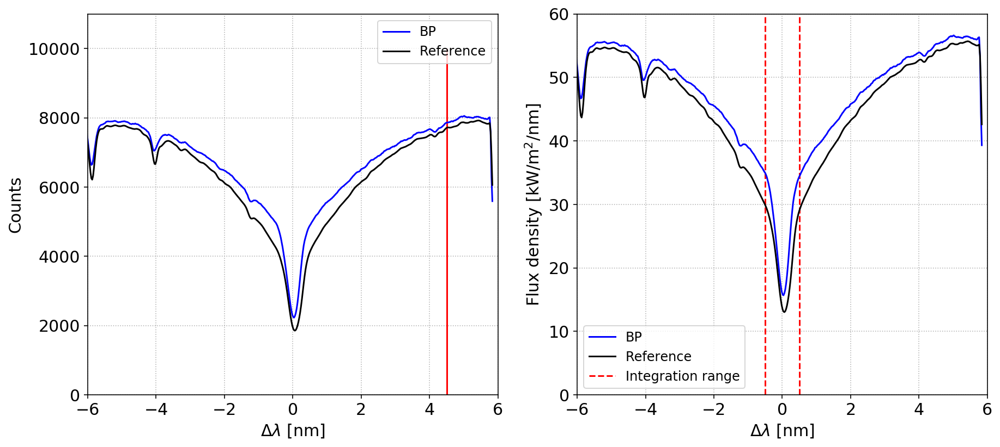

In [135]:
fig, ax = plt.subplots(1,2, figsize=(13, 6))

ax[0].plot(db.fissCa.wave, db.fissCa.data[195,74,:], color='blue', label='BP')
ax[0].plot(db.fissCa.wave, db.fissCa.refProfile, color='black', label='Reference')
ax[0].vlines(4.5, ymin=0, ymax=1e4, color='red')

ax[0].set_xlabel(r'$\Delta\lambda$ [nm]')
ax[0].set_ylabel('Counts')
ax[0].set_xlim(-6,6)
ax[0].set_ylim(0,1.1e4)
ax[0].legend()
ax[0].grid(ls=':')

ax[1].plot(db.fissCa.wave, k_Ca * db.fissCa.data[195,74,:], color='blue', label='BP')
ax[1].plot(db.fissCa.wave, k_Ca * db.fissCa.refProfile, color='black', label='Reference')
ax[1].vlines(-0.5, ymin=0, ymax=60, color='red', linestyle='--', label='Integration range')
ax[1].vlines(0.5, ymin=0, ymax=60, color='red', linestyle='--')

ax[1].set_xlabel(r'$\Delta\lambda$ [nm]')
ax[1].set_ylabel(r'Flux density [kW/m$^2$/nm]')
ax[1].set_xlim(-6,6)
ax[1].set_ylim(0,60)
ax[1].legend()
ax[1].grid(ls=':')

plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

In [5]:
np.save('parCa.npy', db.parCa)

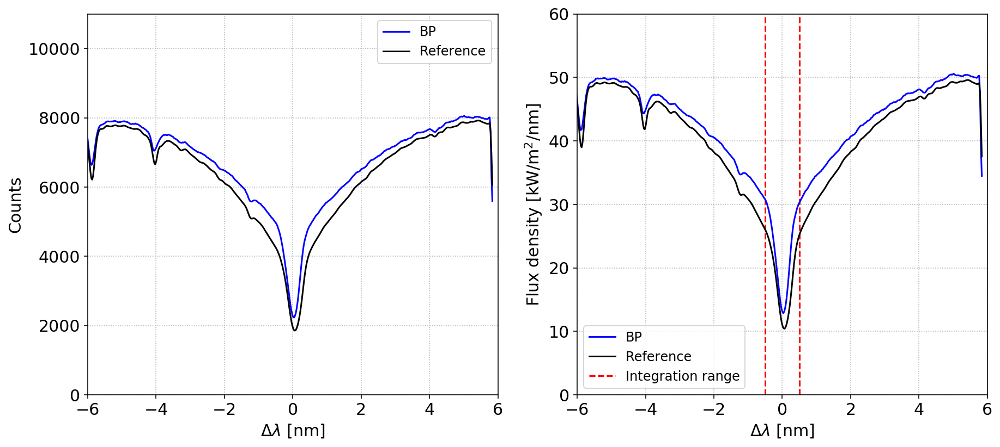

In [140]:
def fpure(wv, line='Ha'):
    if line == 'Ha':
        hw = 0.15
        pure = (abs(wv-6558.149) > hw) * (abs(wv-6559.580) > hw)  \
             * (abs(wv-6560.555) > hw) * (abs(wv-6560.68 ) > hw) \
             * (abs(wv-6561.097) > hw) * (abs(wv-6564.206) > hw)  \
             * (abs(wv-6564.1) > hw) * (abs(wv-6565.545 ) > hw)  
    if line == 'Ca':
        hw = 0.15
        pure =  (abs(wv-853.6165) > hw) * (abs(wv-853.645 ) > hw) \
            * (abs(wv-853.668 ) > hw) * (abs(wv-853.8015) > hw) \
            * (abs(wv-853.825 ) > hw)  \
            * (abs(wv-854.0817) > hw) * (abs(wv-854.6222) > hw) \
            * (abs(wv-854.8079) > hw)
    return pure

pure_Ca = fpure(854.2 + db.fissCa.wave, line='Ca')

def FissStray(pure, wv1, prof0, ref):
    ## Pre-processing
    epsilon=0.027
    prof0=(prof0-epsilon*ref) /((1-epsilon)*ref.max())
    
    zeta=0.03 #0.055
    prof0 = (prof0 -zeta*prof0.max())/(1.-zeta)
    
    con = pure * (abs(wv1) > 4.0)
    p1model=np.poly1d(np.polyfit(wv1[con], prof0[con], 1))
    p=p1model(wv1)
    intc=p.mean()
    if intc < 0.03: intc=0.03
    prof=prof0/p*intc
    
    return prof

prof_tar = FissStray(pure_Ca, db.fissCa.wave, db.fissCa.data[195,74,:], db.fissCa.refProfile)
prof_ref = FissStray(pure_Ca, db.fissCa.wave, db.fissCa.refProfile, db.fissCa.refProfile)

# Ca II 8542 line
factor = 17.6/1.05 # kW m-2 sr-1 nm-1
factor = factor * np.pi
prof_tar = prof_tar * factor
prof_ref = prof_ref * factor

fig, ax = plt.subplots(1,2, figsize=(13, 6))

ax[0].plot(db.fissCa.wave, db.fissCa.data[195,74,:], color='blue', label='BP')
ax[0].plot(db.fissCa.wave, db.fissCa.refProfile, color='black', label='Reference')

ax[0].set_xlabel(r'$\Delta\lambda$ [nm]')
ax[0].set_ylabel('Counts')
ax[0].set_xlim(-6,6)
ax[0].set_ylim(0,1.1e4)
ax[0].legend()
ax[0].grid(ls=':')

ax[1].plot(db.fissCa.wave, prof_tar, color='blue', label='BP')
ax[1].plot(db.fissCa.wave, prof_ref, color='black', label='Reference')
ax[1].vlines(-0.5, ymin=0, ymax=60, color='red', linestyle='--', label='Integration range')
ax[1].vlines(0.5, ymin=0, ymax=60, color='red', linestyle='--')

ax[1].set_xlabel(r'$\Delta\lambda$ [nm]')
ax[1].set_ylabel(r'Flux density [kW/m$^2$/nm]')
ax[1].set_xlim(-6,6)
ax[1].set_ylim(0,60)
ax[1].legend()
ax[1].grid(ls=':')

plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

## Parameter space
Present the whole parameters ranges using a corner plot.

{'data': (140388209397760, False), 'strides': None, 'descr': [('', '<f8')], 'typestr': '<f8', 'shape': (37500, 4), 'version': 3}


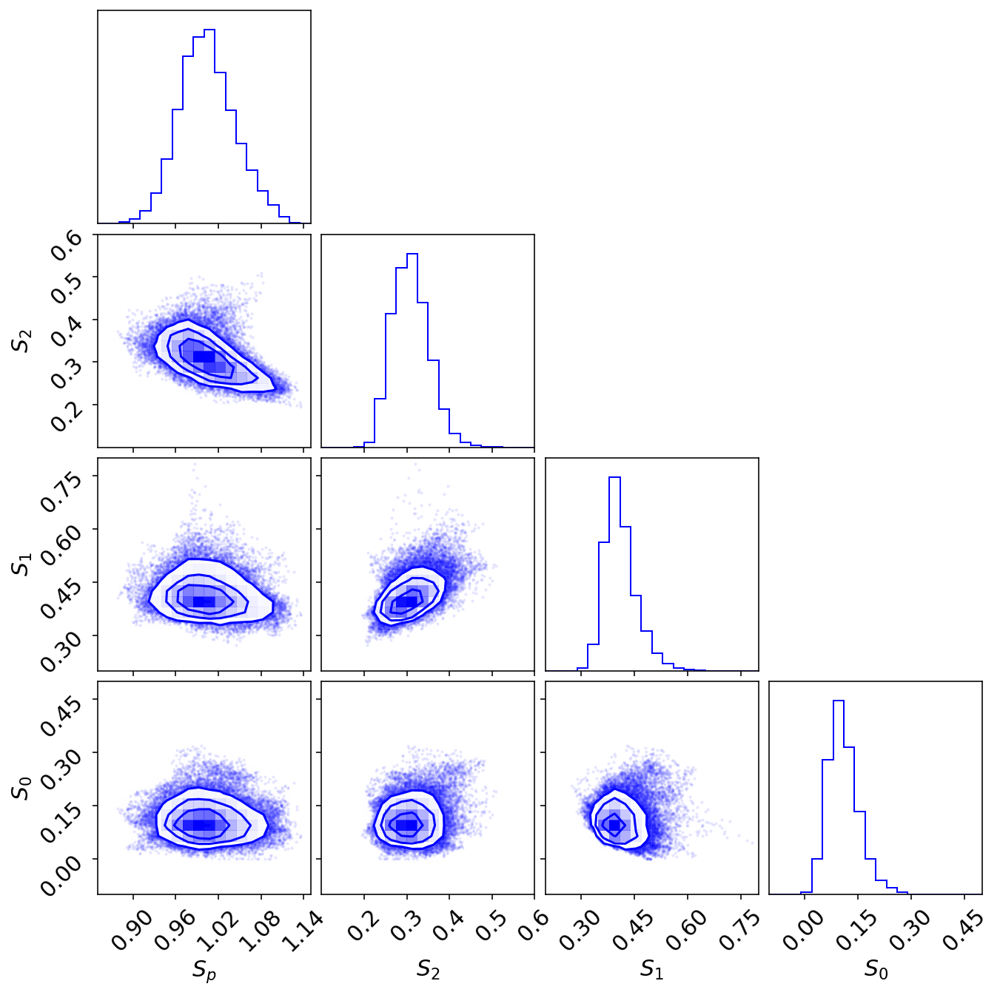

In [61]:
#ndim, nsamples = 3, 5000
#np.random.seed(1)
#samples = np.random.randn(ndim * nsamples).reshape([nsamples, ndim])

samples = 10**db.parCa[4,:,:].reshape(-1,1)
samples = np.append(samples, 10**db.parCa[5,:,:].reshape(-1,1), axis=1)
samples = np.append(samples, 10**db.parCa[12,:,:].reshape(-1,1), axis=1)
samples = np.append(samples, 10**db.parCa[13,:,:].reshape(-1,1), axis=1)
print(samples.__array_interface__)

ranges = [(0.85,1.15), (0.1,0.6), (0.2,0.8), (-0.1,0.5)]
labels = [r'$S_p$', r'$S_2$', r'$S_1$', r'$S_0$']

fig = corner.corner(samples, range=ranges, labels=labels, color='blue')

{'data': (140481750044672, False), 'strides': None, 'descr': [('', '<f8')], 'typestr': '<f8', 'shape': (37500, 8), 'version': 3}


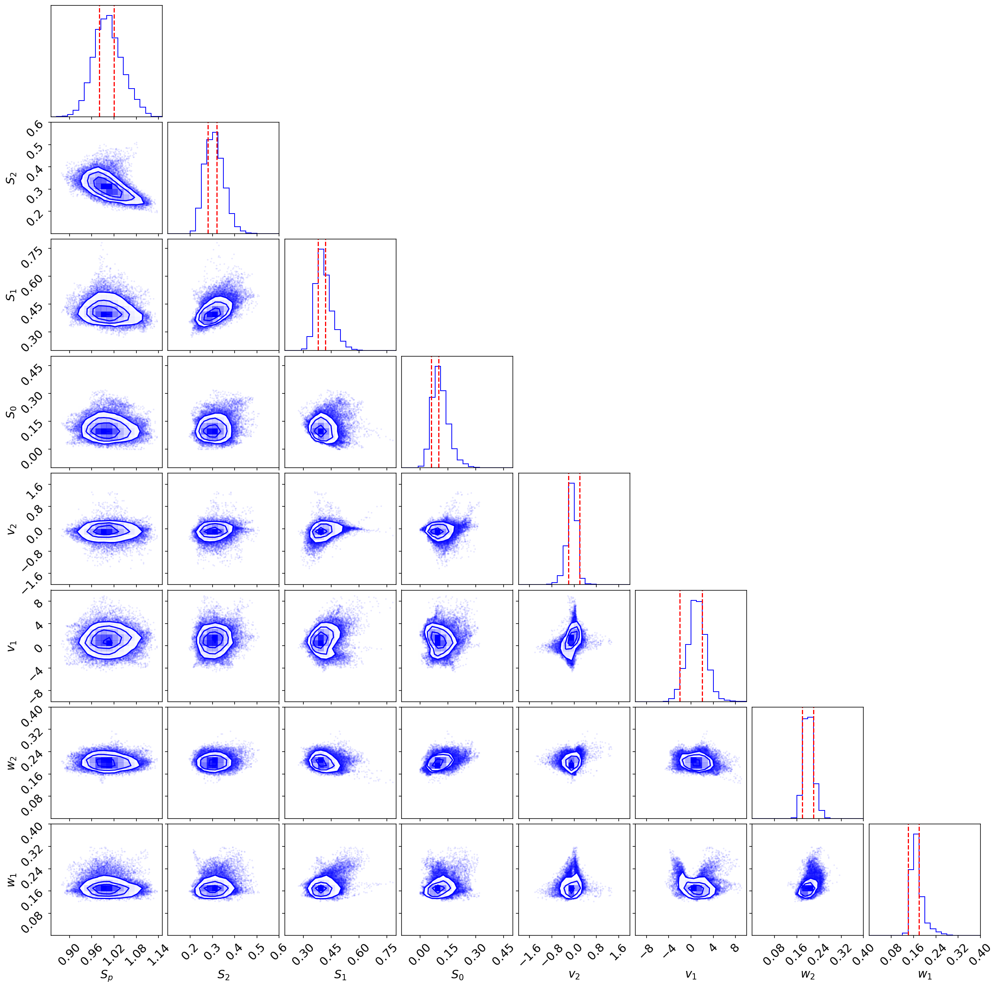

In [148]:
samples = 10**db.parCa[4,:,:].reshape(-1,1)
samples = np.append(samples, 10**db.parCa[5,:,:].reshape(-1,1), axis=1)
samples = np.append(samples, 10**db.parCa[12,:,:].reshape(-1,1), axis=1)
samples = np.append(samples, 10**db.parCa[13,:,:].reshape(-1,1), axis=1)

samples = np.append(samples, db.parCa[8,:,:].reshape(-1,1), axis=1)
samples = np.append(samples, db.parCa[9,:,:].reshape(-1,1), axis=1)
samples = np.append(samples, 10**db.parCa[10,:,:].reshape(-1,1), axis=1)
samples = np.append(samples, 10**db.parCa[11,:,:].reshape(-1,1), axis=1)
print(samples.__array_interface__)

ranges = [(0.85,1.15), (0.1,0.6), (0.2,0.8), (-0.1,0.5), (-2,2), (-10,10), (0,0.4), (0,0.4)]
labels = [r'$S_p$', r'$S_2$', r'$S_1$', r'$S_0$', r'$v_2$', r'$v_1$', r'$w_2$', r'$w_1$']
pars_supr = [1.02, 0.32, 0.42, 0.10,  0.2,  2, 0.22, 0.18]
pars_infm = [0.98, 0.28, 0.38, 0.06, -0.2, -2, 0.18, 0.14]

fig = corner.corner(samples, range=ranges, labels=labels, color='blue')

ndim = 8
axes = np.array(fig.axes).reshape((ndim, ndim))
for i in range(ndim):
    ax = axes[i, i]
    ax.axvline(pars_supr[i], color="r", linestyle='--')
    ax.axvline(pars_infm[i], color="r", linestyle='--')

## Parameter geometry

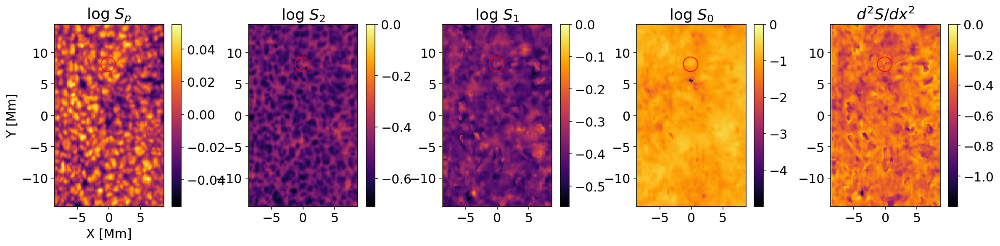

In [72]:
nx = np.shape(db.parCa)[-1]
ny = np.shape(db.parCa)[-2]
extent = np.array([-nx/2., nx/2., -ny/2., ny/2.])*0.16*0.725 # Mm

# position of the Bright Grain
pos_BG = [74,195]
pos_BG[0] = (2*pos_BG[0]/nx - 1) * extent[1]
pos_BG[1] = (2*pos_BG[1]/ny - 1) * extent[3]

fig, ax = plt.subplots(1, 5, figsize=(20,4))

# parameters map
params = [r'$\log\ S_p$', r'$\log\ S_2$', r'$\log\ S_1$', r'$\log\ S_0$', r'$d^2S/dx^2$']
number = [4,5,12,13,-1]

for i, par, num in zip(range(5), params, number):
    if num is -1:
        data = 10**db.parCa[5] - 2*10**db.parCa[12] + 10**db.parCa[13]
        im = ax[i].imshow(data, origin='lower', cmap='inferno', interpolation='nearest', extent=extent)
    else:
        im = ax[i].imshow(db.parCa[num], origin='lower', cmap='inferno', interpolation='nearest', extent=extent)
    fig.colorbar(im, ax=ax[i], shrink=1)
    ax[i].scatter(pos_BG[0],pos_BG[1], s=300, facecolor='none', edgecolor='r')
    ax[i].set_title(par)
    

# figure layout
ax[0].set_xlabel('X [Mm]')
ax[0].set_ylabel('Y [Mm]')

#plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

# Ca II Bright Grains
---

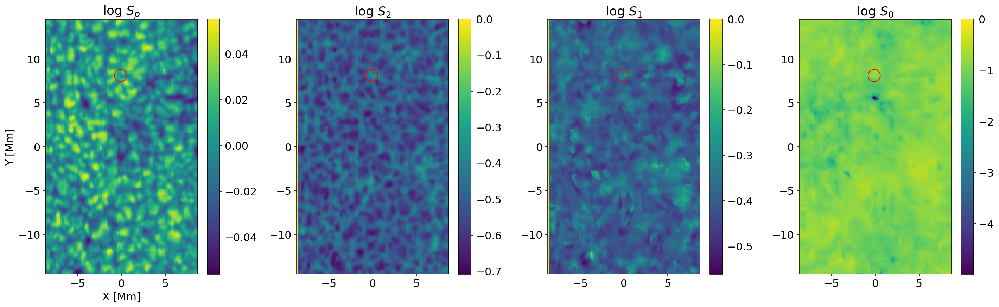

In [30]:
nx = np.shape(db.parCa)[-1]
ny = np.shape(db.parCa)[-2]
extent = np.array([-nx/2., nx/2., -ny/2., ny/2.])*0.16*0.725 # Mm

# position of the Bright Grain
pos_BG = [74,195]
pos_BG[0] = (2*pos_BG[0]/nx - 1) * extent[1]
pos_BG[1] = (2*pos_BG[1]/ny - 1) * extent[3]

fig, ax = plt.subplots(1, 4, figsize=(20,7))

# parameters map
params = [r'$\log\ S_p$', r'$\log\ S_2$', r'$\log\ S_1$', r'$\log\ S_0$']
number = [4,5,12,13]

for i, par, num in zip(range(4), params, number):
    im = ax[i].imshow(db.parCa[num], origin='lower', cmap='viridis', interpolation='nearest', extent=extent)
    fig.colorbar(im, ax=ax[i], shrink=0.79)
    ax[i].scatter(pos_BG[0],pos_BG[1], s=300, facecolor='none', edgecolor='r')
    ax[i].set_title(par)
    

# figure layout
ax[0].set_xlabel('X [Mm]')
ax[0].set_ylabel('Y [Mm]')

plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

In [134]:
# Calculation Time depending on epsabs/epsrel
epsabss = [1e3, 3e1, 1e0, 3e-2, 1e-3, 3e-5, 1e-6, 1.49e-8]
caltime = []
fr1, fr2, fr3 = [], [], []
err1, err2, err3 = [], [], []

for epsabs in epsabss:
    t1 = time()
    fr,err = flux_calculator(db.parCa[:,195,74], line='Ca', epsabs=epsabs)
    t2 = time()
    caltime.append(t2-t1)
    fr1.append(fr[0] + fr[1] + fr[2])
    fr2.append(-fr[3] + fr[4] + fr[5])
    fr3.append(-fr[6] - fr[7] + fr[8])
    err1.append((err[0]**2 + err[1]**2 + err[2]**2)**0.5)
    err2.append((err[3]**2 + err[4]**2 + err[5]**2)**0.5)
    err3.append((err[6]**2 + err[7]**2 + err[8]**2)**0.5)

fr1, fr2, fr3 = np.array(fr1)/1e3, np.array(fr2)/1e3, np.array(fr3)/1e3

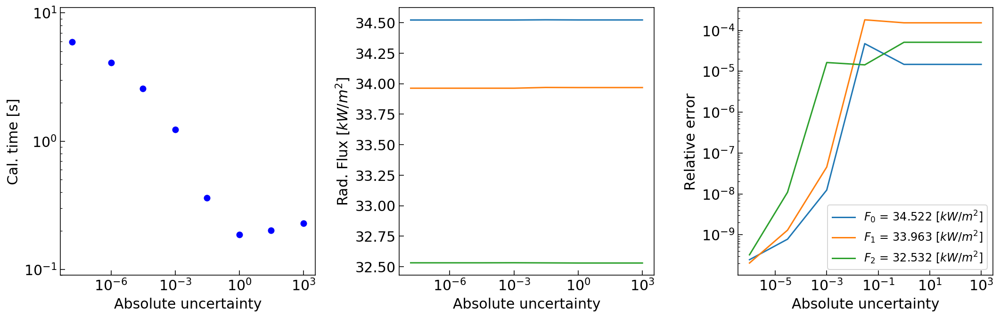

In [135]:
fig, ax = plt.subplots(1,3, figsize=(15,5))

ax[0].loglog(epsabss, caltime, 'bo')
ax[0].set_ylim(0.9e-1,1.1e1)
ax[0].set_xlabel('Absolute uncertainty')
ax[0].set_ylabel('Cal. time [s]')
ax[0].tick_params(which='both', direction='in')
ax[0].tick_params(which='major', length=5)

ax[1].semilogx(epsabss, fr1)
ax[1].semilogx(epsabss, fr2)
ax[1].semilogx(epsabss, fr3)
ax[1].set_ylim()
ax[1].set_xlabel('Absolute uncertainty')
ax[1].set_ylabel(r'Rad. Flux [$kW/m^2$]')
ax[1].tick_params(which='both', direction='in')
ax[1].tick_params(which='major', length=5)

ax[2].loglog(epsabss[:-1], abs(fr1/fr1[-1]-1)[:-1], label=rf'$F_0$ = {fr1[-1]:.3f} $[kW/m^2]$')
ax[2].loglog(epsabss[:-1], abs(fr2/fr2[-1]-1)[:-1], label=rf'$F_1$ = {fr2[-1]:.3f} $[kW/m^2]$')
ax[2].loglog(epsabss[:-1], abs(fr3/fr3[-1]-1)[:-1], label=rf'$F_2$ = {fr3[-1]:.3f} $[kW/m^2]$')
ax[2].set_xlabel('Absolute uncertainty')
ax[2].set_ylabel('Relative error')
ax[2].legend()
ax[2].tick_params(which='both', direction='in')
ax[2].tick_params(which='major', length=5)

plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

In [136]:
# Calculation Time depending on epsabs/epsrel
epsrels = [5e-1, 1e-2, 1e-3, 1e-4, 1e-5, 1e-6, 1e-7, 1.49e-8]
caltime = []
fr4, fr5, fr6 = [], [], []
err4, err5, err6 = [], [], []

for epsabs in epsabss:
    t1 = time()
    fr,err = flux_calculator(db.parCa[:,195,74], line='Ca', epsabs=epsabs)
    t2 = time()
    caltime.append(t2-t1)
    fr4.append(fr[0] + fr[1] + fr[2])
    fr5.append(-fr[3] + fr[4] + fr[5])
    fr6.append(-fr[6] - fr[7] + fr[8])
    err4.append((err[0]**2 + err[1]**2 + err[2]**2)**0.5)
    err5.append((err[3]**2 + err[4]**2 + err[5]**2)**0.5)
    err6.append((err[6]**2 + err[7]**2 + err[8]**2)**0.5)

fr4, fr5, fr6 = np.array(fr4)/1e3, np.array(fr5)/1e3, np.array(fr6)/1e3

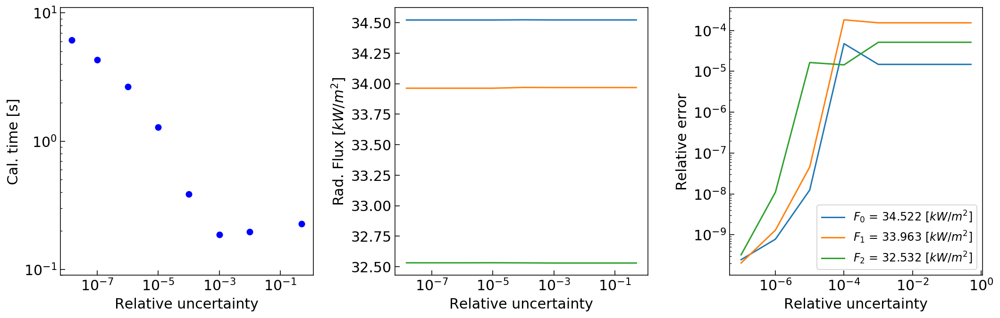

In [137]:
fig, ax = plt.subplots(1,3, figsize=(15,5))

ax[0].loglog(epsrels, caltime, 'bo')
ax[0].set_ylim(0.9e-1,1.1e1)
ax[0].set_xlabel('Relative uncertainty')
ax[0].set_ylabel('Cal. time [s]')
ax[0].tick_params(which='both', direction='in')
ax[0].tick_params(which='major', length=5)

ax[1].semilogx(epsrels, fr4)
ax[1].semilogx(epsrels, fr5)
ax[1].semilogx(epsrels, fr6)
ax[1].set_ylim()
ax[1].set_xlabel('Relative uncertainty')
ax[1].set_ylabel(r'Rad. Flux [$kW/m^2$]')
ax[1].tick_params(which='both', direction='in')
ax[1].tick_params(which='major', length=5)

ax[2].loglog(epsrels[:-1], abs(fr4/fr4[-1]-1)[:-1], label=rf'$F_0$ = {fr1[-1]:.3f} $[kW/m^2]$')
ax[2].loglog(epsrels[:-1], abs(fr5/fr5[-1]-1)[:-1], label=rf'$F_1$ = {fr2[-1]:.3f} $[kW/m^2]$')
ax[2].loglog(epsrels[:-1], abs(fr6/fr6[-1]-1)[:-1], label=rf'$F_2$ = {fr3[-1]:.3f} $[kW/m^2]$')
ax[2].set_xlabel('Relative uncertainty')
ax[2].set_ylabel('Relative error')
ax[2].legend()
ax[2].tick_params(which='both', direction='in')
ax[2].tick_params(which='major', length=5)

plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

In [10]:
# Single Point Calculation from Calculator ver.2 with considering width of each layers
t1 = time()
fr = flux_calculator2(db.parCa[:,195,74], line='Ca')
t2 = time()
print(f'Time for one point = {(t2-t1):.2e} [sec]\n')

print(f'Radiative Flux matrix \n{fr.reshape((3,3))}\n')

print(f'F_0 = {(fr[0] + fr[1] + fr[2]):.3e} [W/m^2]')
print(f'F_1 = {(fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_2 = {(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]\n')

print(f'F_0 - F_2 = {(fr[0] + fr[1] + fr[2])-(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]')
print(f'F_0 - F_1 = {(fr[0] + fr[1] + fr[2])-(fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_1 - F_2 = {(fr[3] + fr[4] + fr[5])-(fr[6] + fr[7] + fr[8]):.3e} [W/m^2]')

Time for one point = 2.04e-03 [sec]

Radiative Flux matrix 
[[  740.9598204   1476.63683334 34661.66818813]
 [-1157.95873719  3057.44293712 34689.29480619]
 [  -59.02995064 -2931.78943667 35537.40947666]]

F_0 = 3.688e+04 [W/m^2]
F_1 = 3.659e+04 [W/m^2]
F_2 = 3.255e+04 [W/m^2]

F_0 - F_2 = 4.333e+03 [W/m^2]
F_0 - F_1 = 2.905e+02 [W/m^2]
F_1 - F_2 = 4.042e+03 [W/m^2]


In [179]:
# Single Point Calculation from Calculator ver.2 without considering width of each layers
t1 = time()
fr = flux_calculator2(db.parCa[:,195,74], line='Ca')
t2 = time()
print(f'Time for one point = {(t2-t1):.2e} [sec]\n')

print(f'Radiative Flux matrix \n{fr.reshape((3,3))}\n')

print(f'F_0 = {(fr[0] + fr[1] + fr[2]):.3e} [W/m^2]')
print(f'F_1 = {(-fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_2 = {(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]\n')

print(f'F_0 - F_2 = {(fr[0] + fr[1] + fr[2])-(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]')
print(f'F_0 - F_1 = {(fr[0] + fr[1] + fr[2])-(-fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_1 - F_2 = {(-fr[3] + fr[4] + fr[5])-(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]')

Time for one point = 1.43e-03 [sec]

Radiative Flux matrix 
[[  740.9598204   1476.63683334 34662.62194858]
 [ 1157.95873718  3057.44293274 34689.29363218]
 [   59.02995064  2931.78943259 35537.4094767 ]]

F_0 = 3.688e+04 [W/m^2]
F_1 = 3.659e+04 [W/m^2]
F_2 = 3.255e+04 [W/m^2]

F_0 - F_2 = 4.334e+03 [W/m^2]
F_0 - F_1 = 2.914e+02 [W/m^2]
F_1 - F_2 = 4.042e+03 [W/m^2]


In [182]:
# Single Point Calculation from Calculator ver.2 with less wavelength range without considering width of each layers
t1 = time()
fr = flux_calculator2(db.parCa[:,195,74], line='Ca')
t2 = time()
print(f'Time for one point = {(t2-t1):.2e} [sec]\n')

print(f'Radiative Flux matrix \n{fr.reshape((3,3))}\n')

print(f'F_0 = {(fr[0] + fr[1] + fr[2]):.3e} [W/m^2]')
print(f'F_1 = {(-fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_2 = {(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]\n')

print(f'F_0 - F_2 = {(fr[0] + fr[1] + fr[2])-(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]')
print(f'F_0 - F_1 = {(fr[0] + fr[1] + fr[2])-(-fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_1 - F_2 = {(-fr[3] + fr[4] + fr[5])-(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]')

Time for one point = 1.09e-03 [sec]

Radiative Flux matrix 
[[  740.9598204   1456.62150567 17316.6703196 ]
 [ 1157.95873718  3037.42760647 17344.29693496]
 [   59.02995064  2911.77475134 18186.86537277]]

F_0 = 1.951e+04 [W/m^2]
F_1 = 1.922e+04 [W/m^2]
F_2 = 1.522e+04 [W/m^2]

F_0 - F_2 = 4.298e+03 [W/m^2]
F_0 - F_1 = 2.905e+02 [W/m^2]
F_1 - F_2 = 4.008e+03 [W/m^2]


In [185]:
# Single Point Calculation from Calculator ver.2 without considering width of each layers, changing larger order of Gaussian quadrature
t1 = time()
fr = flux_calculator2(db.parCa[:,195,74], line='Ca')
t2 = time()
print(f'Time for one point = {(t2-t1):.2e} [sec]\n')

print(f'Radiative Flux matrix \n{fr.reshape((3,3))}\n')

print(f'F_0 = {(fr[0] + fr[1] + fr[2]):.3e} [W/m^2]')
print(f'F_1 = {(-fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_2 = {(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]\n')

print(f'F_0 - F_2 = {(fr[0] + fr[1] + fr[2])-(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]')
print(f'F_0 - F_1 = {(fr[0] + fr[1] + fr[2])-(-fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_1 - F_2 = {(-fr[3] + fr[4] + fr[5])-(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]')

Time for one point = 1.77e-03 [sec]

Radiative Flux matrix 
[[  741.44591851  1476.642005   34669.48210421]
 [ 1159.47059835  3059.72136322 34697.20409512]
 [   59.03006943  2933.7806378  35548.31902308]]

F_0 = 3.689e+04 [W/m^2]
F_1 = 3.660e+04 [W/m^2]
F_2 = 3.256e+04 [W/m^2]

F_0 - F_2 = 4.332e+03 [W/m^2]
F_0 - F_1 = 2.901e+02 [W/m^2]
F_1 - F_2 = 4.042e+03 [W/m^2]


In [188]:
# Single Point Calculation from Calculator ver.2 without considering width of each layers, changing much smaller epsrel of kernel
t1 = time()
fr = flux_calculator2(db.parCa[:,195,74], line='Ca')
t2 = time()
print(f'Time for one point = {(t2-t1):.2e} [sec]\n')

print(f'Radiative Flux matrix \n{fr.reshape((3,3))}\n')

print(f'F_0 = {(fr[0] + fr[1] + fr[2]):.3e} [W/m^2]')
print(f'F_1 = {(-fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_2 = {(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]\n')

print(f'F_0 - F_2 = {(fr[0] + fr[1] + fr[2])-(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]')
print(f'F_0 - F_1 = {(fr[0] + fr[1] + fr[2])-(-fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_1 - F_2 = {(-fr[3] + fr[4] + fr[5])-(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]')

Time for one point = 1.09e-03 [sec]

Radiative Flux matrix 
[[  740.9598204   1476.63683334 34661.66818813]
 [ 1157.95873719  3057.44293712 34689.29480619]
 [   59.02995064  2931.78943667 35537.40947666]]

F_0 = 3.688e+04 [W/m^2]
F_1 = 3.659e+04 [W/m^2]
F_2 = 3.255e+04 [W/m^2]

F_0 - F_2 = 4.333e+03 [W/m^2]
F_0 - F_1 = 2.905e+02 [W/m^2]
F_1 - F_2 = 4.042e+03 [W/m^2]


In [192]:
# modified kernel module
def gen_kernel(line='Ha'):
    x = np.linspace(0,1, 101)
    kernel = []
    
    # [v] = km/s, [w] = nm, [a]&[eta]&[tau] = None
    a1 = 0.0
    a2 = 0.3
    tau = 5.0
    c = 3e5 # km/s
    
    # different parameters of given line
    if line == 'Ha':
        ap = 10**1.1
        eta = 10**0.51
        int_bin = [-80,80] # integration range [dimensionless] 
        
    elif line == 'Ca':
        ap = 10**1.32
        eta = 10**0.43
        int_bin = [-120,120] # integration range [dimensionless]
        
    else:
        raise NameErorr('Wrong line inputting.')

    h1 = lambda y: tau * wofz(y-0.08196 + a1*1j).real / wofz(a1*1j).real
    h2 = lambda y: tau * wofz(y-0.01623 + a2*1j).real / wofz(a2*1j).real
    hp = lambda y: eta * wofz(y-0.06680 + ap*1j).real / wofz(ap*1j).real + 1
    
    for i in range(3):
        for j in range(3):
            ker = np.zeros(len(x))
            for k, xx in enumerate(x):
                if j==0:
                    if i==0:   f = lambda y: e2(xx*h1(y)            ) * h1(y)
                    elif i==1: f = lambda y: e2((1-xx)*h1(y)        ) * h1(y)
                    elif i==2: f = lambda y: e2((1-xx)*h1(y) + h2(y)) * h1(y)
                elif j==1:
                    if i==0:   f = lambda y: e2(h1(y) + xx*h2(y)) * h2(y)
                    elif i==1: f = lambda y: e2(        xx*h2(y)) * h2(y)
                    elif i==2: f = lambda y: e2(    (1-xx)*h2(y)) * h2(y)
                elif j==2:
                    if i==0:   f = lambda y: e2(h1(y) + h2(y) + xx*hp(y)) * hp(y)
                    elif i==1: f = lambda y: e2(        h2(y) + xx*hp(y)) * hp(y)
                    elif i==2: f = lambda y: e2(                xx*hp(y)) * hp(y)
                ker[k] = integrate.quad(f, int_bin[0],int_bin[1], epsrel=1e-3)[0]
            kernel.append(interpolate.interp1d(x, ker, kind='linear', fill_value='extrapolate'))
    
    return kernel

# Obtain kernel for the Ca II line
t1 = time()
KERNEL = gen_kernel(line='Ca')
t2 = time()
print(f'Time for obtaining one kernel = {(t2-t1):.2e} [sec]\n')
if KERNEL is not None:
    print('Kernel is all set!')

Time for obtaining one kernel = 2.86e+00 [sec]

Kernel is all set!


In [194]:
# Single Point Calculation from Calculator ver.2 with considering velocity of each layers 
t1 = time()
fr = flux_calculator2(db.parCa[:,195,74], line='Ca')
t2 = time()
print(f'Time for one point = {(t2-t1):.2e} [sec]\n')

print(f'Radiative Flux matrix \n{fr.reshape((3,3))}\n')

print(f'F_0 = {(fr[0] + fr[1] + fr[2]):.3e} [W/m^2]')
print(f'F_1 = {(-fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_2 = {(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]\n')

print(f'F_0 - F_2 = {(fr[0] + fr[1] + fr[2])-(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]')
print(f'F_0 - F_1 = {(fr[0] + fr[1] + fr[2])-(-fr[3] + fr[4] + fr[5]):.3e} [W/m^2]')
print(f'F_1 - F_2 = {(-fr[3] + fr[4] + fr[5])-(-fr[6] - fr[7] + fr[8]):.3e} [W/m^2]')

Time for one point = 1.57e-03 [sec]

Radiative Flux matrix 
[[  740.95982057  1477.5758048  34662.0285289 ]
 [ 1157.95873763  3057.44292906 34690.35356278]
 [   59.63399334  2931.78942906 35537.40928538]]

F_0 = 3.688e+04 [W/m^2]
F_1 = 3.659e+04 [W/m^2]
F_2 = 3.255e+04 [W/m^2]

F_0 - F_2 = 4.335e+03 [W/m^2]
F_0 - F_1 = 2.907e+02 [W/m^2]
F_1 - F_2 = 4.044e+03 [W/m^2]


In [147]:
# Boxed Area Calculation
FRR = np.zeros((30,30,9))
ERR = np.zeros((30,30,9))

t1 = time()
for i in range(30):
    if i%2 == 0: print(i)
    for j in range(30):
        FRR[i,j], ERR[i,j] = flux_calculator(db.parCa[:,195-15+i,74-15+j])
t2 = time()
print(f'Time for calculation = {(t2-t1):.3e} [sec] = {(t2-t1)/60:.1f} [min]')
print(f'Time for one point = {(t2-t1)/900:.3f} [sec]')

0
2
4
6
8
10
12
14
16
18
20
22
24
26
28
Time for calculation = 1.465e+03 [sec] = 24.4 [min]


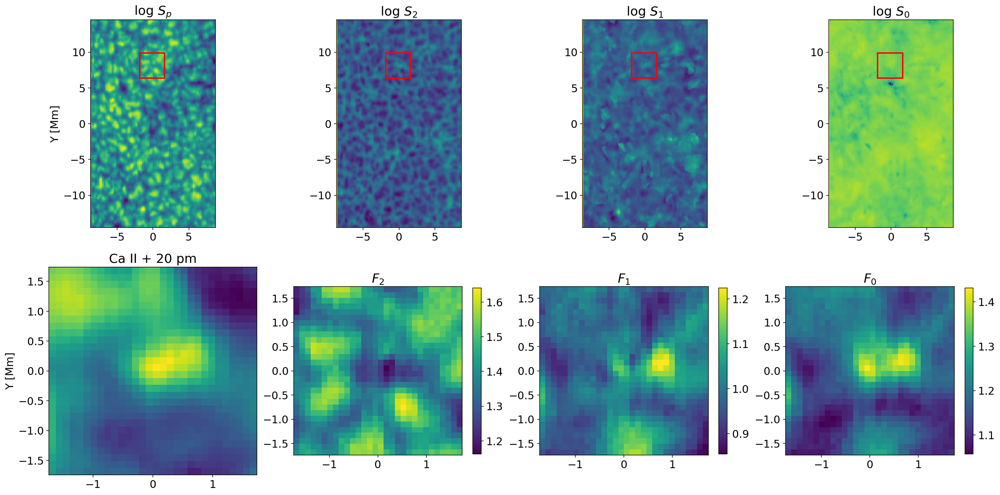

In [189]:
import matplotlib.patches as patches

nx = np.shape(db.parCa)[-1]
ny = np.shape(db.parCa)[-2]
nb = 30
extent1 = np.array([-nx/2., nx/2., -ny/2., ny/2.])*0.16*0.725
extent2 = np.array([-nb/2, nb/2, -nb/2, nb/2])*0.16*0.725

# position of the flux-calculated region
pos_fr = np.array([74-nx/2,195-ny/2]) * 0.16 * 0.725 
wid_fr = nb * 0.16 * 0.725

fig, ax = plt.subplots(2, 4, figsize=(20,10))

# parameter map
params = [r'$\log\ S_p$', r'$\log\ S_2$', r'$\log\ S_1$', r'$\log\ S_0$']
number = [4,5,12,13]

for i, par, num in zip(range(4), params, number):
    ax[0,i].imshow(db.parCa[num], origin='lower', interpolation='nearest', extent=extent1)
    ax[0,i].set_title(par)
    ax[0,i].add_patch(patches.Rectangle(pos_fr-wid_fr/2, wid_fr,wid_fr, color='r', fill=False, lw=2))

# flux map
titles = [r'Ca II + 20 pm', r'$F_2$', r'$F_1$', r'$F_0$']
raster = db.fissCa.getRaster(0.2, hw=0.05)[195-15:195+15,74-15:74+15]
flux2 = -FRRs[:,:,6]-FRRs[:,:,7]+FRRs[:,:,8]
flux1 = -FRRs[:,:,3]+FRRs[:,:,4]+FRRs[:,:,5]
flux0 = FRRs[:,:,0]+FRRs[:,:,1]+FRRs[:,:,2]
fluxes = [np.log10(raster), flux2, flux1, flux0]

for i, title, flux in zip(range(4), titles, fluxes):
    im = ax[1,i].imshow(flux, origin='lower', interpolation='nearest', extent=extent2)
    if i != 0:
        fig.colorbar(im, ax=ax[1,i], shrink=0.8)
    ax[1,i].set_title(title)

    
# figure layout
ax[0,0].set_ylabel('Y [Mm]')
ax[1,0].set_ylabel('Y [Mm]')

plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

In [179]:
print(flux0[15,15]-flux1[15,15], flux1[15,15]-flux2[15,15])

0.30937239718827936 -0.146791471860499


In [1]:
import matplotlib.colors as colors
import matplotlib.patches as patches

nx = np.shape(db.parCa)[-1]
ny = np.shape(db.parCa)[-2]
nb = 30
extent1 = np.array([-nx/2., nx/2., -ny/2., ny/2.])*0.16*0.725
extent2 = np.array([-nb/2, nb/2, -nb/2, nb/2])*0.16*0.725

# position of the flux-calculated region
pos_fr = np.array([74-nx/2,195-ny/2]) * 0.16 * 0.725 
wid_fr = nb * 0.16 * 0.725

fig, ax = plt.subplots(1,2, figsize=(10,5))

# flux map
titles = [r'$F_1 - F_2$', r'$F_0 - F_1$']

flux2 = -FRRs[:,:,6]-FRRs[:,:,7]+FRRs[:,:,8]
flux1 = -FRRs[:,:,3]+FRRs[:,:,4]+FRRs[:,:,5]
flux0 = FRRs[:,:,0]+FRRs[:,:,1]+FRRs[:,:,2]
fluxes = [flux1-flux2, flux0-flux1]

for i, title, flux in zip(range(2), titles, fluxes):
    ax[i].imshow(flux, origin='lower', interpolation='nearest', extent=extent2, cmap='bwr')
    #ax[i].imshow(flux, origin='lower', interpolation='nearest', extent=extent2, cmap='bwr', norm=colors.Normalize(vmin=-0.5, vmax=0.5))
    ax[i].set_title(title)

    
# figure layout
ax[0].set_ylabel('Y [Mm]')
ax[0].set_xlabel('X [Mm]')

plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

NameError: name 'np' is not defined

In [182]:
print(fluxes[0][15,15], fluxes[1][15,15])

-0.146791471860499 0.30937239718827936


# Pearson correlation coefficient
---

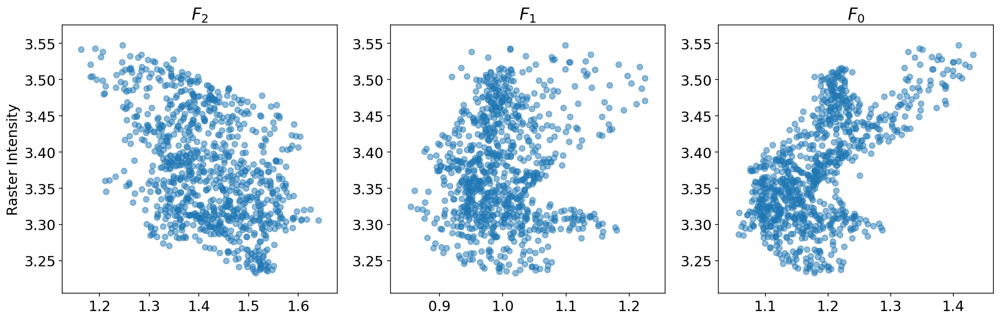

In [171]:
fig, ax = plt.subplots(1,3, figsize=(15,5))

titles = [r'$F_2$', r'$F_1$', r'$F_0$']
fluxes = [flux2, flux1, flux0]

for i, flux, title in zip(range(3), fluxes, titles):
    ax[i].scatter(flux,np.log10(raster), alpha=0.5)
    ax[i].set_title(title)

ax[0].set_ylabel(r'Raster Intensity')

plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

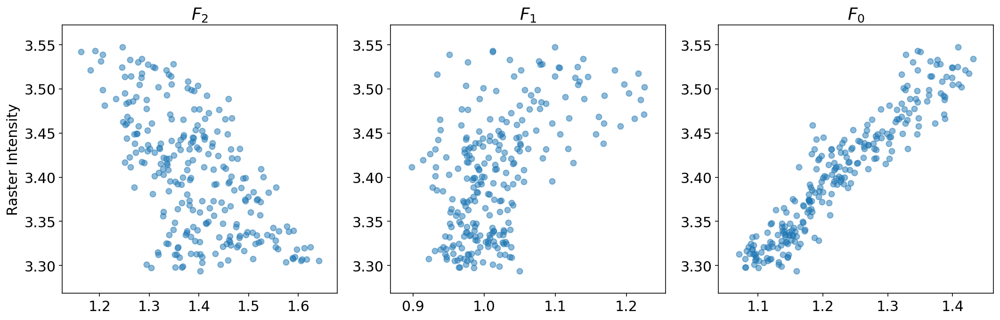

In [172]:
fig, ax = plt.subplots(1,3, figsize=(15,5))

titles = [r'$F_2$', r'$F_1$', r'$F_0$']
fluxes = [flux2, flux1, flux0]

for i, flux, title in zip(range(3), fluxes, titles):
    ax[i].scatter(flux[7:23,7:23],np.log10(raster)[7:23,7:23], alpha=0.5)
    ax[i].set_title(title)

ax[0].set_ylabel(r'Raster Intensity')

plt.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=500)
plt.show()

In [3]:
tau = 5.0

# [S] = 
S0 = 0.24
S1 = 0.47
S2 = 0.37
Sp = 1.05

s1 = lambda x: S0 + (-3*S0+4*S1-S2)/2 * x + (S0-2*S1+S2)/2 * x**2
s2 = lambda x: S1 + (-S0+S2)/2 * x + (S0-2*S1+S2)/2 * x**2
s3 = lambda x: S2 + (Sp-S2) * x

# [v] = km/s, [w] = pm
v1 = 0.30
w1 = 16.3
a1 = 0.0
v2 = -0.13
w2 = 20.1
a2 = 0.3
vp = -0.02
wp = 10**0.84
ap = 10**1.10
eta = 10**0.51

def u(wv, v, w, line='Ca'):
    c = 3e5
    if line == 'Ha':
        wv0 = 656.3
    elif line == 'Ca':
        wv0 = 854.2
    else:
        raise NameError('Wrong line.')
    
    return (wv - (1+v/c)*wv0)/w

h1 = lambda y: tau * special.wofz(u(y,v1,w1) + a1*1j).real
h2 = lambda y: tau * special.wofz(u(y,v2,w2) + a2*1j).real
hp = lambda y: 1 + eta * special.wofz(u(y,vp,wp) + ap*1j).real

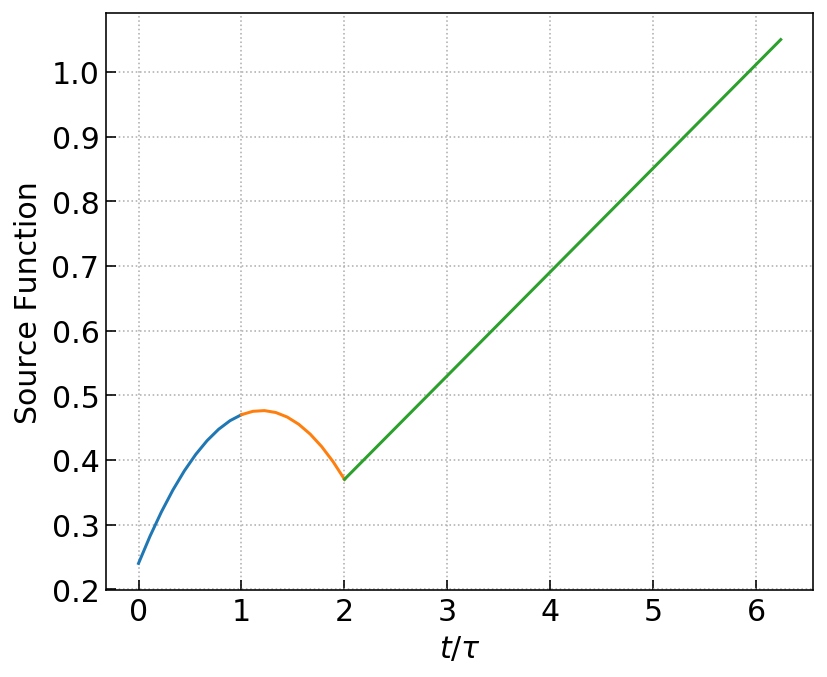

In [4]:
fig = plt.figure(figsize=(6,5))

x = np.linspace(0,1,10)

plt.plot(x,s1(x))
plt.plot(1+x,s2(x))
plt.plot(2+(1+eta)*x,s3(x))

plt.xlabel(r'$t/\tau$')
plt.ylabel(r'Source Function')
plt.tick_params(direction='in', length=5)
plt.grid(ls=':')
#plt.legend()

fig.tight_layout()
#plt.savefig('.pdf', format='pdf', dpi=300)
plt.show()

In [15]:
def f00(x,y):
    return s1(x) * e2(x*h1(y)) * h1(y)
def f01(x,y):
    return s2(x) * e2(h1(y) + x*h2(y)) * h2(y)
def f02(x,y):
    return s3(x) * e2(h1(y) + h2(y) + x*hp(y)) * hp(y)

def f10(x,y):
    return s1(x) * e2((1-x)*h1(y)) * h1(y)
def f11(x,y):
    return s2(x) * e2(x*h2(y)) * h2(y)
def f12(x,y):
    return s3(x) * e2(h2(y) + x*hp(y)) * hp(y)

def f20(x,y):
    return s1(x) * e2((1-x)*h1(y) + h2(y)) * h1(y)
def f21(x,y):
    return s2(x) * e2((1-x)*h2(y)) * h2(y)
def f22(x,y):
    return s3(x) * e2(x*hp(y)) * hp(y)

FR = np.zeros((3,3))
ERR = np.zeros((3,3))

bin_Ca = [852.0,856.4]
#bin_Ca = [853.0, 855.4]
#bin_Ca = [853.8, 854.6]

FR[0,0], ERR[0,0] = integrate.nquad(f00, [[0,1],bin_Ca])
FR[0,1], ERR[0,1] = integrate.nquad(f01, [[0,1],bin_Ca])
FR[0,2], ERR[0,2] = integrate.nquad(f02, [[0,np.inf],bin_Ca])

FR[1,0], ERR[1,0] = integrate.nquad(f10, [[0,1],bin_Ca])
FR[1,1], ERR[1,1] = integrate.nquad(f11, [[0,1],bin_Ca])
FR[1,2], ERR[1,2] = integrate.nquad(f12, [[0,np.inf],bin_Ca])

FR[2,0], ERR[2,0] = integrate.nquad(f20, [[0,1],bin_Ca])
FR[2,1], ERR[2,1] = integrate.nquad(f21, [[0,1],bin_Ca])
FR[2,2], ERR[2,2] = integrate.nquad(f22, [[0,np.inf],bin_Ca])

FR = 2*np.pi*FR
ERR = 2*np.pi*ERR

print(FR)
print(ERR)

[[3.94579391e+00 1.15882598e-02 3.97366335e-04]
 [6.27995113e+00 6.45777527e+00 1.00378919e-01]
 [5.06108694e-02 5.56202096e+00 1.05895985e+01]]
[[3.28264232e-11 1.28655528e-16 7.10600525e-11]
 [1.79464786e-11 2.17765070e-12 3.01767505e-09]
 [5.61893525e-16 9.99640551e-12 2.21547555e-08]]


In [16]:
print(FR[0,0] + FR[0,1] + FR[0,2])
print(-FR[1,0] + FR[1,1] + FR[1,2])
print(-FR[2,0] - FR[2,1] + FR[2,2])

3.957779534793982
0.2782030642589934
4.976966648003431
